# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Import Libraries

In [5]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib qt
print ("Libraries Imported!")

Libraries Imported!


# Camera Calibration

In this section, the camera matrix and distortion coefficients are calculated to undistort and warp the images to get the perspectives of the lane lines clearly. The camera calibration is done using the Chessboard images' templates.



## A. Functions

In [2]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    
    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        offset = 150 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)
    else:
        print ("No Corners were found!")
        M = []
        warped = []
    # Return the resulting image and matrix
    return warped, M
print ("Done!")

Done!


## B. Main Code

### 1. Computing Camera Calibration using Chessboard Images (Finding Corners)

Invalid ret: ./camera_cal\calibration1.jpg
Invalid ret: ./camera_cal\calibration4.jpg
Invalid ret: ./camera_cal\calibration5.jpg
Done!


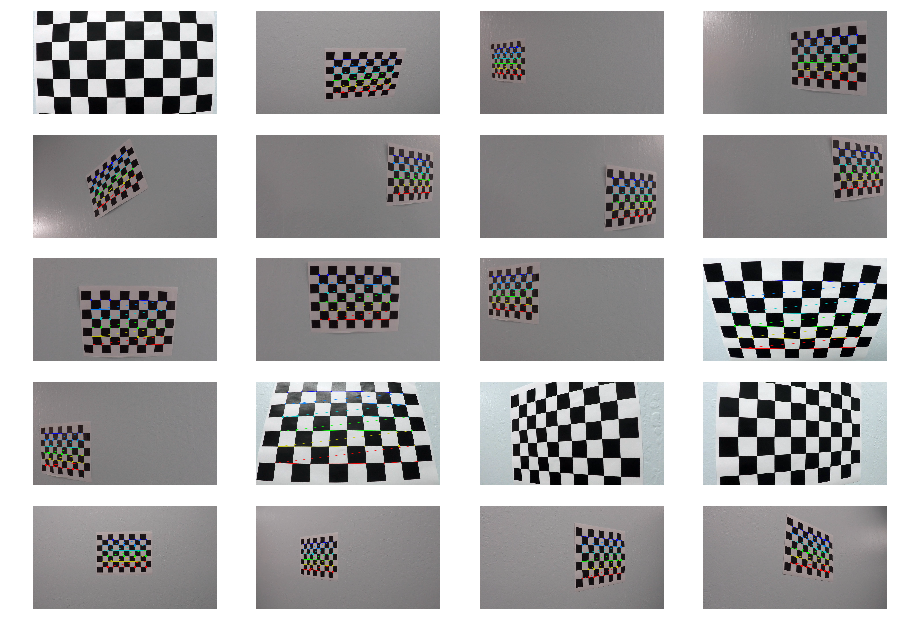

In [6]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
CalibImages = glob.glob('./camera_cal/calibration*.jpg')
fimages = []
fimgs = []
fimgschess = []

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(CalibImages):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    imgchess = img.copy()
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        fimages.append(fname)
        fimgs.append(img)
        
        # Draw and display the corners
        cv2.drawChessboardCorners(imgchess, (nx,ny), corners, ret)
        fimgschess.append(imgchess)
        cv2.waitKey(500)
    else:
        print ("Invalid ret: "+str(fname))
    axs[idx].axis('off')
    axs[idx].imshow(imgchess)
    
cv2.destroyAllWindows()

ret, mtx, dist, _, _ = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
print ("Done!")

Note: The Corners in Images 1,4 and 5 were not fully detected by the findChessboardCorners function, that's why the original image was displayed instead

---

### 2. Undistortion & Perspective Transformation : Chessboard Example

No Corners were found!
Image 10 : Cannot Unwarp!


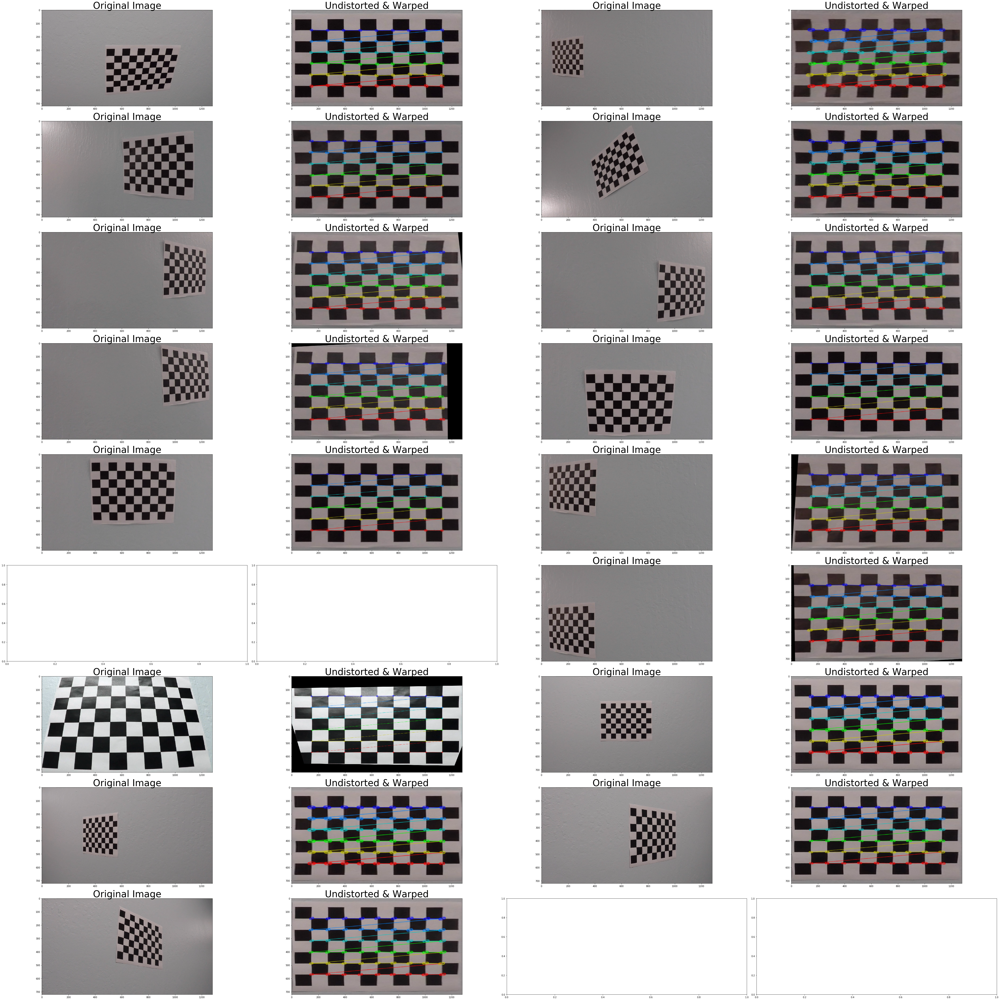

In [4]:
f, axs = plt.subplots(9,4, figsize=(60, 60)) #16, 11
f.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

for i, img in enumerate(fimgs):
    # plt.imshow(img)
    # plt.show()
    top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
    
    if len(top_down)==0:
        print ("Image "+str(i)+" : Cannot Unwarp!")
    else:
        #f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        axs[i*2].imshow(img)
        axs[i*2].set_title('Original Image', fontsize=40)
        axs[(i*2)+1].imshow(top_down)
        axs[(i*2)+1].set_title('Undistorted & Warped', fontsize=40)
        #plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Project Pipelines

## 1. Example of Distorted Road Image

The following parameters are generally used from our Camera Calibration step to undistort Road Images
- mtx  : Camera Matrix
- dist : Distortion Coefficients

In [7]:
# undistort image using the camera calibration matrix calculated above
def undistort(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist
print('Done!')

Done!


Visualize Undistortion:


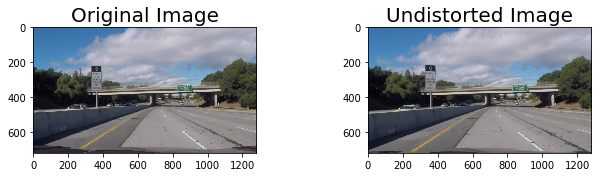

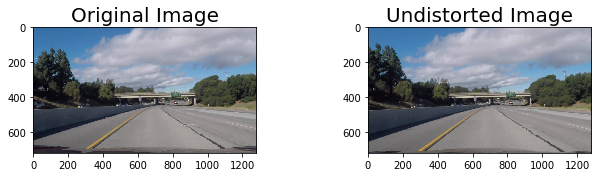

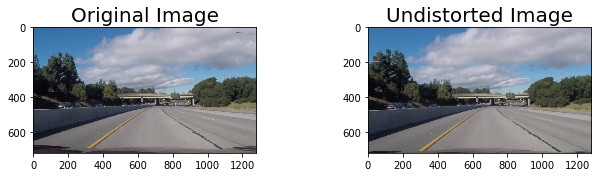

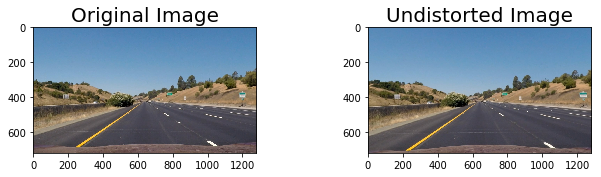

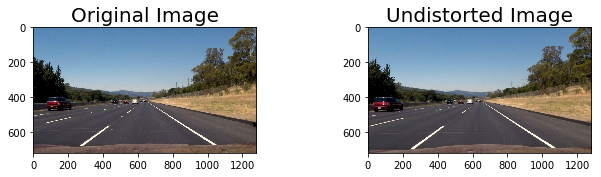

...

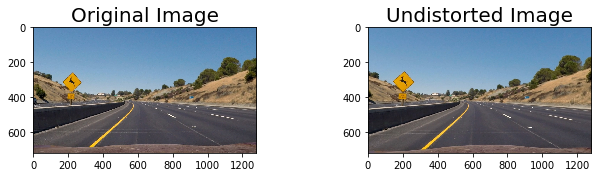

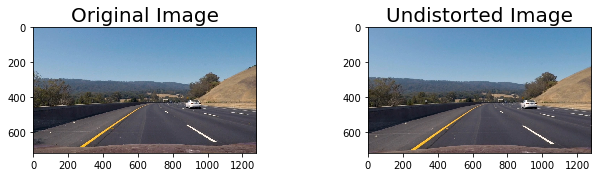

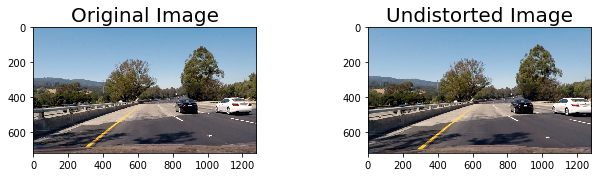

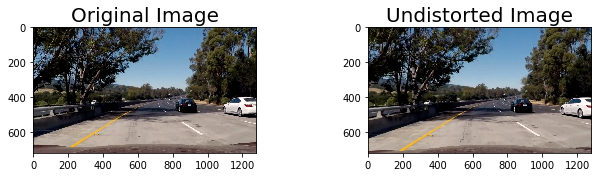

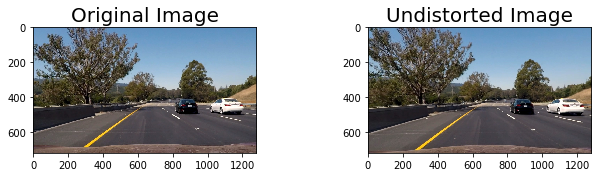

In [8]:
imagesExt = glob.glob('./test_images/*.jpg')
testImgs_undistort = []
print('Visualize Undistortion:')

for imageExt in imagesExt:
    # Choose an image from which to build and demonstrate each step of the pipeline
#     testImg = cv2.imread('./test_images/straight_lines1.jpg')
    testImg = cv2.imread(imageExt)
    testImg = cv2.cvtColor(testImg, cv2.COLOR_BGR2RGB)
    # plt.imshow(testImg)

    testImg_undistort = undistort(testImg)
    testImgs_undistort.append(testImg_undistort)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5)) # (20,10)
    f.subplots_adjust(hspace = .2, wspace=.5) #.2, .05
    ax1.imshow(testImg)
    ax1.set_title('Original Image', fontsize=20) # 30
    ax2.imshow(testImg_undistort)
    ax2.set_title('Undistorted Image', fontsize=20)

## 2. Perspective Transformation of an Undistorted Road Image

The Perspective transformation warps the undistorted Road image to transform it to the top view of the lane lines. The source points in the original image are approximately determined across the given test images and transformed to the Destination points which are formerly determined as well to be produced and saved in the new images (testImgs_unwarp) 1D array

In [9]:
def img_unwarp(img, src, dst):
    height,width = img.shape[:2]
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, (width,height), flags=cv2.INTER_LINEAR)
    return warped, M, Minv
print('Done')

Done


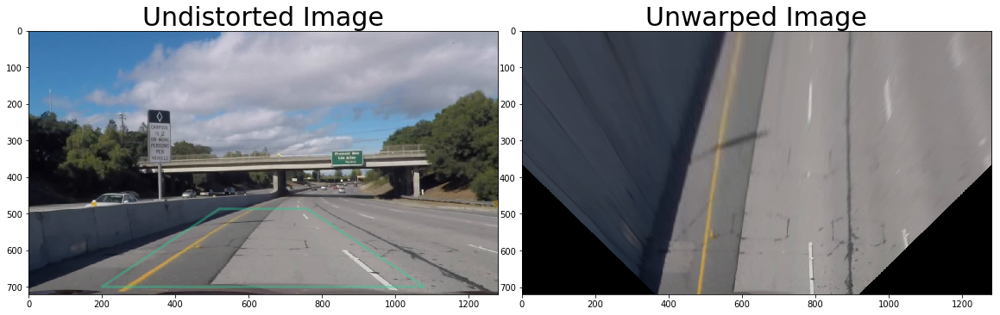

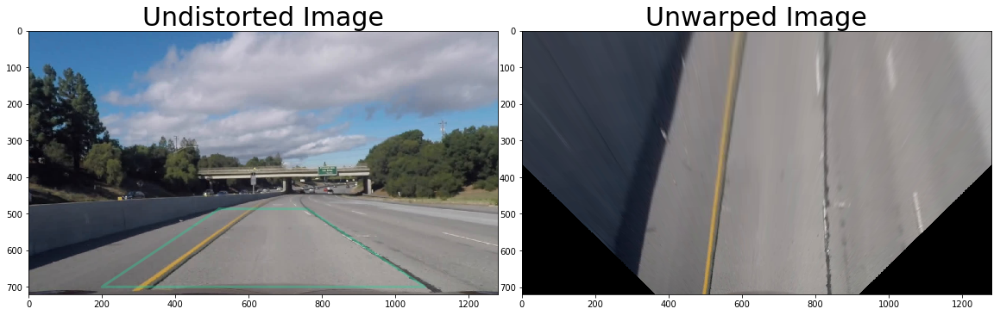

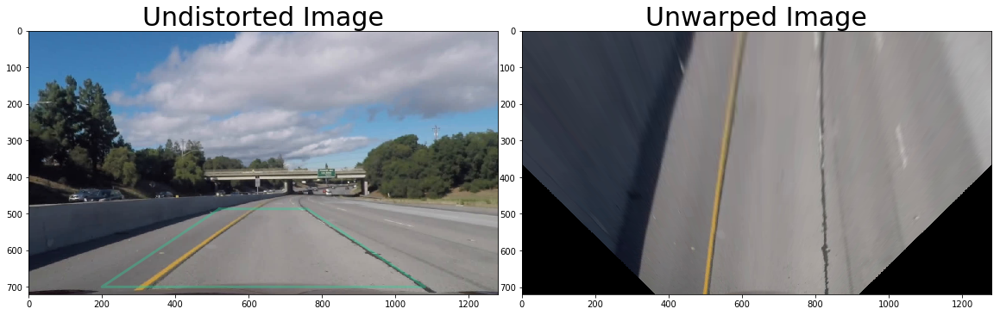

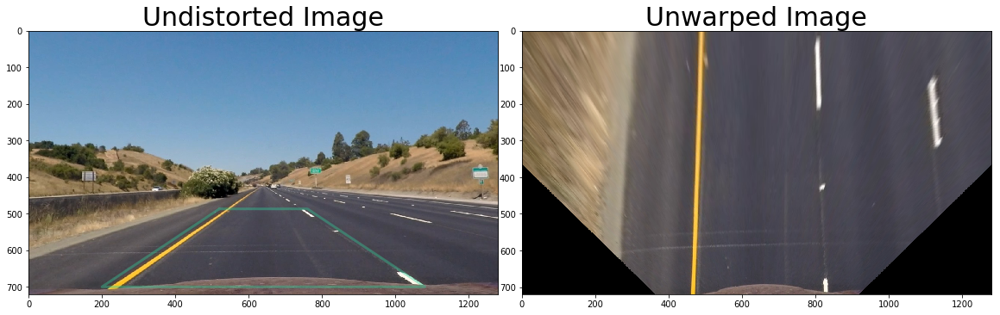

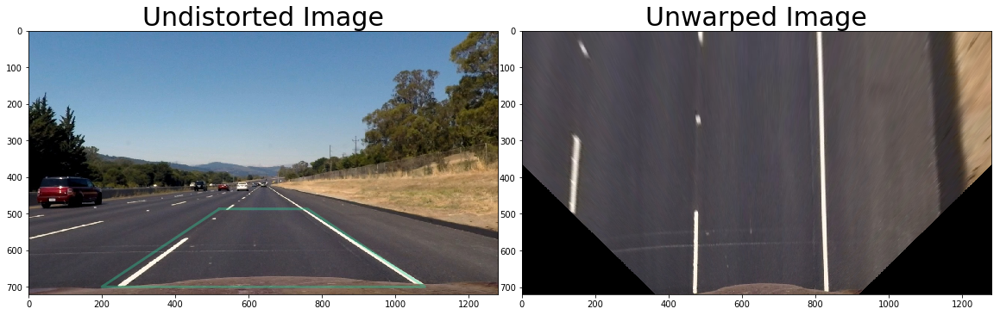

...

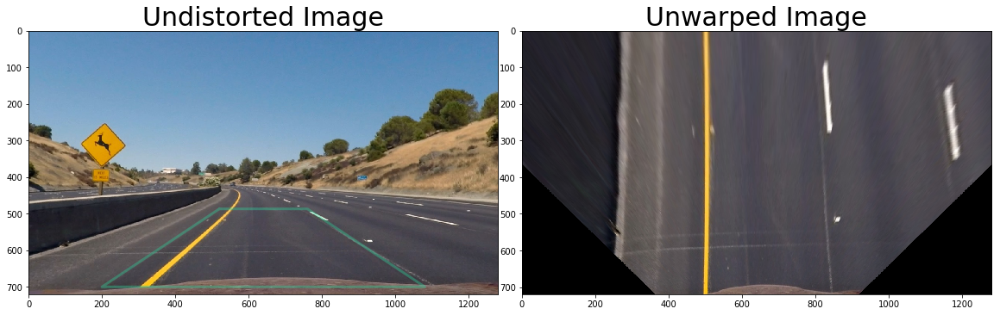

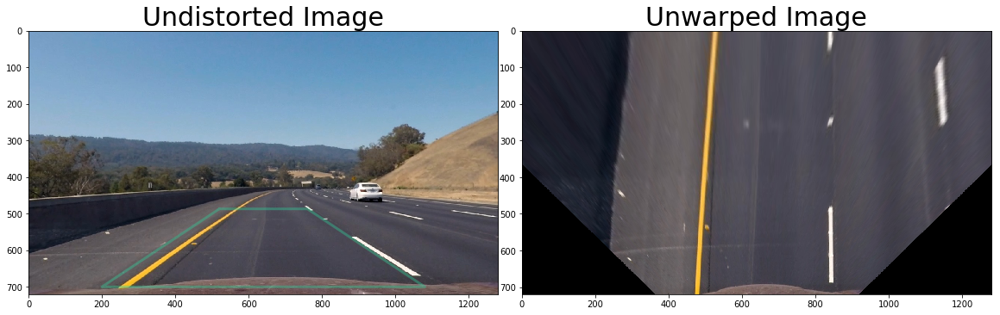

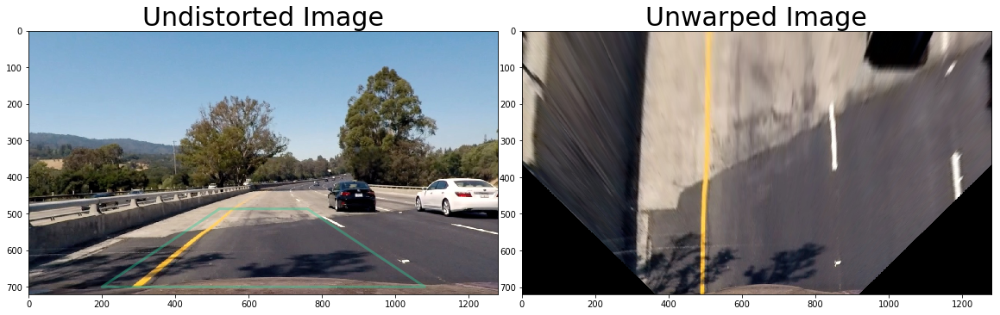

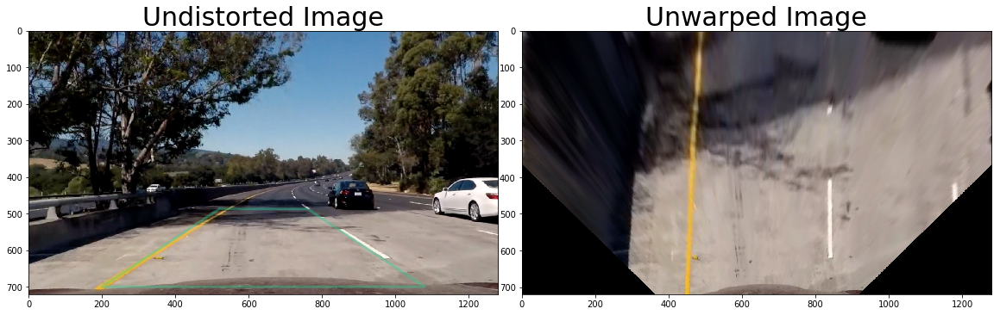

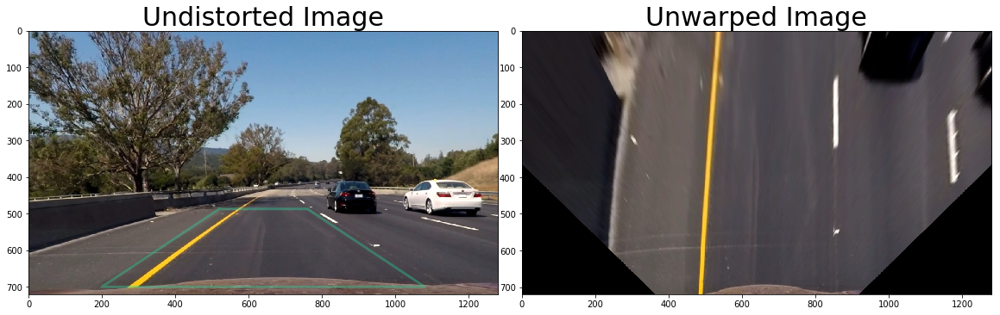

In [10]:
testImgs_unwarp = []
testImg_unwarp = None

for testImg_undistort in testImgs_undistort:
    # This time we are defining a four sided polygon to mask
    img_height, img_width = testImg_undistort.shape[:2]

    # define source and destination points for transform

    # Last Working for most
    src = np.float32([  ((img_width/2)-(img_width/16)-40, (6 * img_height / 10)+55),
                        ((img_width/2)+(img_width/16)+40, (6 * img_height / 10)+55),
                        (200, img_height-20),
                        (img_width-200, img_height-20)]) #-50

    dst = np.float32([(450,0),
                      (img_width-450,0),
                      (450,img_height),
                      (img_width-450,img_height)])

    testImg_unwarp, M, Minv = img_unwarp(testImg_undistort, src, dst)
    testImgs_unwarp.append(testImg_unwarp)
    
    # Visualize unwarp
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(testImg_undistort)
    x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
    y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
    ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_ylim([img_height,0])
    ax1.set_xlim([0,img_width])
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(testImg_unwarp)
    ax2.set_title('Unwarped Image', fontsize=30)


## 3. Gradient Threshold - Sobel Operator 

### A. Sobel Absolute Threshold

Calculate the Sobel gradient over the X and Y-axes :

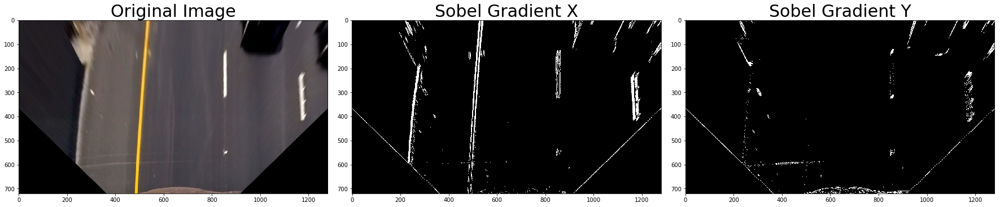

In [11]:
# Absolute Sobel Threshold function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    #print (scaled_sobel)

    # Return the result
    return binary_output

# Run the function
grad_X = abs_sobel_thresh(testImg_unwarp, orient='x', thresh_min=20, thresh_max=100)
grad_Y = abs_sobel_thresh(testImg_unwarp, orient='y', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(testImg_unwarp)
ax1.set_title('Original Image', fontsize=30)

ax2.imshow(grad_X, cmap='gray')
ax2.set_title('Sobel Gradient X', fontsize=30)

ax3.imshow(grad_Y, cmap='gray')
ax3.set_title('Sobel Gradient Y', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### B. Sobel Magnitude Threshold

Calculate the Sobel Magnitude of the X and Y-axes :

Done


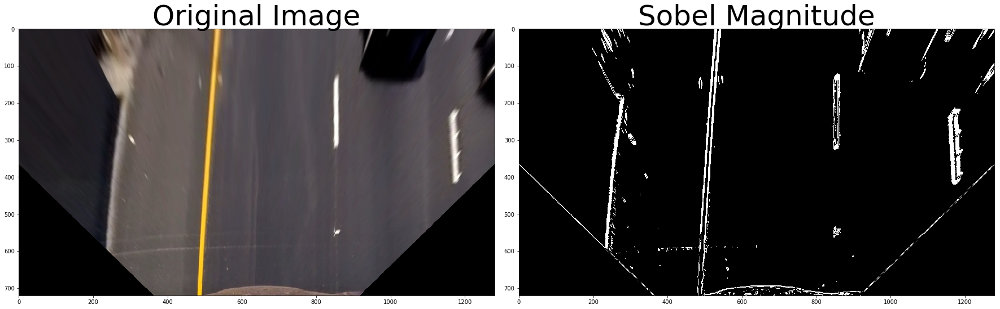

In [12]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output
# Run the function
mag_binary = mag_thresh(testImg_unwarp, sobel_kernel=3, mag_thresh=(20, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(testImg_unwarp)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Sobel Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
print ("Done")

### C. Sobel Direction Threshold

Calculate the Sobel Direction of the X and Y-axes :

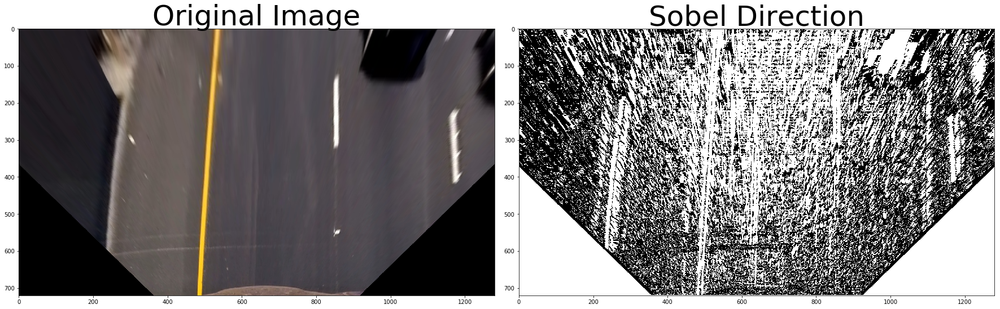

In [13]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=7, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    #binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    binary_output[(absgraddir < thresh[0]) | (absgraddir > thresh[1])] = 1
#     print (absgraddir)
    # Return the binary image
    return binary_output


# # Run the function
dir_binary = dir_threshold(testImg_unwarp, sobel_kernel=7, thresh=(0.4, 1.5)) # thresh=(0.7, 1.3)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(testImg_unwarp)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Sobel Direction', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### D. Sobel Combined Threshold

Calculate the Sobel Combination of the X and Y-axes or the Magnitude and Direction :

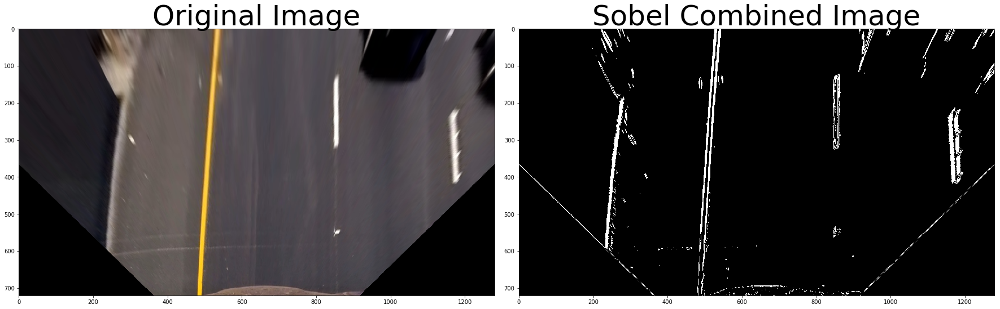

In [14]:
# Apply each of the thresholding functions
# gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(0, 255))
# grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(0, 255))
# mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(0, 255))
# dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0, np.pi/2))


combined = np.zeros_like(grad_Y)
combined[((grad_X == 1) & (grad_Y == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

# combined[((mag_binary == 1) & (dir_binary == 1))] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(testImg_unwarp)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Sobel Combined Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### E. Masking of White & Yellow Colors (RGB to HLS)

The White and Yellow lanes are detected independently in the HLS domain, then masked together to achieve higher accuracy

In [15]:
# This Masking function in the HLS domain was applied in the previous project (Project1: Finding Lane Lines)
# and it could perfectly show the yellow and white lanes 
def get_WY(image):
    """Image transformation from RGB to HLS,
    then the White & Yellow colors are detected & combined together"""
    # convert to HLS
    converted = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    # white color mask
    lower = np.uint8([  18, 190,   0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(converted, lower, upper)

    # yellow color mask
    lower = np.uint8([ 20, 10, 10]) # ([ 10,   0, 100]) 20,10,100
    upper = np.uint8([ 50, 255, 255]) # ([ 40, 255, 255])
    yellow_mask = cv2.inRange(converted, lower, upper)

    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    return cv2.bitwise_and(image, image, mask = mask)

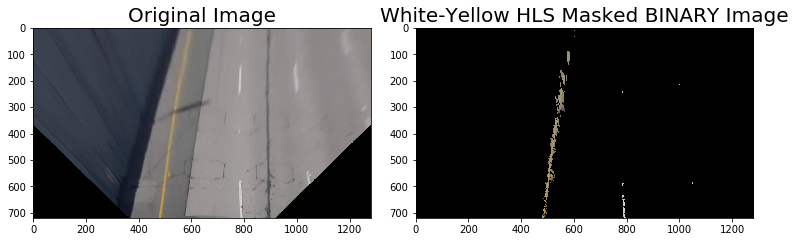

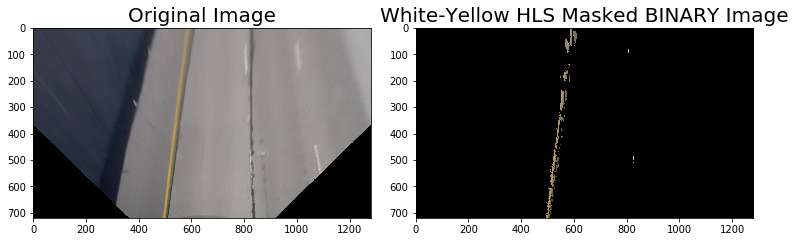

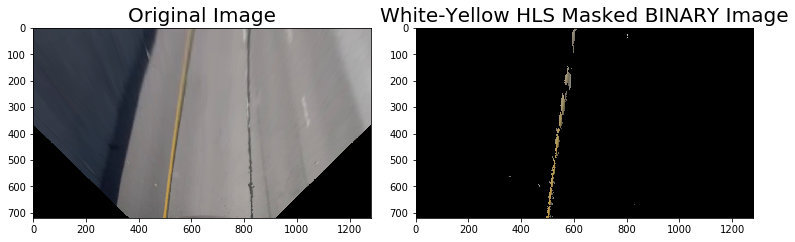

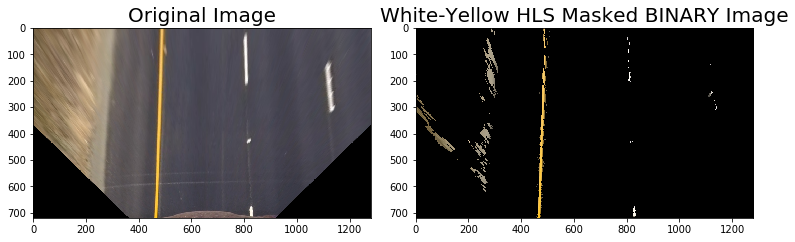

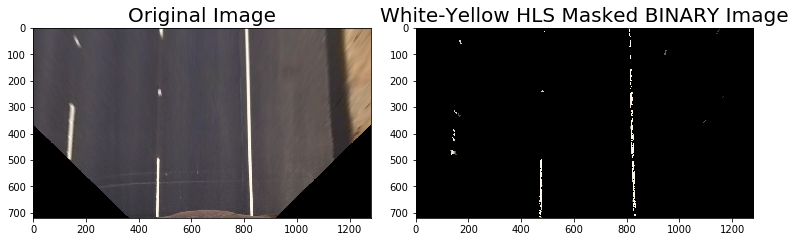

...

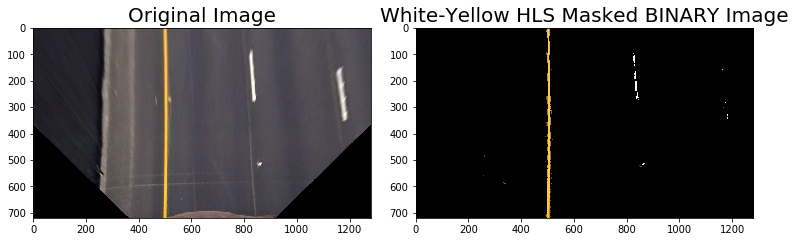

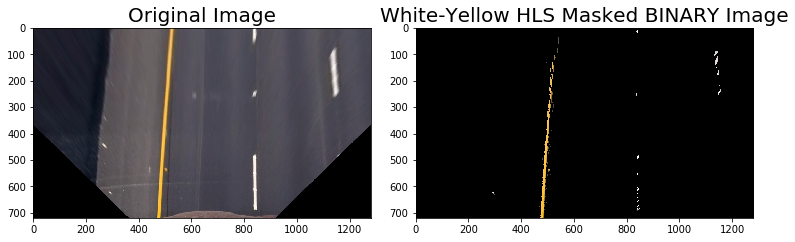

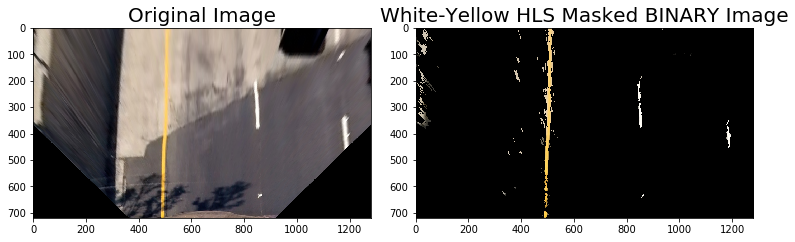

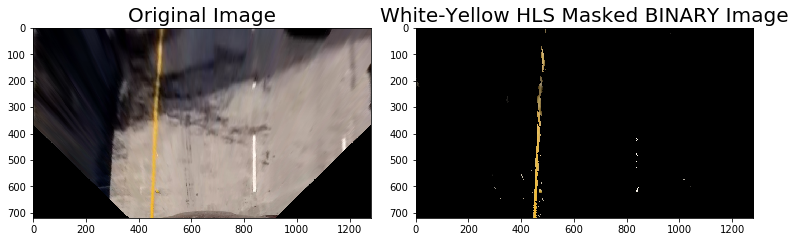

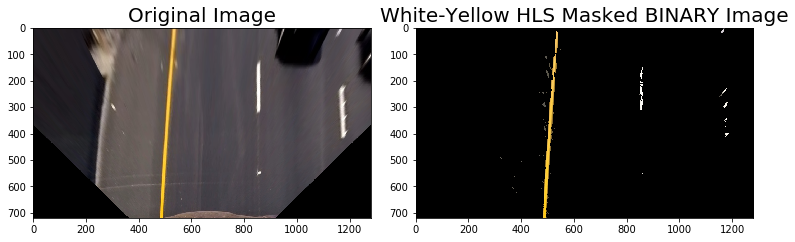

In [16]:
for testImg_unwarp in testImgs_unwarp: 
    white_yellow_img = get_WY(testImg_unwarp)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    f.tight_layout()
    ax1.imshow(testImg_unwarp)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(white_yellow_img, cmap='gray')
    ax2.set_title('White-Yellow HLS Masked BINARY Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### F. Sobel Combined with HLS Masking (Pipeline Test Images)

The White-Yellow image mask is inserted as an input for the Sobel thresholding functions to be much easier to identify the lane lines and the changes in the X & Y gradients. Hence the following code calls the (get_WY) function then the result is loaded to the Sobel Threshold functions which are transformed to binary images that are logically operated together and finally ORed with the Binary image of the Blue plane in the threshold range (200 to 255)

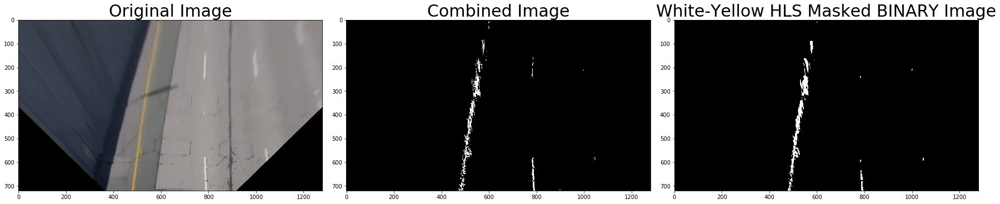

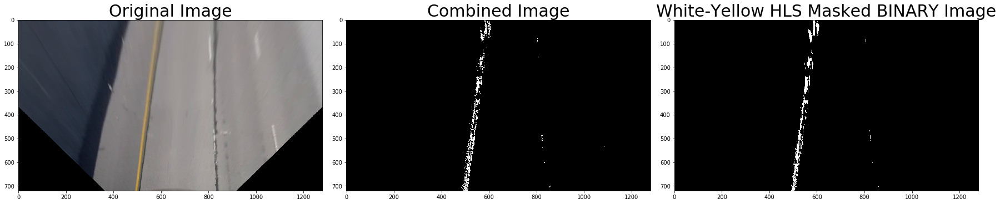

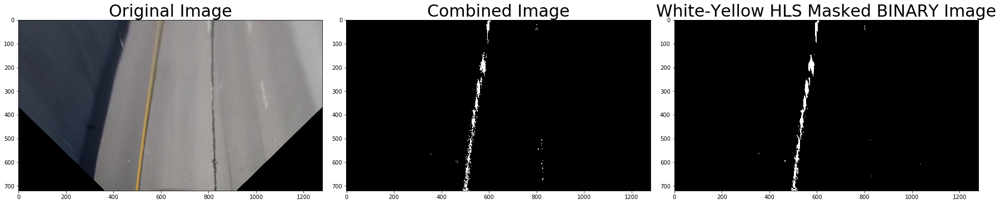

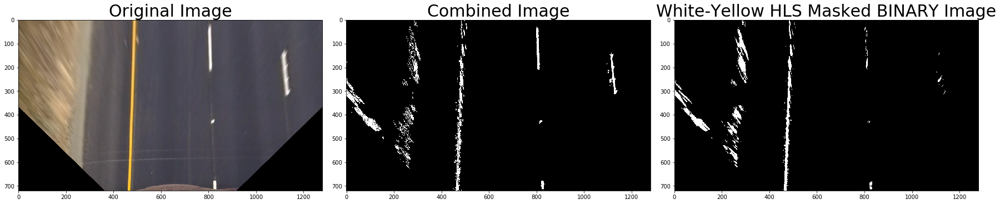

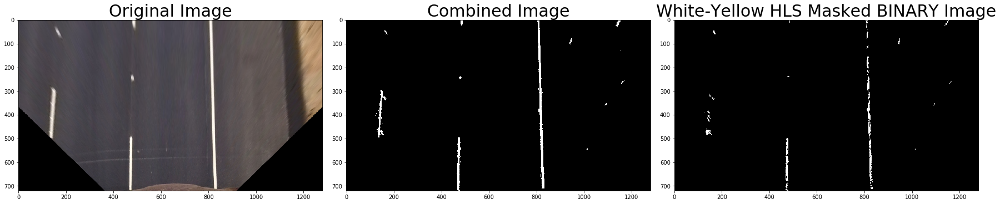

...

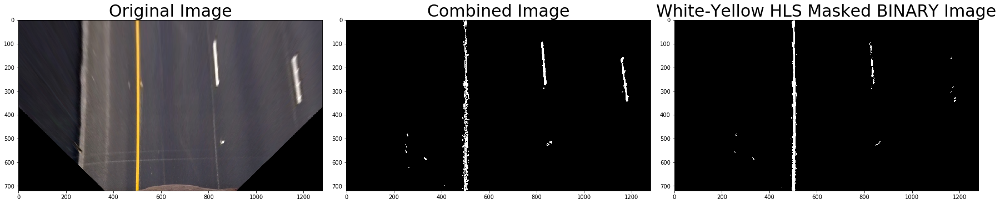

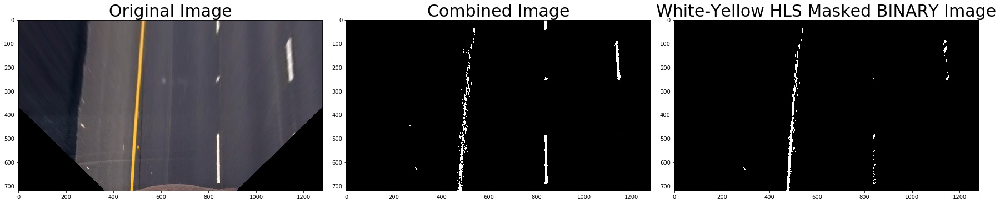

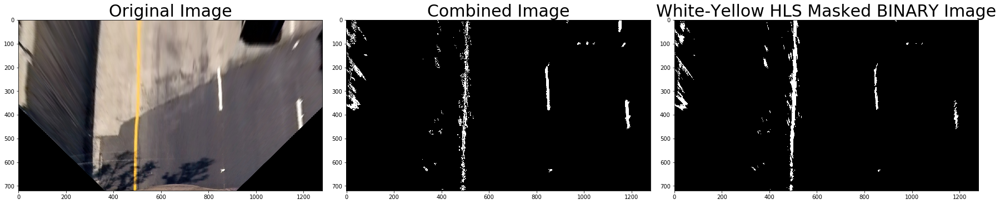

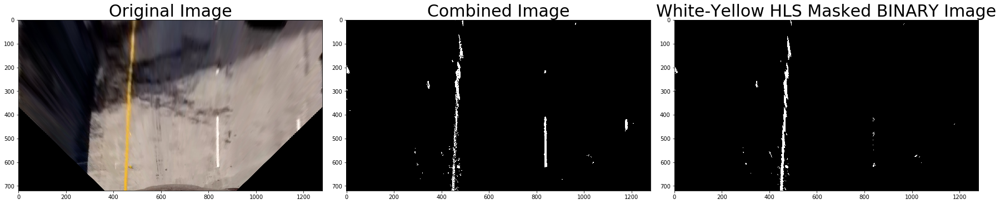

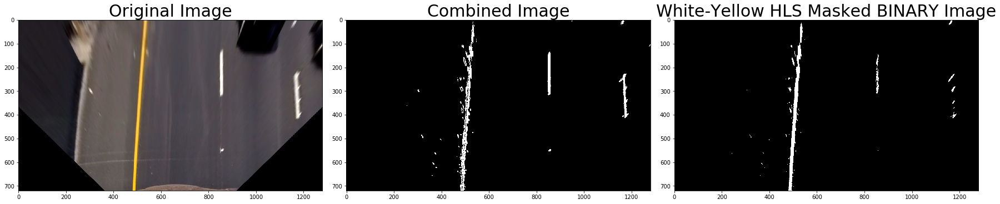

In [17]:
combined_Imgs = []
for testImg_unwarp in testImgs_unwarp:    
#     RGB Plane
    thresh = (100, 255)
    binary = np.zeros_like(gray)
    binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    
#   HLS Plane
    # Make the Bitwise combination of only White & Yellow Colors
    white_yellow_img = get_WY(testImg_unwarp)
    WY_img = white_yellow_img[:,:,0]|white_yellow_img[:,:,1]|white_yellow_img[:,:,2]
    # Yellowish Brown (HLS) : 25, 114, 123
    # Yellowish Brown (HLS) : 28, 39, 136  (Blurred)
    
    # Apply each of the thresholding functions
    grad_X = abs_sobel_thresh(white_yellow_img, orient='x', thresh_min=1, thresh_max=100)
    grad_Y = abs_sobel_thresh(white_yellow_img, orient='y', thresh_min=1, thresh_max=100)
    mag_binary = mag_thresh(white_yellow_img, sobel_kernel=3, mag_thresh=(1, 100))
    dir_binary = dir_threshold(white_yellow_img, sobel_kernel=7, thresh=(0.4, 1.5)) # thresh=(0.7, 1.3)
    
    B = testImg_unwarp[:,:,2]
    thresh = (200, 255)
    # BLUE Channel Binary
    B_binary = np.zeros_like(B)
    B_binary[(B > thresh[0]) & (B <= thresh[1])] = 1
    
    thresh = (0, 255)
    WY_bin = np.zeros_like(WY_img)
    WY_bin[((WY_img > thresh[0]) & (WY_img <= thresh[1]))] = 1 # 255

# #######################################################################
    combined = np.zeros_like(grad_Y)
    combined[((mag_binary == 1) & (dir_binary == 1)) | ((grad_X == 1) & (grad_Y == 1))] = 1
    combined = cv2.bitwise_or(combined, B_binary)
    combined_Imgs.append(combined)
        
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(testImg_unwarp)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined Image', fontsize=30)
    ax3.imshow(WY_bin, cmap='gray')
    ax3.set_title('White-Yellow HLS Masked BINARY Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 4. Color Transforms

### A. RGB Transforms

Display the Grayscale as well as the Red, Green, Blue (RGB) planes of the image

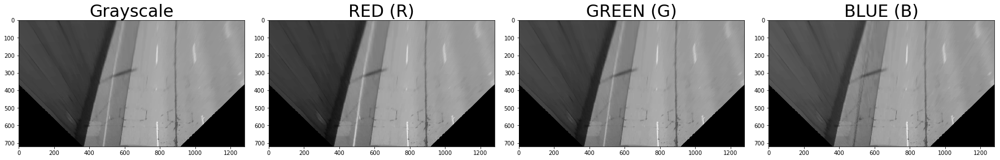

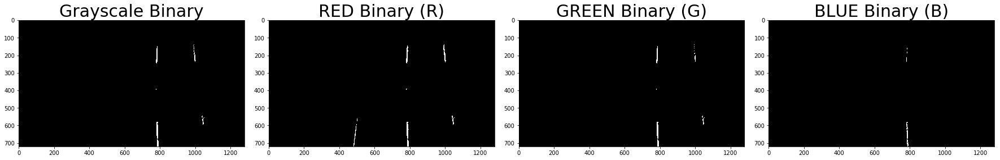

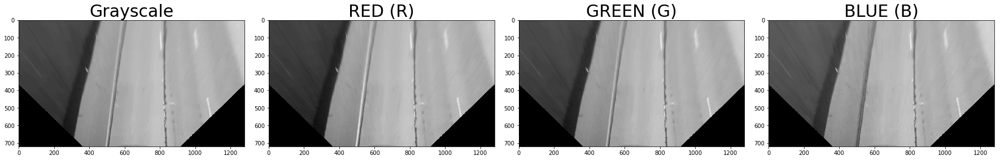

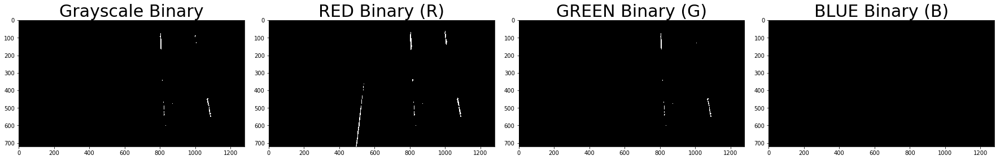

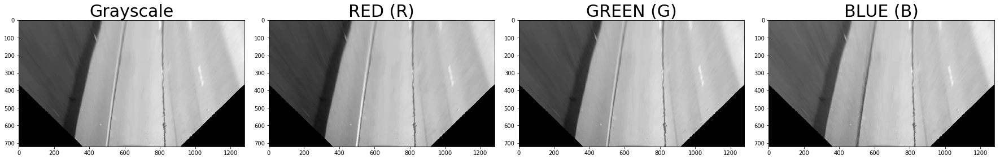

...

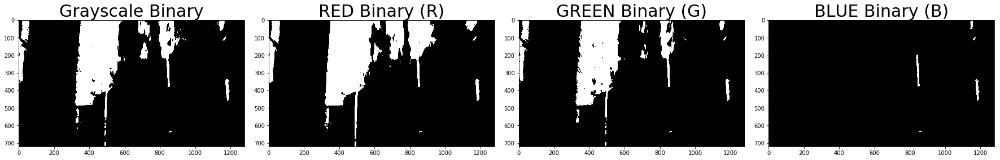

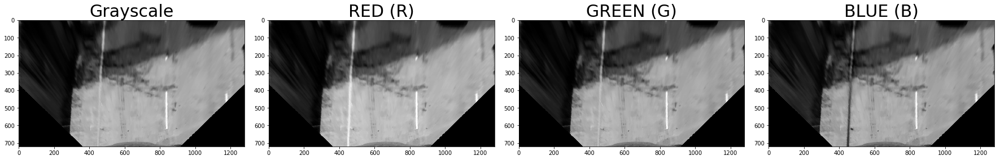

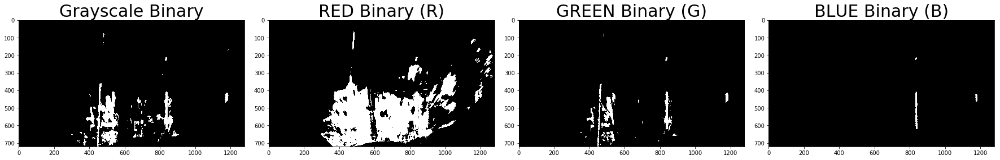

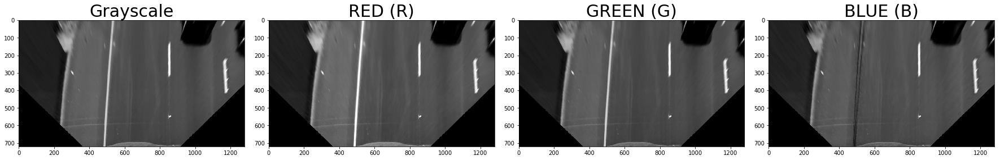

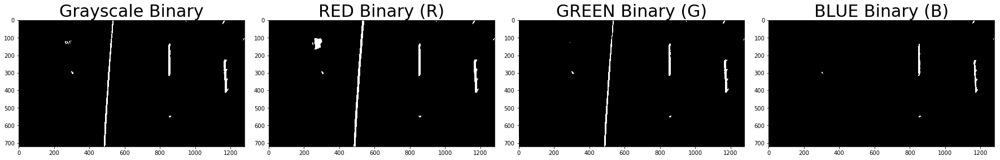

In [24]:
for image in testImgs_unwarp:

    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]

    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(gray, cmap='gray')
    ax1.set_title('Grayscale', fontsize=30)

    ax2.imshow(R, cmap='gray')
    ax2.set_title('RED (R)', fontsize=30)

    ax3.imshow(G, cmap='gray')
    ax3.set_title('GREEN (G)', fontsize=30)
      
    ax4.imshow(B, cmap='gray')
    ax4.set_title('BLUE (B)', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    thresh = (180, 255)
    
    # Gray Scale Binary
    binary = np.zeros_like(gray)
    binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    
    # RED Channel Binary
    R_binary = np.zeros_like(R)
    R_binary[(R > thresh[0]) & (R <= thresh[1])] = 1

    # GREEN Channel Binary
    G_binary = np.zeros_like(G)
    G_binary[(G > thresh[0]) & (G <= thresh[1])] = 1

    thresh = (200, 255)
    # BLUE Channel Binary
    B_binary = np.zeros_like(B)
    B_binary[(B > thresh[0]) & (B <= thresh[1])] = 1

    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary, cmap='gray')
    ax1.set_title('Grayscale Binary', fontsize=30)

    ax2.imshow(R_binary, cmap='gray')
    ax2.set_title('RED Binary (R)', fontsize=30)

    ax3.imshow(G_binary, cmap='gray')
    ax3.set_title('GREEN Binary (G)', fontsize=30)

    ax4.imshow(B_binary, cmap='gray')
    ax4.set_title('BLUE Binary (B)', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

The R-Binary (RED Binary) Image seems to identify the lanes and show them very clear more than the other color channels, however it failed in the bright images in which the lanes appear faded to a high extent. The B-Binary (Blue plane) image has less noises and it detects the white lanes clearer than the other planes even in different brightness levels. For this reason, the Blue Binary plane was combined with the Sobel Thresholded results (ORed together) to emphasize more the clearance of the white lanes.

### B. HLS Transforms

Display the Hue, Luminance and Saturation (HLS) planes independently.

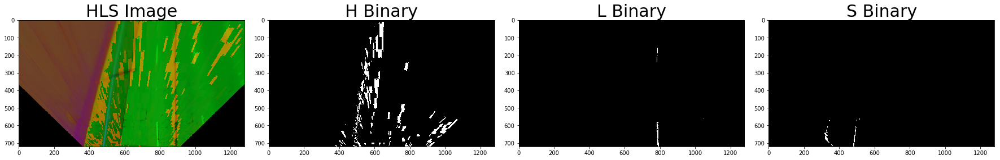

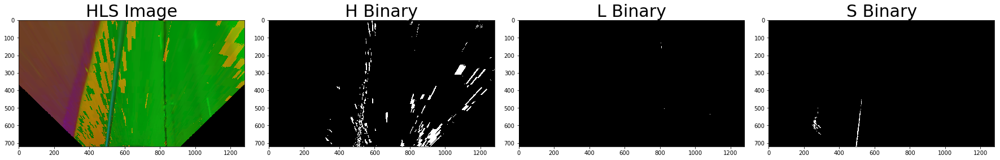

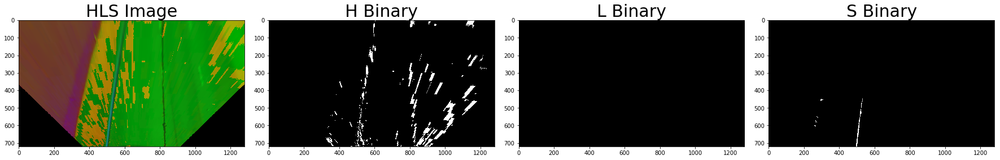

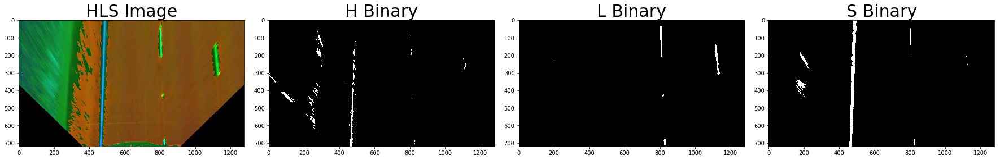

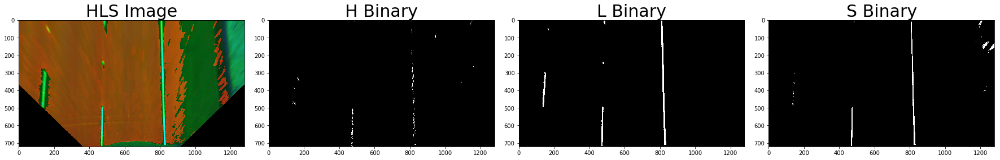

...

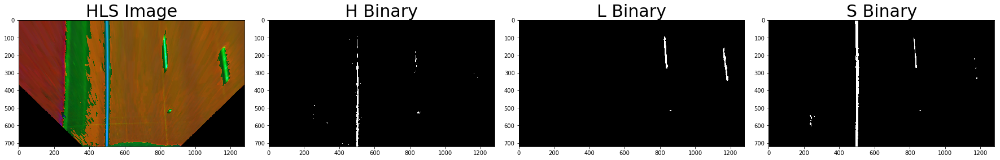

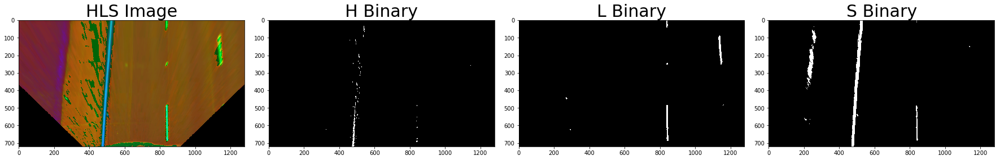

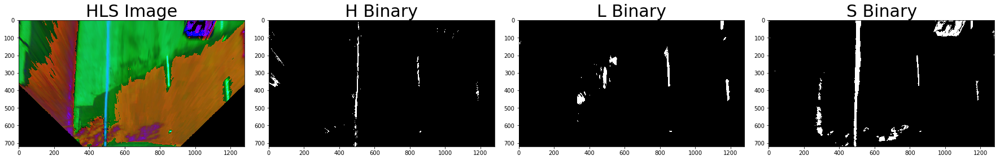

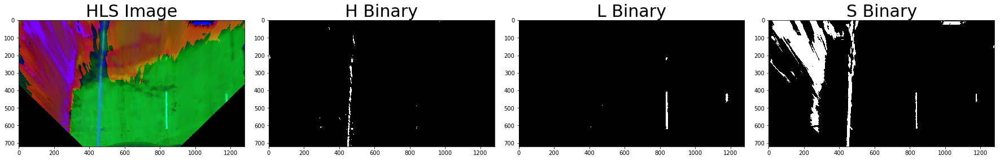

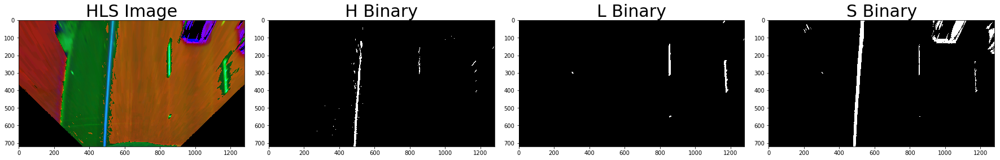

In [36]:
# Define a function that thresholds the S-channel of HLS
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

for image in testImgs_unwarp:
#     hls_binary = hls_select(image, thresh=(90, 255))
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    # print ("hls =")
    # print (hls)
    H = hls[:,:,0]
    # print ("H =")
    # print (H)
    L = hls[:,:,1]
    # print ("L =")
    # print (L)
    S = hls[:,:,2]

    thresh = (20, 40)
    H_binary = np.zeros_like(H)
    H_binary[(H > thresh[0]) & (H <= thresh[1])] = 1

    thresh = (200, 255)
    L_binary = np.zeros_like(L)
    L_binary[(L > thresh[0]) & (L <= thresh[1])] = 1

    thresh = (100, 255)
    S_binary = np.zeros_like(S)
    S_binary[(S > thresh[0]) & (S <= thresh[1])] = 1

    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(hls, cmap='gray')
    ax1.set_title('HLS Image', fontsize=30)

    ax2.imshow(H_binary, cmap='gray')
    ax2.set_title('H Binary', fontsize=30)

    ax3.imshow(L_binary, cmap='gray')
    ax3.set_title('L Binary', fontsize=30)

    ax4.imshow(S_binary, cmap='gray')
    ax4.set_title('S Binary', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


The Hue with threshold range (20-40) detects the yellow colored lanes and the Luminance with threshold range (200-255) detects the high Luminance values which represents most likely the White color range.

## 5. Histogram Peaks

Apply the Historgram on the bottom half of the binary image to detect the nearest lane lines to the car. Applying the np.sum with axis=0 will sum the image pixels vertically to get the largest values over the highest ares of vertical lines.

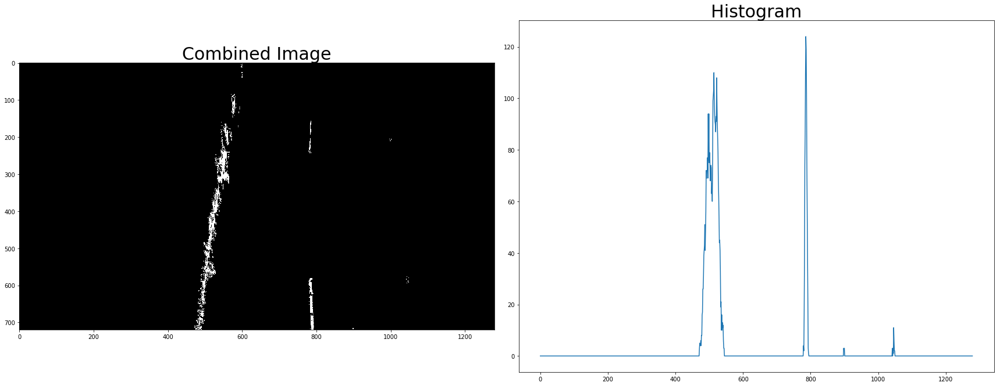

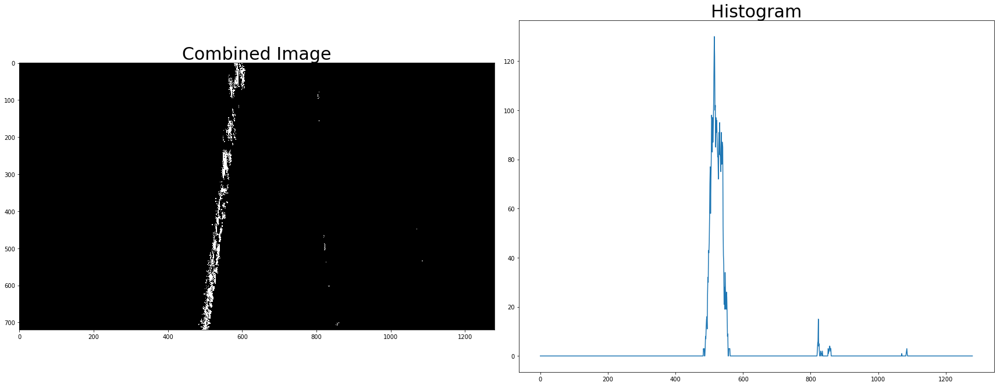

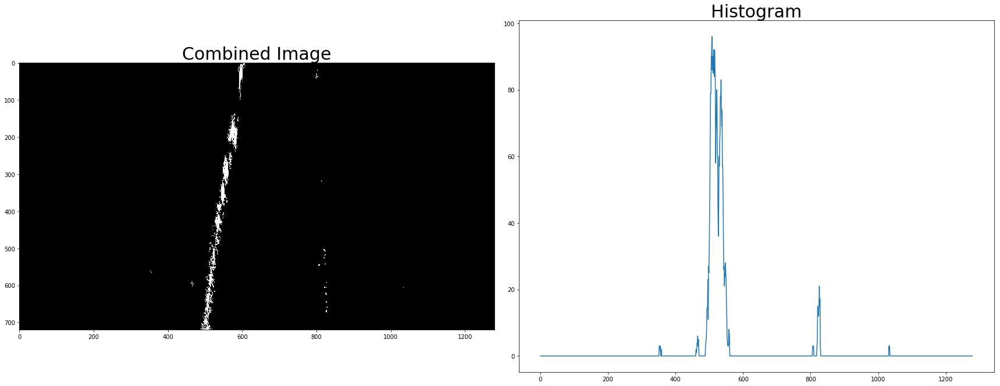

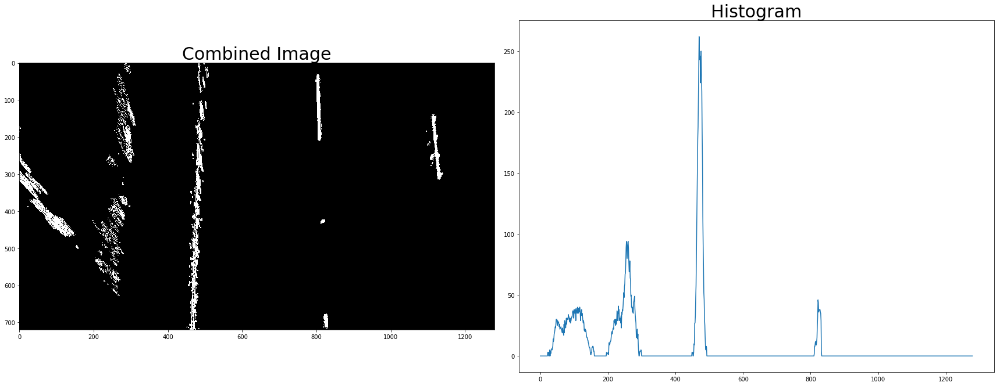

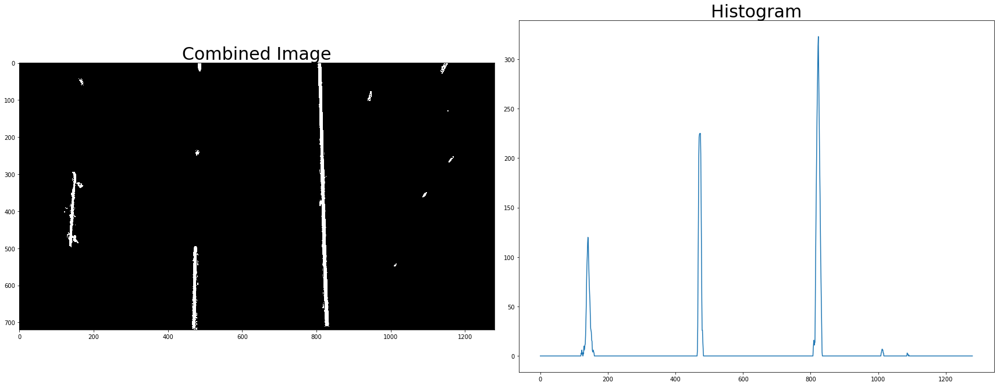

...

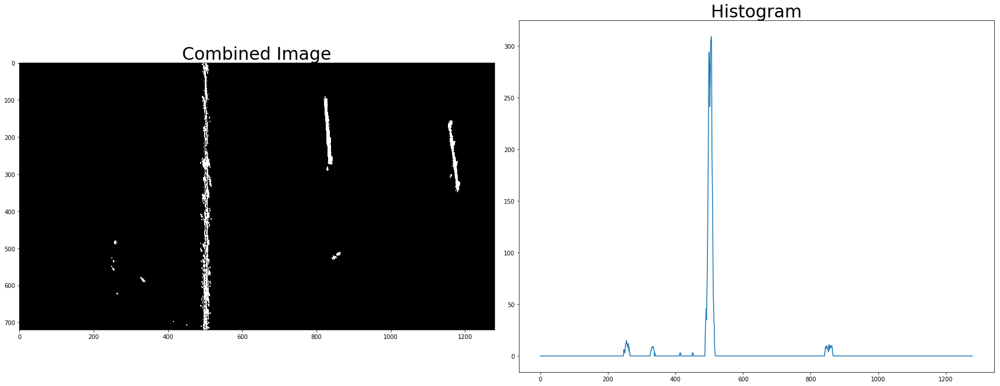

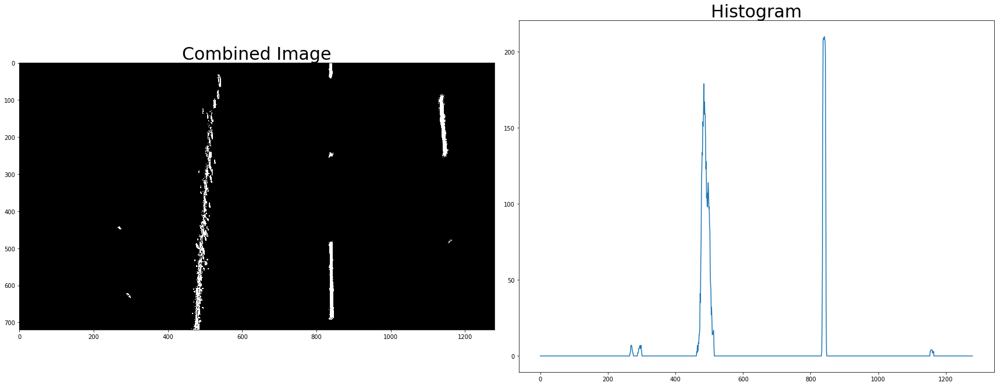

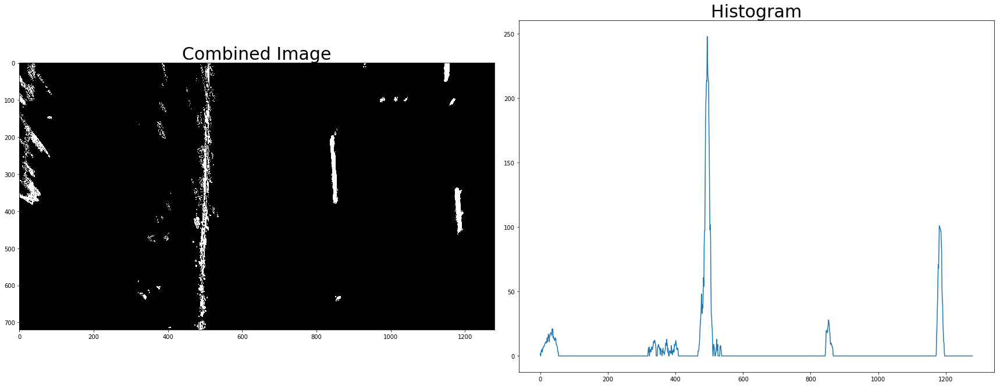

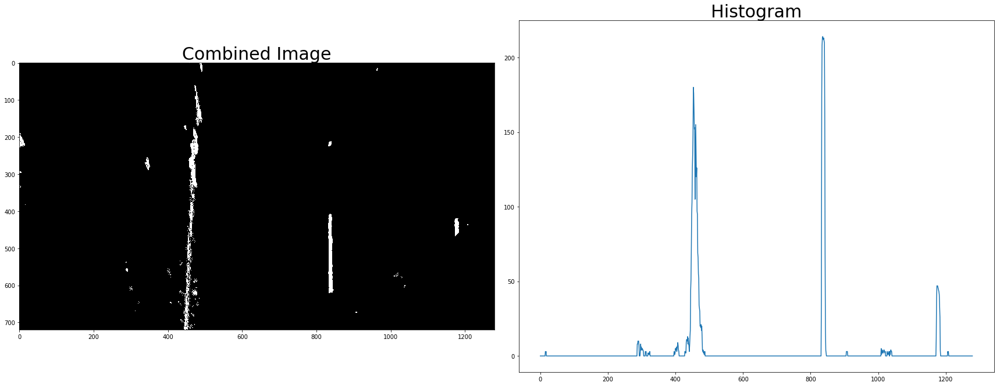

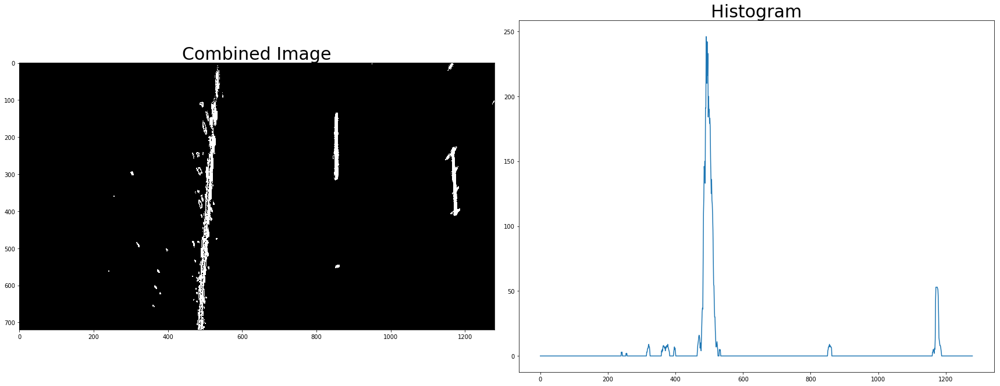

In [27]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # Sum across image pixels vertically - make sure to set an `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    
    return histogram

for combined in combined_Imgs:
    # WY_bin is represented in 0-255, so normalize back to 0-1
    binary_warped = combined # WY_bin #/255

    # Create histogram of image binary activations
    histogram = hist(binary_warped)

    # Visualize the resulting histogram
#     plt.plot(histogram)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(combined, cmap='gray')
    ax1.set_title('Combined Image', fontsize=30)
    ax2.plot(histogram)
    ax2.set_title('Histogram', fontsize=30)
    

## 6. Sliding Window & Polynomial Fitting

After applying the histogram for the bottom half of the binary image, the peaks of the left and right quarters around the center of the histogram are detected. Afterwards sliding windows are drawn around the detected lines to display the paths to iterate through them to find the curvature, then a Polynomial fitting function is applied to draw the left and right lane lines clearly.

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 786


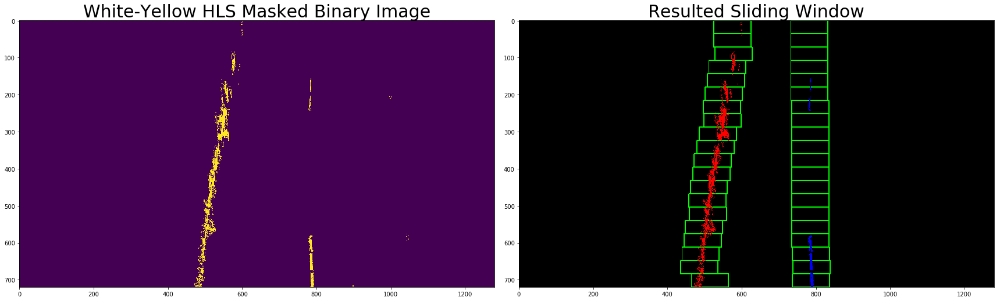

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 823


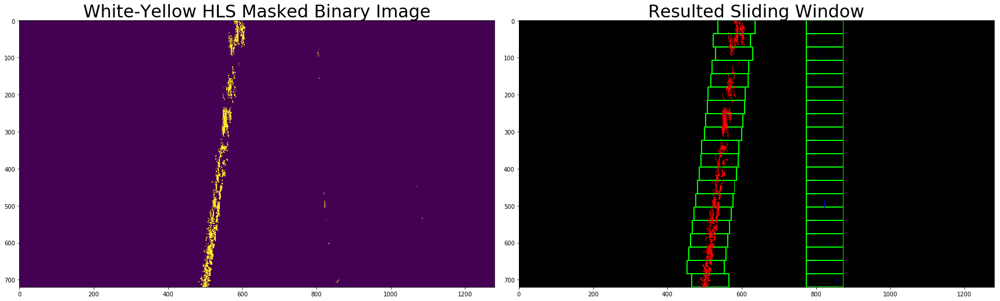

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 508
rightx_base = 826


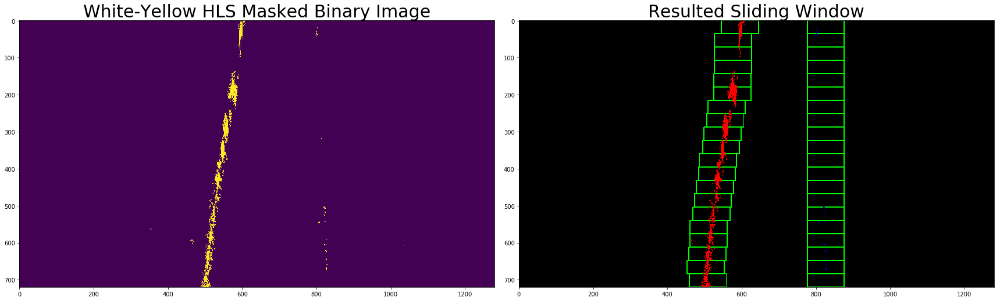

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 470
rightx_base = 822


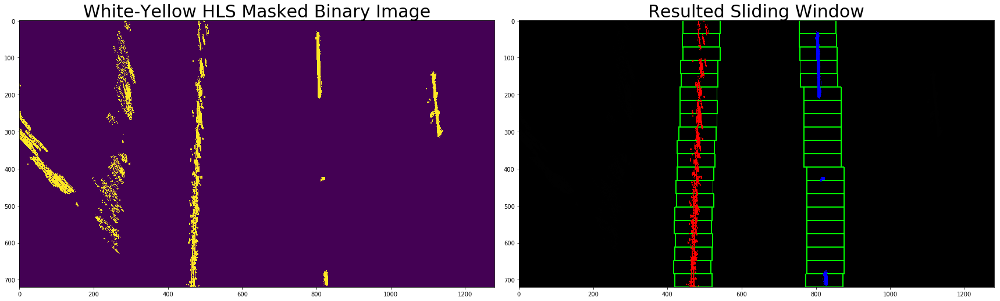

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 823


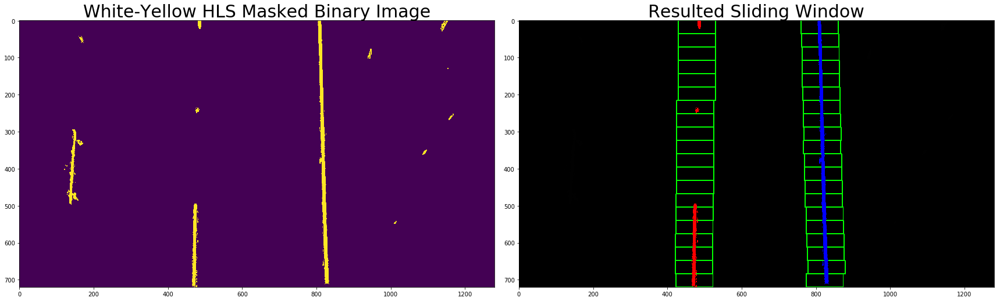

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 848


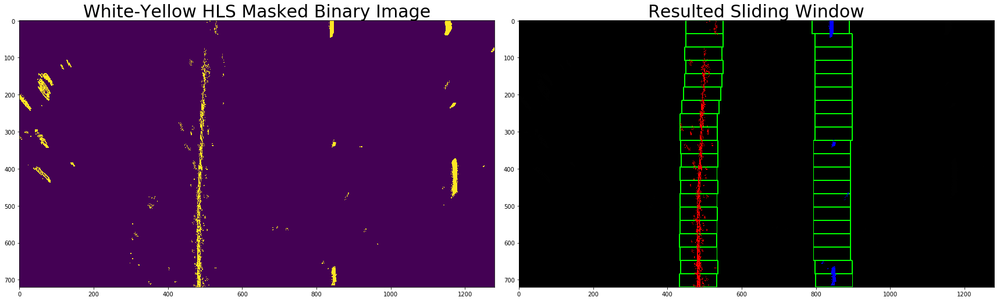

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 854


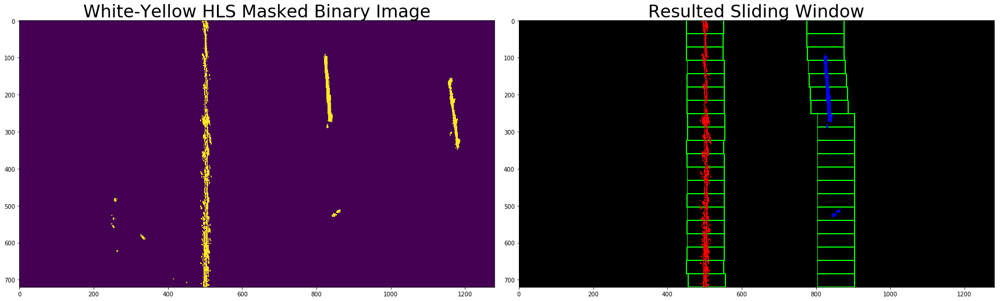

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 841


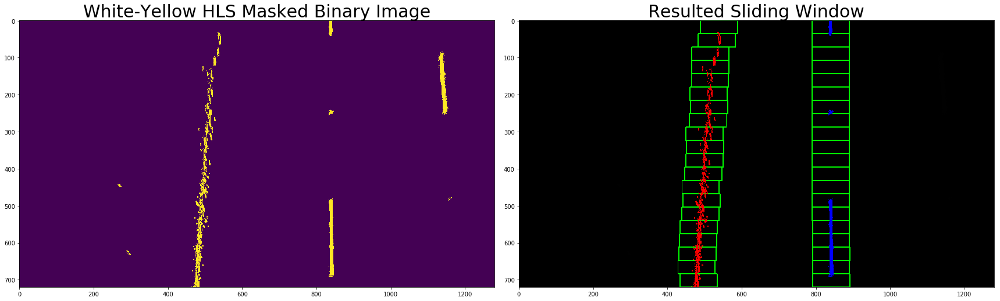

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 853


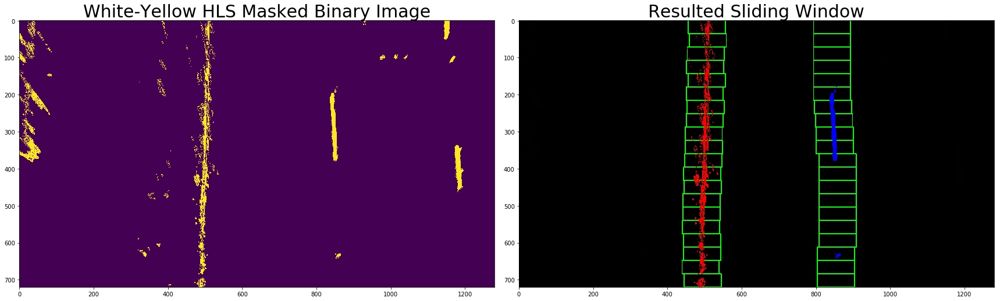

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 453
rightx_base = 836


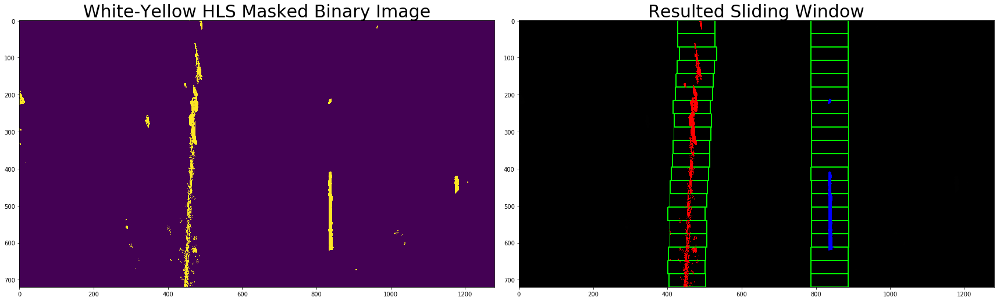

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 856


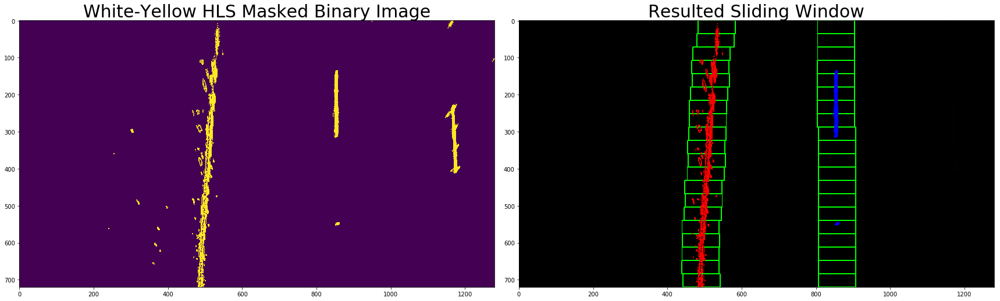

In [18]:

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
#     plt.plot(histogram)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Find the peak of the left and right quarters around the center of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    quarter_point = np.int(midpoint//2)
    
    leftx_base = np.argmax(histogram[quarter_point:midpoint]) + quarter_point
    rightx_base = np.argmax(histogram[midpoint:(midpoint+quarter_point)]) + midpoint
    
#     leftx_base = np.argmax(histogram[:midpoint])
#     rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    print ('binary_warped.shape = '+str(binary_warped.shape))
    print ('midpoint = '+str(midpoint))
    print ('quarterpoint = '+str(quarter_point))
    print ('leftx_base = '+str(leftx_base))
    print ('rightx_base = '+str(rightx_base))
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 20     #10  #9
    # Set the width of the windows +/- margin
    margin = 50    #80 #100
    # Set minimum number of pixels found to recenter window
    minpix = 60 #40 #50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
#     # Rectangle data for visualization
    rectangle_data = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
#         rectangle_data.append((win_y_low, win_y_high, win_xleft_low, win_xleft_high, win_xright_low, win_xright_high))
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
#         print (good_left_inds)
#         print (good_right_inds)
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    
    left_fit, right_fit = (None, None)
     # Fit a second order polynomial to each using `np.polyfit`
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
#     # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
    return ploty, left_fit, right_fit, out_img

Imgs_left_fit = []
Imgs_Right_fit = []

for combined in combined_Imgs:
    # WY_bin is represented in 0-255, so normalize back to 0-1
    binary_warped = combined # WY_bin #/255
    ploty, left_fit, right_fit, out_img = fit_polynomial(binary_warped)
    
    Imgs_left_fit.append(left_fit)
    Imgs_Right_fit.append(right_fit)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_warped)
    ax1.set_title('White-Yellow HLS Masked Binary Image', fontsize=30)
    
    ax2.imshow(out_img, cmap='gray')
    ax2.set_title('Resulted Sliding Window', fontsize=30)
    plt.show()

In [29]:
# Example of the Left and Right fits Coefficients for the fitted Polynomial
print (left_fit)
print (right_fit)

[  3.69089781e-05  -8.90202922e-02   5.32561011e+02]
[  3.22293357e-05  -1.49374478e-02   8.55224502e+02]


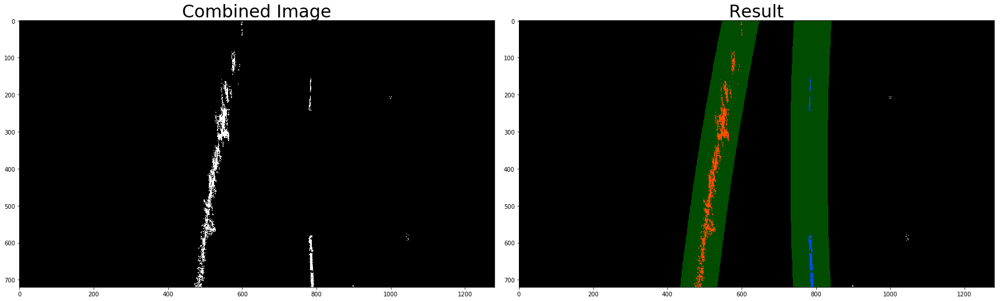

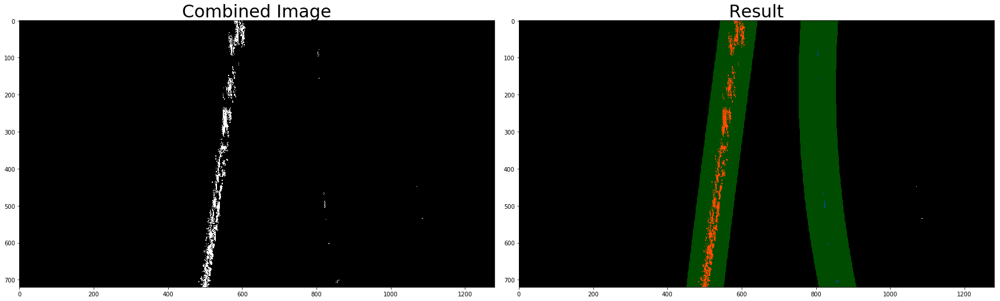

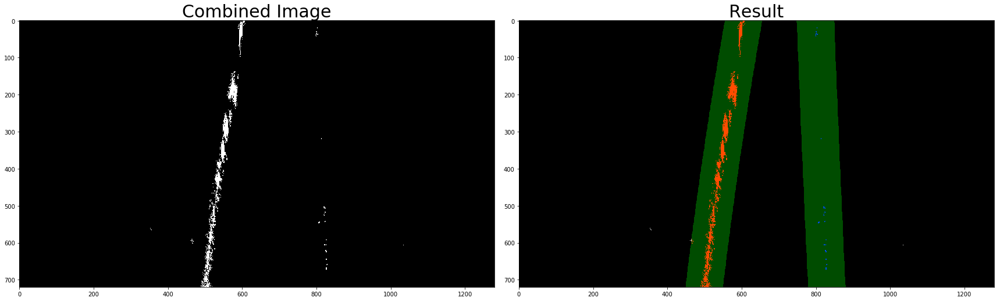

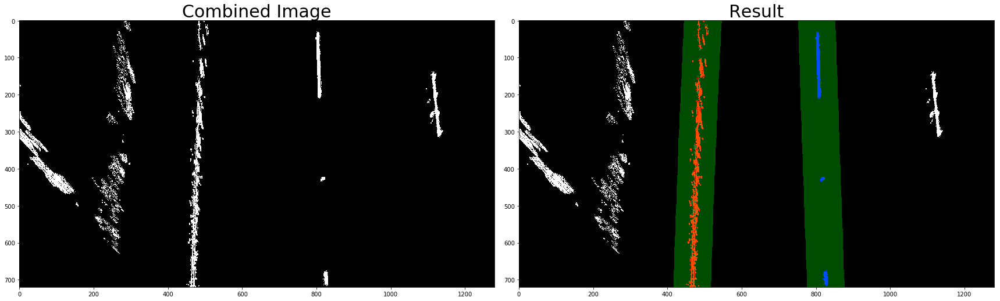

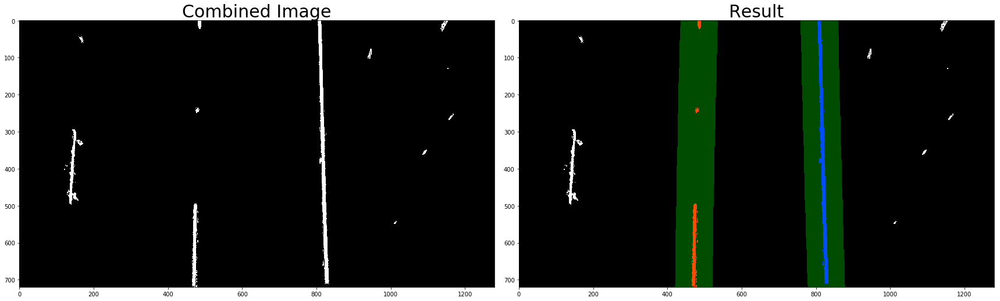

...

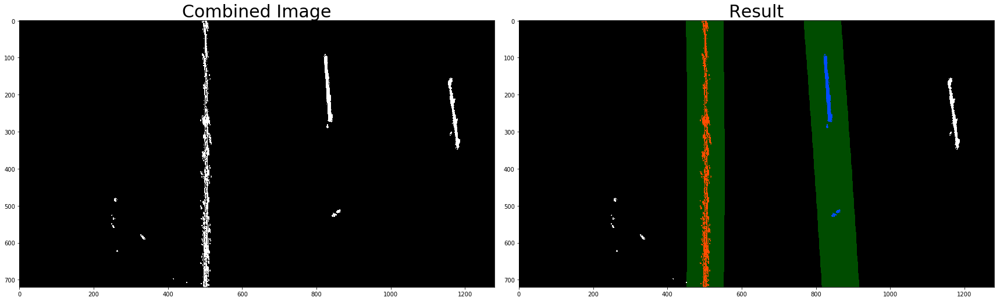

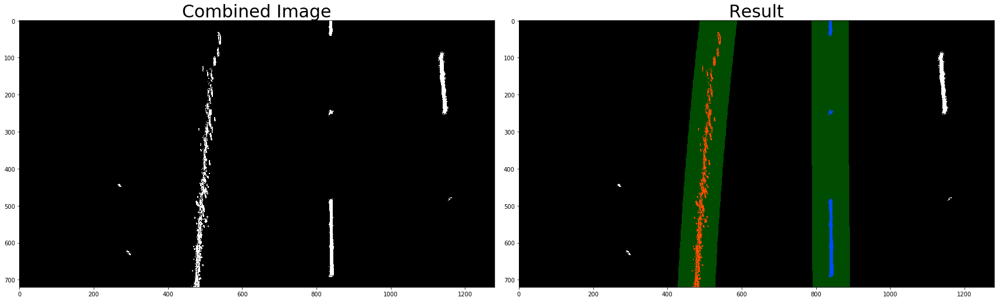

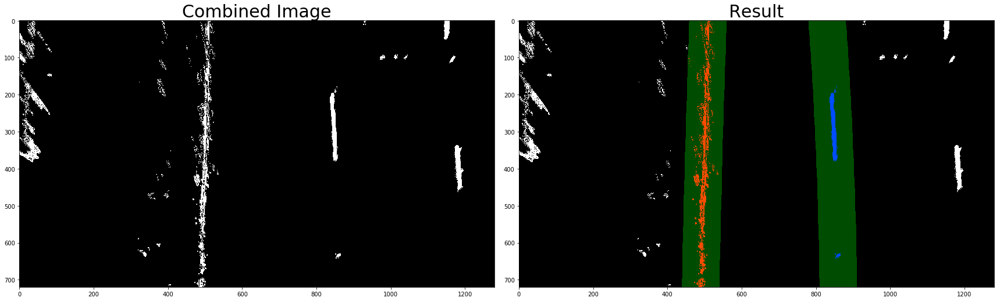

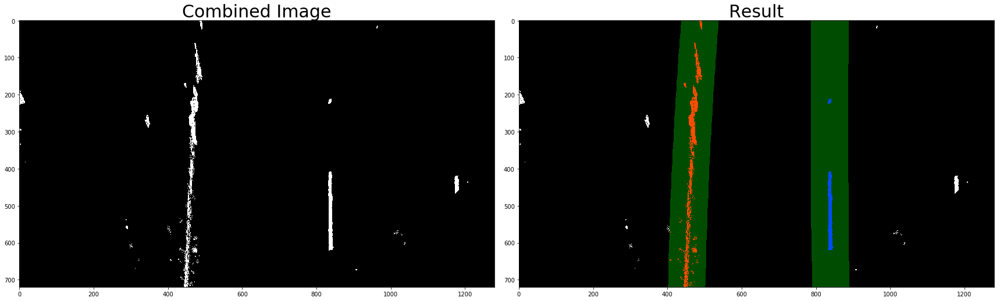

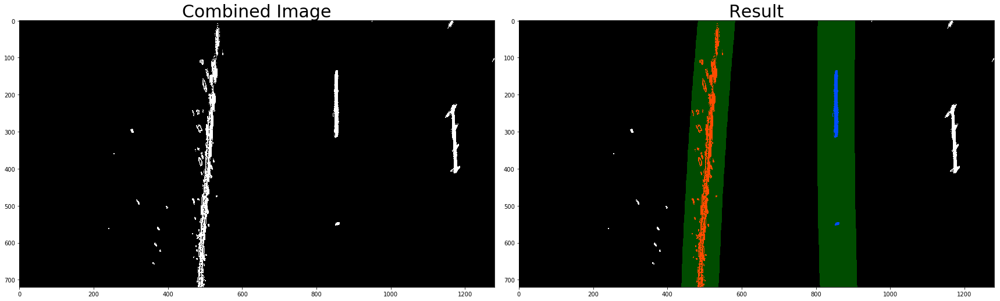

In [20]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    left_fit, right_fit = (None, None)
     # Fit a second order polynomial to each using `np.polyfit`
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 50 

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
#     print (left_lane_inds)
#     print (right_lane_inds)
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
#     # Plot the polynomial lines onto the image
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    return result, left_lane_inds, right_lane_inds

# plt.imshow(binary_warped)
# plt.show()
# # Polynomial fit values from the previous frame
# # Make sure to grab the actual values from the previous step in your project!
# left_fit = np.array([ 2.13935315e-04, -3.77507980e-01,  4.76902175e+02])
# right_fit = np.array([4.17622148e-04, -4.93848953e-01,  1.11806170e+03])

for idx, combined in enumerate(combined_Imgs):
    # WY_bin is represented in 0-255, so normalize back to 0-1
#     combined = combined_Imgs[4]
    binary_warped = combined # WY_bin #/255
    
    # Run image through the pipeline
    # The calculations are fed from the previous fits of each image.
    left_fit = Imgs_left_fit[idx]
    right_fit = Imgs_Right_fit[idx]
    
    result, left_lane_inds, right_lane_inds = search_around_poly(binary_warped)

     # View your output
    #     plt.imshow(result)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_warped, cmap='gray')
    ax1.set_title('Combined Image', fontsize=30)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Result', fontsize=30)   

## 7. Calculate the radius of curvature for both lane lines in meters

In [21]:
# Method to determine radius of curvature and distance from lane center 
# based on binary image, polynomial fit, and L and R lane pixel indices
def curv_rad_center(bin_img, l_fit, r_fit, l_lane_inds, r_lane_inds):
    # Define conversions in x and y from pixels space to meters
#     ym_per_pix = 3.048/100 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
#     xm_per_pix = 3.7/378 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    h = bin_img.shape[0]
    ploty = np.linspace(0, h-1, h)
    y_eval = np.max(ploty)
  
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Again, extract left and right line pixel positions
    leftx = nonzerox[l_lane_inds]
    lefty = nonzeroy[l_lane_inds] 
    rightx = nonzerox[r_lane_inds]
    righty = nonzeroy[r_lane_inds]
    
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        # Now our radius of curvature is in meters
    
    # Distance from center is image x midpoint - mean of l_fit and r_fit intercepts 
    if r_fit is not None and l_fit is not None:
        car_position = bin_img.shape[1]/2
        l_fit_x_int = l_fit[0]*h**2 + l_fit[1]*h + l_fit[2]
        r_fit_x_int = r_fit[0]*h**2 + r_fit[1]*h + r_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    return left_curverad, right_curverad, center_dist
print('Done')

Done


In [22]:
rad_l, rad_r, d_center = curv_rad_center(binary_warped, left_fit, right_fit, left_lane_inds, right_lane_inds)

print('Radius of curvature for example:', rad_l, 'm,', rad_r, 'm')
print('Distance from lane center for example:', d_center, 'm')

Radius of curvature for example: 4449.64497687 m, 5095.68794622 m
Distance from lane center for example: -0.181768427469 m


### Draw the Detected Lane Back onto the Original Image

In [23]:
def draw_lane(original_img, binary_img, l_fit, r_fit, Minv):
    new_img = np.copy(original_img)
    if l_fit is None or r_fit is None:
        return original_img
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    h,w = binary_img.shape
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    left_fitx = l_fit[0]*ploty**2 + l_fit[1]*ploty + l_fit[2]
    right_fitx = r_fit[0]*ploty**2 + r_fit[1]*ploty + r_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.5, 0)
    return result
print('Done')

Done


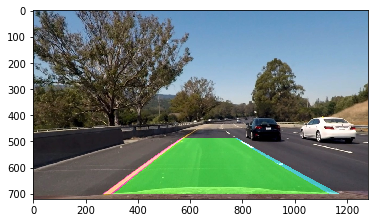

In [24]:
testImg_warpback = draw_lane(testImg_undistort, binary_warped, left_fit, right_fit, Minv)
plt.imshow(testImg_warpback)
plt.show()

### Draw Curvature Radius and Distance from Center Data onto the Original Image

In [25]:
def draw_data(original_img, curv_rad, center_dist):
    new_img = np.copy(original_img)
    h = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curv_rad) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return new_img
print('Done')

Done


Done


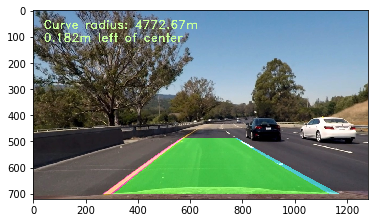

In [26]:
testImg_Final = draw_data(testImg_warpback, (rad_l+rad_r)/2, d_center)
plt.imshow(testImg_Final)
print('Done')

## Processing Images Pipeline

The following "process_image" function includes all the previous steps from the undistortion and the perspective transformation of the image till drawing the lanes after doing the polynomial fitting and measuring the radius of curvature. This function will also be used to calculate the images of each frame in the video

In [27]:
def process_image(image):
    
    # Image Undistortion:
    
    ## We had already calculated the Camera Calibration Matrices Values (mtx, dst) 
    ## The function undistort(img) calls the cv2.undistort which takes directly the Camera Calibration values.
    Img_undist = undistort(image)
    #--------------------------------------------------------------------------------------------
    # Perspective Transformation
    
    ## Define the SRC (Source) and DST (Destination) points 
    img_height, img_width = Img_undist.shape[:2]
  
    src = np.float32([  ((img_width/2)-(img_width/16)-40, (6 * img_height / 10)+55),
                    ((img_width/2)+(img_width/16)+40, (6 * img_height / 10)+55),
                    (200, img_height-20),
                    (img_width-200, img_height-20)])
        
    dst = np.float32([(450,0),
                      (img_width-450,0),
                      (450,img_height),
                      (img_width-450,img_height)])
    Img_unwarp, M, Minv = img_unwarp(Img_undist, src, dst)
    #--------------------------------------------------------------------------------------------
    
    # Make the Bitwise combination of only White & Yellow Colors
#     white_yellow_img = select_white_yellow(Img_unwarp)
#     WY_img = white_yellow_img[:,:,0] #| white_yellow_img[:,:,1] | white_yellow_img[:,:,2]

#     thresh = (0, 255)
#     WY_bin = np.zeros_like(WY_img)
#     WY_bin[((WY_img > thresh[0]) & (WY_img <= thresh[1]))] = 1 # 255

#     # Make the Bitwise combination of only White & Yellow Colors
    WY_img = get_WY(Img_unwarp)
        
    # Apply each of the thresholding functions
    Img_grad_X = abs_sobel_thresh(WY_img, orient='x', thresh_min=1, thresh_max=100)
    Img_grad_Y = abs_sobel_thresh(WY_img, orient='y', thresh_min=1, thresh_max=100)
    Img_mag_binary = mag_thresh(WY_img, sobel_kernel=3, mag_thresh=(1, 100))
    Img_dir_binary = dir_threshold(WY_img, sobel_kernel=7, thresh=(0.4, 1.5)) # thresh=(0.7, 1.3)
    
    B = Img_unwarp[:,:,2]
    thresh = (200, 255)
    # BLUE Channel Binary
    B_binary = np.zeros_like(B)
    B_binary[(B > thresh[0]) & (B <= thresh[1])] = 1
    
#     thresh = (0, 255)
#     WY_bin = np.zeros_like(WY_img)
#     WY_bin[((WY_img > thresh[0]) & (WY_img <= thresh[1]))] = 1 # 255

    Img_combined = np.zeros_like(Img_grad_Y)
    Img_combined[((Img_mag_binary == 1) & (Img_dir_binary == 1)) | ((Img_grad_X == 1) & (Img_grad_Y == 1))] = 1
    Img_combined = cv2.bitwise_or(Img_combined, B_binary)
    
    #--------------------------------------------------------------------------------------------  
    
    ploty, left_fit, right_fit, final_Img = fit_polynomial(Img_combined)
    
    result, left_lane_inds, right_lane_inds = search_around_poly(Img_combined)

    rad_l, rad_r, d_center = curv_rad_center(Img_combined, left_fit, right_fit, left_lane_inds, right_lane_inds)

    Img_warpback = draw_lane(Img_undist, Img_combined, left_fit, right_fit, Minv)

    Img_Final = draw_data(Img_warpback, (rad_l+rad_r)/2, d_center)
    
    return Img_Final

['./test_images\\challenge01.jpg', './test_images\\challenge02.jpg', './test_images\\challenge03.jpg', './test_images\\straight_lines1.jpg', './test_images\\straight_lines2.jpg', './test_images\\test1.jpg', './test_images\\test2.jpg', './test_images\\test3.jpg', './test_images\\test4.jpg', './test_images\\test5.jpg', './test_images\\test6.jpg']
./test_images\challenge01.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 786


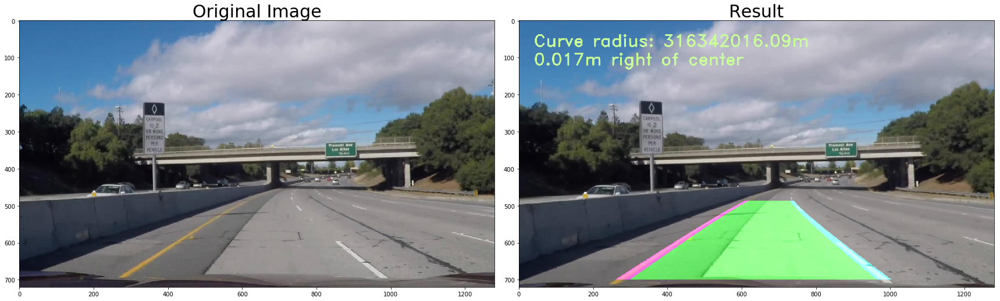

./test_images\challenge02.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 823


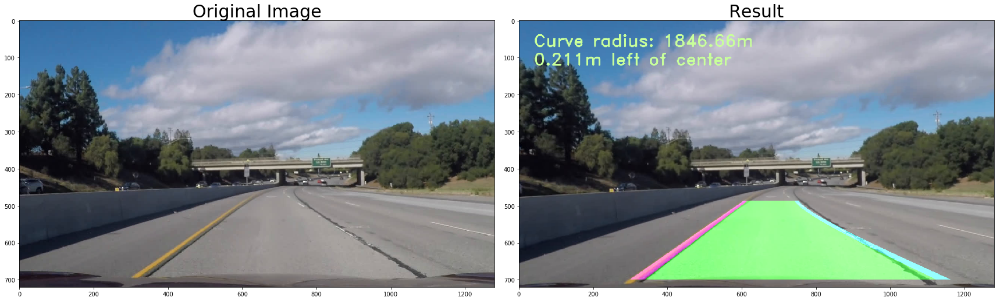

./test_images\challenge03.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 508
rightx_base = 826


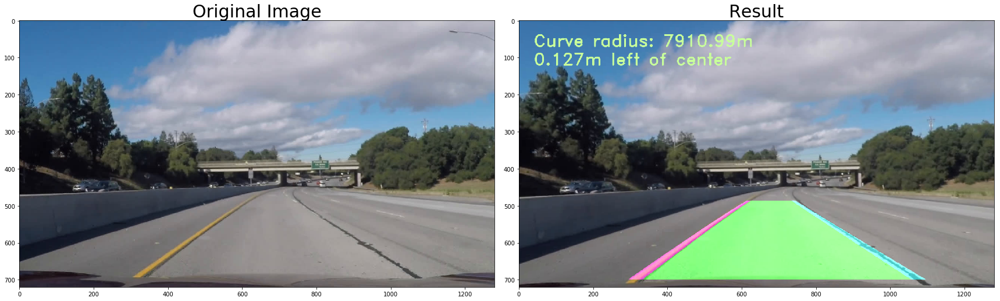

./test_images\straight_lines1.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 470
rightx_base = 822


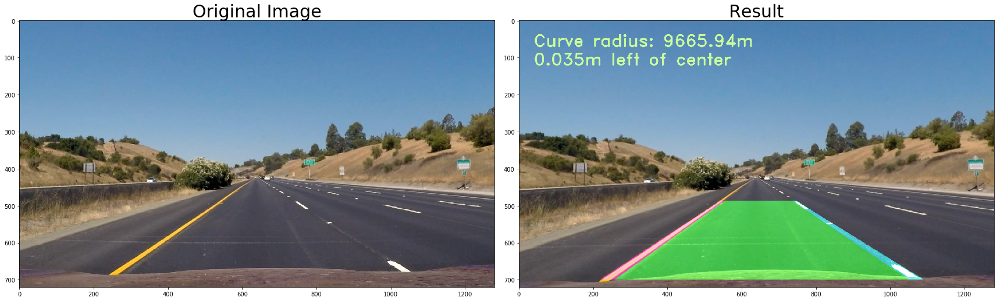

./test_images\straight_lines2.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 823


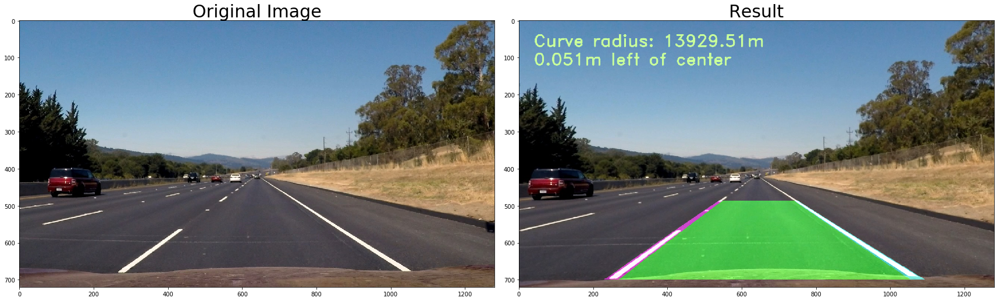

./test_images\test1.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 848


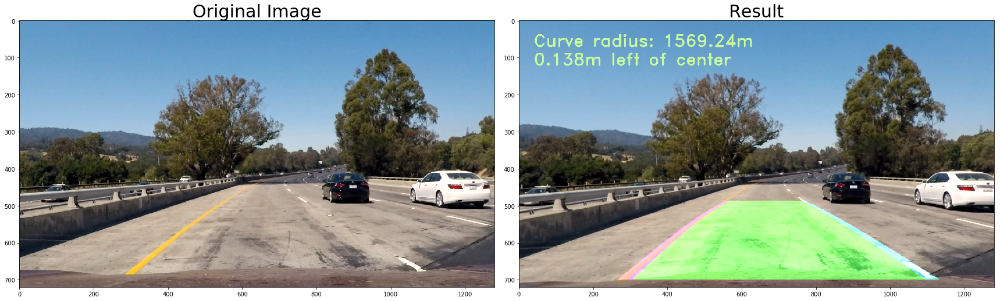

./test_images\test2.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 854


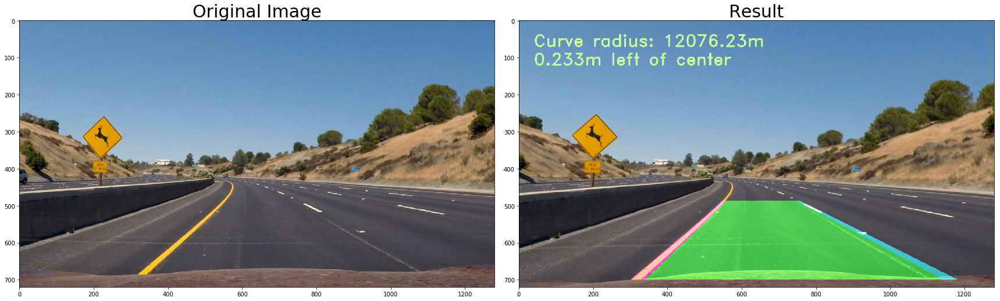

./test_images\test3.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 841


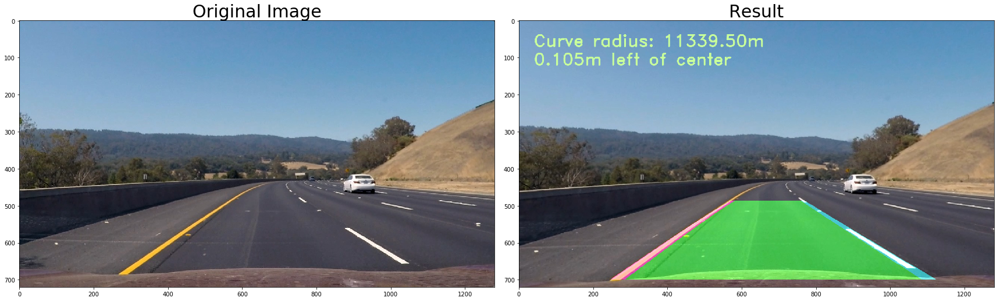

./test_images\test4.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 853


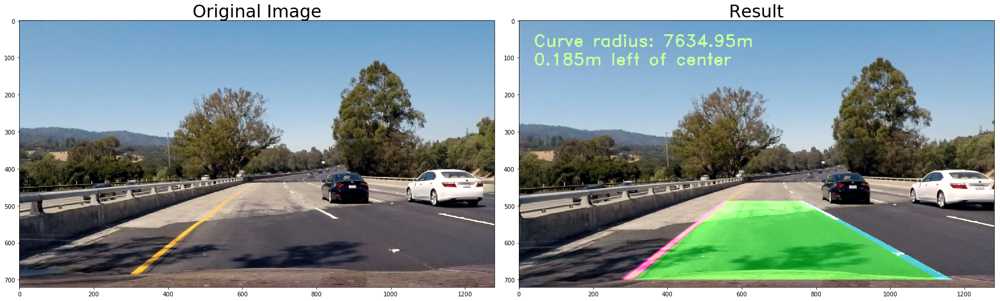

./test_images\test5.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 453
rightx_base = 836


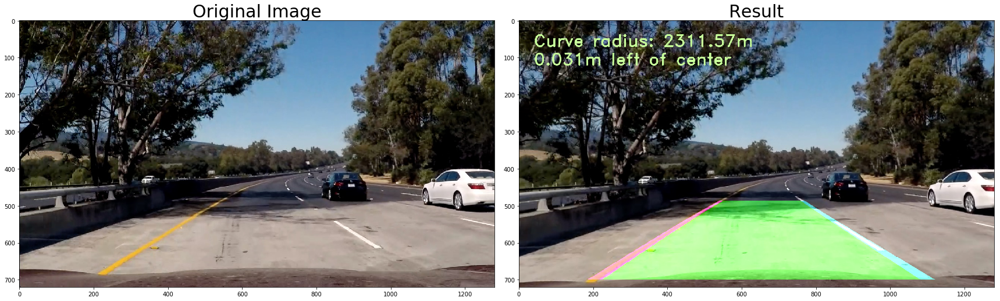

./test_images\test6.jpg
binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 856


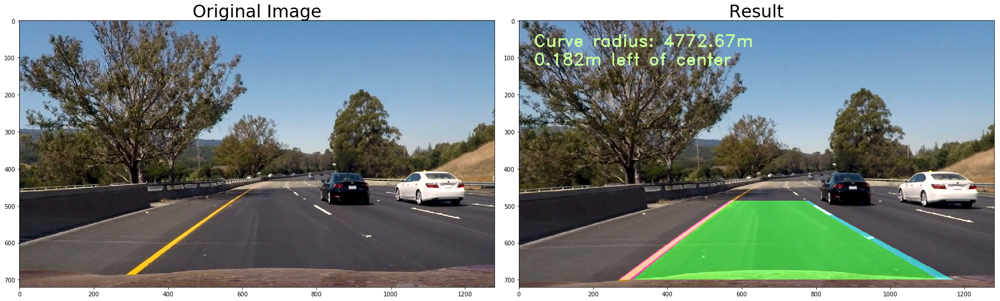

In [46]:
imagesExt = glob.glob('./test_images/*.jpg')
#imagesExt = imagesExt[3:]
print (imagesExt)

for imageExt in imagesExt:
    print (imageExt)
    image = cv2.imread(imageExt)  
#     imageExt = './test_images/straight_lines1.jpg'
#     image = cv2.imread('./test_images/straight_lines1.jpg')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    finalImage = process_image(image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(finalImage, cmap='gray')
    ax2.set_title('Result', fontsize=30)
    plt.show()


In [47]:
project_output = 'output_videos/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
# clip1 = VideoFileClip("test_videos/project_video.mp4").subclip(0,2)
clip1 = VideoFileClip("test_videos/project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(project_output, audio=False)

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 850
[MoviePy] >>>> Building video output_videos/project_video.mp4
[MoviePy] Writing video output_videos/project_video.mp4



  0%|                                                            | 0/1261 [00:00<?, ?it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 850



  0%|                                                    | 1/1261 [00:00<06:49,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 850



  0%|                                                    | 2/1261 [00:00<07:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 854



  0%|                                                    | 3/1261 [00:01<07:12,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 857



  0%|▏                                                   | 4/1261 [00:01<07:09,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 859



  0%|▏                                                   | 5/1261 [00:01<07:08,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 860



  0%|▏                                                   | 6/1261 [00:02<07:14,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 859



  1%|▎                                                   | 7/1261 [00:02<07:11,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 507
rightx_base = 847



  1%|▎                                                   | 8/1261 [00:02<07:07,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 507
rightx_base = 854



  1%|▎                                                   | 9/1261 [00:03<07:03,  2.96it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 854



  1%|▍                                                  | 10/1261 [00:03<06:58,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 841



  1%|▍                                                  | 11/1261 [00:03<06:58,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 843



  1%|▍                                                  | 12/1261 [00:04<07:00,  2.97it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 846



  1%|▌                                                  | 13/1261 [00:04<06:58,  2.98it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 847



  1%|▌                                                  | 14/1261 [00:04<06:55,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 851



  1%|▌                                                  | 15/1261 [00:04<06:55,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 851



  1%|▋                                                  | 16/1261 [00:05<06:53,  3.01it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 854



  1%|▋                                                  | 17/1261 [00:05<06:53,  3.01it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 855



  1%|▋                                                  | 18/1261 [00:05<06:50,  3.02it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 857



  2%|▊                                                  | 19/1261 [00:06<06:50,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 859



  2%|▊                                                  | 20/1261 [00:06<06:48,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 844



  2%|▊                                                  | 21/1261 [00:06<06:47,  3.04it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



  2%|▉                                                  | 22/1261 [00:07<06:46,  3.05it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 856



  2%|▉                                                  | 23/1261 [00:07<06:45,  3.05it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 835



  2%|▉                                                  | 24/1261 [00:07<06:43,  3.06it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 837



  2%|█                                                  | 25/1261 [00:08<06:42,  3.07it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 843



  2%|█                                                  | 26/1261 [00:08<06:41,  3.07it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 844



  2%|█                                                  | 27/1261 [00:08<06:41,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 850



  2%|█▏                                                 | 28/1261 [00:09<06:40,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 853



  2%|█▏                                                 | 29/1261 [00:09<06:39,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 855



  2%|█▏                                                 | 30/1261 [00:09<06:38,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 857



  2%|█▎                                                 | 31/1261 [00:10<06:37,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 854



  3%|█▎                                                 | 32/1261 [00:10<06:36,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 842



  3%|█▎                                                 | 33/1261 [00:10<06:35,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 846



  3%|█▍                                                 | 34/1261 [00:10<06:35,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 852



  3%|█▍                                                 | 35/1261 [00:11<06:34,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 856



  3%|█▍                                                 | 36/1261 [00:11<06:34,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 834



  3%|█▍                                                 | 37/1261 [00:11<06:33,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 838



  3%|█▌                                                 | 38/1261 [00:12<06:32,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 837



  3%|█▌                                                 | 39/1261 [00:12<06:31,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 842



  3%|█▌                                                 | 40/1261 [00:12<06:31,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



  3%|█▋                                                 | 41/1261 [00:13<06:30,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 850



  3%|█▋                                                 | 42/1261 [00:13<06:30,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 854



  3%|█▋                                                 | 43/1261 [00:13<06:30,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 855



  3%|█▊                                                 | 44/1261 [00:14<06:30,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 857



  4%|█▊                                                 | 45/1261 [00:14<06:29,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 846



  4%|█▊                                                 | 46/1261 [00:14<06:28,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 850



  4%|█▉                                                 | 47/1261 [00:15<06:28,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 854



  4%|█▉                                                 | 48/1261 [00:15<06:28,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 836



  4%|█▉                                                 | 49/1261 [00:15<06:27,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 839



  4%|██                                                 | 50/1261 [00:16<06:28,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 842



  4%|██                                                 | 51/1261 [00:16<06:27,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 845



  4%|██                                                 | 52/1261 [00:16<06:27,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 845



  4%|██▏                                                | 53/1261 [00:16<06:27,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



  4%|██▏                                                | 54/1261 [00:17<06:27,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 852



  4%|██▏                                                | 55/1261 [00:17<06:26,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 854



  4%|██▎                                                | 56/1261 [00:17<06:26,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 854



  5%|██▎                                                | 57/1261 [00:18<06:26,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 843



  5%|██▎                                                | 58/1261 [00:18<06:25,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 847



  5%|██▍                                                | 59/1261 [00:18<06:25,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 847



  5%|██▍                                                | 60/1261 [00:19<06:25,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 825



  5%|██▍                                                | 61/1261 [00:19<06:24,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 829



  5%|██▌                                                | 62/1261 [00:19<06:24,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 832



  5%|██▌                                                | 63/1261 [00:20<06:24,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 834



  5%|██▌                                                | 64/1261 [00:20<06:23,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 839



  5%|██▋                                                | 65/1261 [00:20<06:23,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 843



  5%|██▋                                                | 66/1261 [00:21<06:22,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 842



  5%|██▋                                                | 67/1261 [00:21<06:22,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



  5%|██▊                                                | 68/1261 [00:21<06:22,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



  5%|██▊                                                | 69/1261 [00:22<06:21,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 848



  6%|██▊                                                | 70/1261 [00:22<06:21,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 835



  6%|██▊                                                | 71/1261 [00:22<06:21,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 835



  6%|██▉                                                | 72/1261 [00:23<06:21,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



  6%|██▉                                                | 73/1261 [00:23<06:20,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 822



  6%|██▉                                                | 74/1261 [00:23<06:20,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 825



  6%|███                                                | 75/1261 [00:23<06:19,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 828



  6%|███                                                | 76/1261 [00:24<06:18,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 831



  6%|███                                                | 77/1261 [00:24<06:18,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 835



  6%|███▏                                               | 78/1261 [00:24<06:18,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 839



  6%|███▏                                               | 79/1261 [00:25<06:18,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 841



  6%|███▏                                               | 80/1261 [00:25<06:17,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 841



  6%|███▎                                               | 81/1261 [00:25<06:18,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 842



  7%|███▎                                               | 82/1261 [00:26<06:17,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 846



  7%|███▎                                               | 83/1261 [00:26<06:17,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 837



  7%|███▍                                               | 84/1261 [00:26<06:16,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 841



  7%|███▍                                               | 85/1261 [00:27<06:16,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 847



  7%|███▍                                               | 86/1261 [00:27<06:16,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 826



  7%|███▌                                               | 87/1261 [00:27<06:15,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 827



  7%|███▌                                               | 88/1261 [00:28<06:15,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 829



  7%|███▌                                               | 89/1261 [00:28<06:14,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 831



  7%|███▋                                               | 90/1261 [00:28<06:14,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 835



  7%|███▋                                               | 91/1261 [00:29<06:14,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 838



  7%|███▋                                               | 92/1261 [00:29<06:14,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 839



  7%|███▊                                               | 93/1261 [00:29<06:13,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 840



  7%|███▊                                               | 94/1261 [00:30<06:13,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 842



  8%|███▊                                               | 95/1261 [00:30<06:13,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 830



  8%|███▉                                               | 96/1261 [00:30<06:12,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 835



  8%|███▉                                               | 97/1261 [00:31<06:12,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 836



  8%|███▉                                               | 98/1261 [00:31<06:11,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 818



  8%|████                                               | 99/1261 [00:31<06:11,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 823



  8%|███▉                                              | 100/1261 [00:31<06:11,  3.13it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 826



  8%|████                                              | 101/1261 [00:32<06:11,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 828



  8%|████                                              | 102/1261 [00:32<06:11,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 832



  8%|████                                              | 103/1261 [00:33<06:11,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 835



  8%|████                                              | 104/1261 [00:33<06:11,  3.12it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 839



  8%|████▏                                             | 105/1261 [00:33<06:11,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 841



  8%|████▏                                             | 106/1261 [00:34<06:11,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 844



  8%|████▏                                             | 107/1261 [00:34<06:10,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



  9%|████▎                                             | 108/1261 [00:34<06:10,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



  9%|████▎                                             | 109/1261 [00:35<06:10,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 841



  9%|████▎                                             | 110/1261 [00:35<06:10,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 842



  9%|████▍                                             | 111/1261 [00:35<06:10,  3.11it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 831



  9%|████▍                                             | 112/1261 [00:36<06:10,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 833



  9%|████▍                                             | 113/1261 [00:36<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 837



  9%|████▌                                             | 114/1261 [00:36<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 838



  9%|████▌                                             | 115/1261 [00:37<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 839



  9%|████▌                                             | 116/1261 [00:37<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 843



  9%|████▋                                             | 117/1261 [00:37<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 847



  9%|████▋                                             | 118/1261 [00:38<06:09,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 847



  9%|████▋                                             | 119/1261 [00:38<06:08,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 850



 10%|████▊                                             | 120/1261 [00:38<06:08,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 841



 10%|████▊                                             | 121/1261 [00:39<06:08,  3.10it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 842



 10%|████▊                                             | 122/1261 [00:39<06:08,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



 10%|████▉                                             | 123/1261 [00:39<06:08,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 852



 10%|████▉                                             | 124/1261 [00:40<06:08,  3.09it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 831



 10%|████▉                                             | 125/1261 [00:40<06:08,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 835



 10%|████▉                                             | 126/1261 [00:40<06:08,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 838



 10%|█████                                             | 127/1261 [00:41<06:08,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 842



 10%|█████                                             | 128/1261 [00:41<06:07,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 844



 10%|█████                                             | 129/1261 [00:41<06:07,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 848



 10%|█████▏                                            | 130/1261 [00:42<06:07,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 850



 10%|█████▏                                            | 131/1261 [00:42<06:07,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 851



 10%|█████▏                                            | 132/1261 [00:42<06:07,  3.08it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 855



 11%|█████▎                                            | 133/1261 [00:43<06:06,  3.07it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 840



 11%|█████▎                                            | 134/1261 [00:43<06:07,  3.07it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 848



 11%|█████▎                                            | 135/1261 [00:44<06:07,  3.07it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 849



 11%|█████▍                                            | 136/1261 [00:44<06:07,  3.06it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 837



 11%|█████▍                                            | 137/1261 [00:44<06:07,  3.06it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 840



 11%|█████▍                                            | 138/1261 [00:45<06:07,  3.06it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 843



 11%|█████▌                                            | 139/1261 [00:45<06:07,  3.05it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 848



 11%|█████▌                                            | 140/1261 [00:45<06:07,  3.05it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 848



 11%|█████▌                                            | 141/1261 [00:46<06:07,  3.05it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 851



 11%|█████▋                                            | 142/1261 [00:46<06:07,  3.04it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 852



 11%|█████▋                                            | 143/1261 [00:47<06:07,  3.04it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 854



 11%|█████▋                                            | 144/1261 [00:47<06:07,  3.04it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 857



 11%|█████▋                                            | 145/1261 [00:47<06:07,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 855



 12%|█████▊                                            | 146/1261 [00:48<06:07,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 851



 12%|█████▊                                            | 147/1261 [00:48<06:07,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 851



 12%|█████▊                                            | 148/1261 [00:48<06:07,  3.03it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 855



 12%|█████▉                                            | 149/1261 [00:49<06:07,  3.02it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 834



 12%|█████▉                                            | 150/1261 [00:49<06:07,  3.02it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 838



 12%|█████▉                                            | 151/1261 [00:50<06:07,  3.02it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 842



 12%|██████                                            | 152/1261 [00:50<06:08,  3.01it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 844



 12%|██████                                            | 153/1261 [00:50<06:08,  3.01it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 846



 12%|██████                                            | 154/1261 [00:51<06:08,  3.01it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 850



 12%|██████▏                                           | 155/1261 [00:51<06:08,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 853



 12%|██████▏                                           | 156/1261 [00:51<06:08,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 853



 12%|██████▏                                           | 157/1261 [00:52<06:08,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 851



 13%|██████▎                                           | 158/1261 [00:52<06:08,  3.00it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 840



 13%|██████▎                                           | 159/1261 [00:53<06:08,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 847



 13%|██████▎                                           | 160/1261 [00:53<06:08,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 846



 13%|██████▍                                           | 161/1261 [00:53<06:08,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 837



 13%|██████▍                                           | 162/1261 [00:54<06:08,  2.99it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 838



 13%|██████▍                                           | 163/1261 [00:54<06:08,  2.98it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 838



 13%|██████▌                                           | 164/1261 [00:55<06:08,  2.98it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 840



 13%|██████▌                                           | 165/1261 [00:55<06:08,  2.98it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 845



 13%|██████▌                                           | 166/1261 [00:55<06:08,  2.97it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 848



 13%|██████▌                                           | 167/1261 [00:56<06:08,  2.97it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 849



 13%|██████▋                                           | 168/1261 [00:56<06:08,  2.97it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 852



 13%|██████▋                                           | 169/1261 [00:56<06:08,  2.97it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 852



 13%|██████▋                                           | 170/1261 [00:57<06:08,  2.96it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 836



 14%|██████▊                                           | 171/1261 [00:57<06:07,  2.96it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 843



 14%|██████▊                                           | 172/1261 [00:58<06:07,  2.96it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 843



 14%|██████▊                                           | 173/1261 [00:58<06:07,  2.96it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 825



 14%|██████▉                                           | 174/1261 [00:58<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 826



 14%|██████▉                                           | 175/1261 [00:59<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 830



 14%|██████▉                                           | 176/1261 [00:59<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 833



 14%|███████                                           | 177/1261 [00:59<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 838



 14%|███████                                           | 178/1261 [01:00<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 842



 14%|███████                                           | 179/1261 [01:00<06:07,  2.95it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 848



 14%|███████▏                                          | 180/1261 [01:01<06:07,  2.94it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 848



 14%|███████▏                                          | 181/1261 [01:01<06:07,  2.94it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 849



 14%|███████▏                                          | 182/1261 [01:01<06:06,  2.94it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 849



 15%|███████▎                                          | 183/1261 [01:02<06:06,  2.94it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 841



 15%|███████▎                                          | 184/1261 [01:02<06:06,  2.94it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 844



 15%|███████▎                                          | 185/1261 [01:03<06:06,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 828



 15%|███████▍                                          | 186/1261 [01:03<06:06,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 831



 15%|███████▍                                          | 187/1261 [01:03<06:06,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 833



 15%|███████▍                                          | 188/1261 [01:04<06:06,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 837



 15%|███████▍                                          | 189/1261 [01:04<06:06,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 840



 15%|███████▌                                          | 190/1261 [01:04<06:05,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 842



 15%|███████▌                                          | 191/1261 [01:05<06:05,  2.93it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 844



 15%|███████▌                                          | 192/1261 [01:05<06:05,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 850



 15%|███████▋                                          | 193/1261 [01:06<06:05,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 853



 15%|███████▋                                          | 194/1261 [01:06<06:05,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 853



 15%|███████▋                                          | 195/1261 [01:06<06:04,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 837



 16%|███████▊                                          | 196/1261 [01:07<06:04,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 16%|███████▊                                          | 197/1261 [01:07<06:04,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 853



 16%|███████▊                                          | 198/1261 [01:07<06:04,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 838



 16%|███████▉                                          | 199/1261 [01:08<06:04,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 841



 16%|███████▉                                          | 200/1261 [01:08<06:03,  2.92it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 842



 16%|███████▉                                          | 201/1261 [01:08<06:03,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 842



 16%|████████                                          | 202/1261 [01:09<06:03,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 844



 16%|████████                                          | 203/1261 [01:09<06:03,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 848



 16%|████████                                          | 204/1261 [01:10<06:03,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 851



 16%|████████▏                                         | 205/1261 [01:10<06:03,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 852



 16%|████████▏                                         | 206/1261 [01:10<06:02,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 852



 16%|████████▏                                         | 207/1261 [01:11<06:02,  2.91it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 833



 16%|████████▏                                         | 208/1261 [01:11<06:02,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 841



 17%|████████▎                                         | 209/1261 [01:11<06:02,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 844



 17%|████████▎                                         | 210/1261 [01:12<06:02,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 832



 17%|████████▎                                         | 211/1261 [01:12<06:02,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 834



 17%|████████▍                                         | 212/1261 [01:13<06:01,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 836



 17%|████████▍                                         | 213/1261 [01:13<06:01,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 838



 17%|████████▍                                         | 214/1261 [01:13<06:01,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 841



 17%|████████▌                                         | 215/1261 [01:14<06:01,  2.90it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 841



 17%|████████▌                                         | 216/1261 [01:14<06:01,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 843



 17%|████████▌                                         | 217/1261 [01:14<06:00,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 846



 17%|████████▋                                         | 218/1261 [01:15<06:00,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 847



 17%|████████▋                                         | 219/1261 [01:15<06:00,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 848



 17%|████████▋                                         | 220/1261 [01:16<06:00,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 835



 18%|████████▊                                         | 221/1261 [01:16<05:59,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 837



 18%|████████▊                                         | 222/1261 [01:16<05:59,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 843



 18%|████████▊                                         | 223/1261 [01:17<05:59,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 824



 18%|████████▉                                         | 224/1261 [01:17<05:59,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 826



 18%|████████▉                                         | 225/1261 [01:17<05:59,  2.89it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 828



 18%|████████▉                                         | 226/1261 [01:18<05:58,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 832



 18%|█████████                                         | 227/1261 [01:18<05:58,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 836



 18%|█████████                                         | 228/1261 [01:19<05:58,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 835



 18%|█████████                                         | 229/1261 [01:19<05:58,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 840



 18%|█████████                                         | 230/1261 [01:19<05:57,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 839



 18%|█████████▏                                        | 231/1261 [01:20<05:57,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 842



 18%|█████████▏                                        | 232/1261 [01:20<05:57,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 825



 18%|█████████▏                                        | 233/1261 [01:20<05:57,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 835



 19%|█████████▎                                        | 234/1261 [01:21<05:56,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 809



 19%|█████████▎                                        | 235/1261 [01:21<05:56,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 814



 19%|█████████▎                                        | 236/1261 [01:22<05:56,  2.88it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 818



 19%|█████████▍                                        | 237/1261 [01:22<05:56,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 820



 19%|█████████▍                                        | 238/1261 [01:22<05:56,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 824



 19%|█████████▍                                        | 239/1261 [01:23<05:55,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 828



 19%|█████████▌                                        | 240/1261 [01:23<05:55,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 831



 19%|█████████▌                                        | 241/1261 [01:23<05:55,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 833



 19%|█████████▌                                        | 242/1261 [01:24<05:54,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 833



 19%|█████████▋                                        | 243/1261 [01:24<05:54,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 834



 19%|█████████▋                                        | 244/1261 [01:25<05:54,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 822



 19%|█████████▋                                        | 245/1261 [01:25<05:54,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 825



 20%|█████████▊                                        | 246/1261 [01:25<05:53,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 829



 20%|█████████▊                                        | 247/1261 [01:26<05:53,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 810



 20%|█████████▊                                        | 248/1261 [01:26<05:53,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 815



 20%|█████████▊                                        | 249/1261 [01:26<05:53,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 818



 20%|█████████▉                                        | 250/1261 [01:27<05:52,  2.87it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 822



 20%|█████████▉                                        | 251/1261 [01:27<05:52,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 826



 20%|█████████▉                                        | 252/1261 [01:28<05:52,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 829



 20%|██████████                                        | 253/1261 [01:28<05:52,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 831



 20%|██████████                                        | 254/1261 [01:28<05:52,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 831



 20%|██████████                                        | 255/1261 [01:29<05:51,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 832



 20%|██████████▏                                       | 256/1261 [01:29<05:51,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 822



 20%|██████████▏                                       | 257/1261 [01:29<05:51,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 832



 20%|██████████▏                                       | 258/1261 [01:30<05:51,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 834



 21%|██████████▎                                       | 259/1261 [01:30<05:50,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 815



 21%|██████████▎                                       | 260/1261 [01:31<05:50,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 820



 21%|██████████▎                                       | 261/1261 [01:31<05:50,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 819



 21%|██████████▍                                       | 262/1261 [01:31<05:50,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 823



 21%|██████████▍                                       | 263/1261 [01:32<05:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 825



 21%|██████████▍                                       | 264/1261 [01:32<05:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 830



 21%|██████████▌                                       | 265/1261 [01:32<05:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 834



 21%|██████████▌                                       | 266/1261 [01:33<05:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 836



 21%|██████████▌                                       | 267/1261 [01:33<05:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 837



 21%|██████████▋                                       | 268/1261 [01:33<05:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 836



 21%|██████████▋                                       | 269/1261 [01:34<05:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 832



 21%|██████████▋                                       | 270/1261 [01:34<05:47,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 835



 21%|██████████▋                                       | 271/1261 [01:35<05:47,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 826



 22%|██████████▊                                       | 272/1261 [01:35<05:47,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 825



 22%|██████████▊                                       | 273/1261 [01:35<05:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 825



 22%|██████████▊                                       | 274/1261 [01:36<05:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 829



 22%|██████████▉                                       | 275/1261 [01:36<05:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 834



 22%|██████████▉                                       | 276/1261 [01:36<05:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 836



 22%|██████████▉                                       | 277/1261 [01:37<05:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 840



 22%|███████████                                       | 278/1261 [01:37<05:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 840



 22%|███████████                                       | 279/1261 [01:38<05:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 839



 22%|███████████                                       | 280/1261 [01:38<05:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 834



 22%|███████████▏                                      | 281/1261 [01:38<05:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 833



 22%|███████████▏                                      | 282/1261 [01:39<05:43,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 840



 22%|███████████▏                                      | 283/1261 [01:39<05:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 830



 23%|███████████▎                                      | 284/1261 [01:39<05:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 833



 23%|███████████▎                                      | 285/1261 [01:40<05:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 834



 23%|███████████▎                                      | 286/1261 [01:40<05:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 836



 23%|███████████▍                                      | 287/1261 [01:40<05:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 841



 23%|███████████▍                                      | 288/1261 [01:41<05:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 844



 23%|███████████▍                                      | 289/1261 [01:41<05:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 846



 23%|███████████▍                                      | 290/1261 [01:42<05:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 846



 23%|███████████▌                                      | 291/1261 [01:42<05:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 846



 23%|███████████▌                                      | 292/1261 [01:42<05:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 838



 23%|███████████▌                                      | 293/1261 [01:43<05:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 839



 23%|███████████▋                                      | 294/1261 [01:43<05:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 842



 23%|███████████▋                                      | 295/1261 [01:43<05:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 831



 23%|███████████▋                                      | 296/1261 [01:44<05:39,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 833



 24%|███████████▊                                      | 297/1261 [01:44<05:39,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 836



 24%|███████████▊                                      | 298/1261 [01:44<05:39,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 838



 24%|███████████▊                                      | 299/1261 [01:45<05:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 842



 24%|███████████▉                                      | 300/1261 [01:45<05:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 845



 24%|███████████▉                                      | 301/1261 [01:46<05:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 848



 24%|███████████▉                                      | 302/1261 [01:46<05:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 848



 24%|████████████                                      | 303/1261 [01:46<05:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 852



 24%|████████████                                      | 304/1261 [01:47<05:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 838



 24%|████████████                                      | 305/1261 [01:47<05:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 843



 24%|████████████▏                                     | 306/1261 [01:47<05:36,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 846



 24%|████████████▏                                     | 307/1261 [01:48<05:36,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 831



 24%|████████████▏                                     | 308/1261 [01:48<05:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 836



 25%|████████████▎                                     | 309/1261 [01:48<05:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 837



 25%|████████████▎                                     | 310/1261 [01:49<05:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 838



 25%|████████████▎                                     | 311/1261 [01:49<05:34,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 841



 25%|████████████▎                                     | 312/1261 [01:50<05:34,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 843



 25%|████████████▍                                     | 313/1261 [01:50<05:34,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 847



 25%|████████████▍                                     | 314/1261 [01:50<05:33,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 847



 25%|████████████▍                                     | 315/1261 [01:51<05:33,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 849



 25%|████████████▌                                     | 316/1261 [01:51<05:33,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 837



 25%|████████████▌                                     | 317/1261 [01:51<05:33,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 839



 25%|████████████▌                                     | 318/1261 [01:52<05:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 843



 25%|████████████▋                                     | 319/1261 [01:52<05:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 829



 25%|████████████▋                                     | 320/1261 [01:52<05:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 833



 25%|████████████▋                                     | 321/1261 [01:53<05:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 835



 26%|████████████▊                                     | 322/1261 [01:53<05:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 837



 26%|████████████▊                                     | 323/1261 [01:54<05:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 842



 26%|████████████▊                                     | 324/1261 [01:54<05:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 844



 26%|████████████▉                                     | 325/1261 [01:54<05:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 846



 26%|████████████▉                                     | 326/1261 [01:55<05:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 26%|████████████▉                                     | 327/1261 [01:55<05:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



 26%|█████████████                                     | 328/1261 [01:55<05:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 26%|█████████████                                     | 329/1261 [01:56<05:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 848



 26%|█████████████                                     | 330/1261 [01:56<05:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



 26%|█████████████                                     | 331/1261 [01:57<05:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 836



 26%|█████████████▏                                    | 332/1261 [01:57<05:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 837



 26%|█████████████▏                                    | 333/1261 [01:57<05:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 836



 26%|█████████████▏                                    | 334/1261 [01:58<05:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 839



 27%|█████████████▎                                    | 335/1261 [01:58<05:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 844



 27%|█████████████▎                                    | 336/1261 [01:58<05:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 847



 27%|█████████████▎                                    | 337/1261 [01:59<05:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 849



 27%|█████████████▍                                    | 338/1261 [01:59<05:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 849



 27%|█████████████▍                                    | 339/1261 [01:59<05:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 850



 27%|█████████████▍                                    | 340/1261 [02:00<05:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 848



 27%|█████████████▌                                    | 341/1261 [02:00<05:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 844



 27%|█████████████▌                                    | 342/1261 [02:01<05:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 847



 27%|█████████████▌                                    | 343/1261 [02:01<05:24,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 833



 27%|█████████████▋                                    | 344/1261 [02:01<05:24,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 836



 27%|█████████████▋                                    | 345/1261 [02:02<05:24,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 840



 27%|█████████████▋                                    | 346/1261 [02:02<05:23,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 840



 28%|█████████████▊                                    | 347/1261 [02:02<05:23,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 844



 28%|█████████████▊                                    | 348/1261 [02:03<05:23,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 846



 28%|█████████████▊                                    | 349/1261 [02:03<05:23,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 849



 28%|█████████████▉                                    | 350/1261 [02:03<05:22,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 850



 28%|█████████████▉                                    | 351/1261 [02:04<05:22,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 850



 28%|█████████████▉                                    | 352/1261 [02:04<05:22,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 844



 28%|█████████████▉                                    | 353/1261 [02:05<05:21,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 846



 28%|██████████████                                    | 354/1261 [02:05<05:21,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 850



 28%|██████████████                                    | 355/1261 [02:05<05:21,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 835



 28%|██████████████                                    | 356/1261 [02:06<05:20,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 842



 28%|██████████████▏                                   | 357/1261 [02:06<05:20,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 839



 28%|██████████████▏                                   | 358/1261 [02:06<05:20,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 841



 28%|██████████████▏                                   | 359/1261 [02:07<05:19,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 844



 29%|██████████████▎                                   | 360/1261 [02:07<05:19,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 846



 29%|██████████████▎                                   | 361/1261 [02:08<05:19,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 847



 29%|██████████████▎                                   | 362/1261 [02:08<05:18,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 849



 29%|██████████████▍                                   | 363/1261 [02:08<05:18,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 850



 29%|██████████████▍                                   | 364/1261 [02:09<05:18,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 844



 29%|██████████████▍                                   | 365/1261 [02:09<05:17,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 842



 29%|██████████████▌                                   | 366/1261 [02:09<05:17,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 850



 29%|██████████████▌                                   | 367/1261 [02:10<05:17,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 835



 29%|██████████████▌                                   | 368/1261 [02:10<05:16,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 837



 29%|██████████████▋                                   | 369/1261 [02:10<05:16,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 839



 29%|██████████████▋                                   | 370/1261 [02:11<05:16,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 842



 29%|██████████████▋                                   | 371/1261 [02:11<05:15,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 844



 30%|██████████████▊                                   | 372/1261 [02:11<05:15,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 30%|██████████████▊                                   | 373/1261 [02:12<05:15,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 30%|██████████████▊                                   | 374/1261 [02:12<05:14,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 848



 30%|██████████████▊                                   | 375/1261 [02:13<05:14,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



 30%|██████████████▉                                   | 376/1261 [02:13<05:14,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 839



 30%|██████████████▉                                   | 377/1261 [02:13<05:13,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 840



 30%|██████████████▉                                   | 378/1261 [02:14<05:13,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 845



 30%|███████████████                                   | 379/1261 [02:14<05:12,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 833



 30%|███████████████                                   | 380/1261 [02:14<05:12,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 835



 30%|███████████████                                   | 381/1261 [02:15<05:12,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 838



 30%|███████████████▏                                  | 382/1261 [02:15<05:11,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 839



 30%|███████████████▏                                  | 383/1261 [02:15<05:11,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 842



 30%|███████████████▏                                  | 384/1261 [02:16<05:11,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 845



 31%|███████████████▎                                  | 385/1261 [02:16<05:10,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 847



 31%|███████████████▎                                  | 386/1261 [02:16<05:10,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 848



 31%|███████████████▎                                  | 387/1261 [02:17<05:10,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 848



 31%|███████████████▍                                  | 388/1261 [02:17<05:09,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 848



 31%|███████████████▍                                  | 389/1261 [02:18<05:09,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 842



 31%|███████████████▍                                  | 390/1261 [02:18<05:09,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



 31%|███████████████▌                                  | 391/1261 [02:18<05:08,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 842



 31%|███████████████▌                                  | 392/1261 [02:19<05:08,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 835



 31%|███████████████▌                                  | 393/1261 [02:19<05:08,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 837



 31%|███████████████▌                                  | 394/1261 [02:19<05:07,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 838



 31%|███████████████▋                                  | 395/1261 [02:20<05:07,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 839



 31%|███████████████▋                                  | 396/1261 [02:20<05:07,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



 31%|███████████████▋                                  | 397/1261 [02:21<05:06,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 844



 32%|███████████████▊                                  | 398/1261 [02:21<05:06,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 845



 32%|███████████████▊                                  | 399/1261 [02:21<05:06,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 32%|███████████████▊                                  | 400/1261 [02:22<05:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 846



 32%|███████████████▉                                  | 401/1261 [02:22<05:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 848



 32%|███████████████▉                                  | 402/1261 [02:22<05:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 843



 32%|███████████████▉                                  | 403/1261 [02:23<05:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 831



 32%|████████████████                                  | 404/1261 [02:23<05:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 837



 32%|████████████████                                  | 405/1261 [02:23<05:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 837



 32%|████████████████                                  | 406/1261 [02:24<05:03,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 838



 32%|████████████████▏                                 | 407/1261 [02:24<05:03,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 839



 32%|████████████████▏                                 | 408/1261 [02:25<05:03,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 840



 32%|████████████████▏                                 | 409/1261 [02:25<05:02,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 840



 33%|████████████████▎                                 | 410/1261 [02:25<05:02,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 33%|████████████████▎                                 | 411/1261 [02:26<05:02,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 33%|████████████████▎                                 | 412/1261 [02:26<05:01,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 840



 33%|████████████████▍                                 | 413/1261 [02:26<05:01,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 834



 33%|████████████████▍                                 | 414/1261 [02:27<05:01,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 836



 33%|████████████████▍                                 | 415/1261 [02:27<05:00,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 833



 33%|████████████████▍                                 | 416/1261 [02:27<05:00,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 832



 33%|████████████████▌                                 | 417/1261 [02:28<05:00,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 828



 33%|████████████████▌                                 | 418/1261 [02:28<04:59,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 832



 33%|████████████████▌                                 | 419/1261 [02:28<04:59,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 833



 33%|████████████████▋                                 | 420/1261 [02:29<04:59,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 836



 33%|████████████████▋                                 | 421/1261 [02:29<04:58,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 836



 33%|████████████████▋                                 | 422/1261 [02:30<04:58,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 837



 34%|████████████████▊                                 | 423/1261 [02:30<04:57,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 835



 34%|████████████████▊                                 | 424/1261 [02:30<04:57,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 835



 34%|████████████████▊                                 | 425/1261 [02:31<04:57,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 828



 34%|████████████████▉                                 | 426/1261 [02:31<04:56,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 831



 34%|████████████████▉                                 | 427/1261 [02:31<04:56,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 820



 34%|████████████████▉                                 | 428/1261 [02:32<04:56,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 821



 34%|█████████████████                                 | 429/1261 [02:32<04:55,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 823



 34%|█████████████████                                 | 430/1261 [02:32<04:55,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 827



 34%|█████████████████                                 | 431/1261 [02:33<04:55,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 828



 34%|█████████████████▏                                | 432/1261 [02:33<04:54,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 830



 34%|█████████████████▏                                | 433/1261 [02:33<04:54,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 832



 34%|█████████████████▏                                | 434/1261 [02:34<04:54,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 832



 34%|█████████████████▏                                | 435/1261 [02:34<04:53,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 831



 35%|█████████████████▎                                | 436/1261 [02:35<04:53,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 824



 35%|█████████████████▎                                | 437/1261 [02:35<04:53,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 833



 35%|█████████████████▎                                | 438/1261 [02:35<04:52,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 836



 35%|█████████████████▍                                | 439/1261 [02:36<04:52,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 818



 35%|█████████████████▍                                | 440/1261 [02:36<04:51,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 825



 35%|█████████████████▍                                | 441/1261 [02:36<04:51,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 822



 35%|█████████████████▌                                | 442/1261 [02:37<04:51,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 826



 35%|█████████████████▌                                | 443/1261 [02:37<04:50,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 827



 35%|█████████████████▌                                | 444/1261 [02:37<04:50,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 829



 35%|█████████████████▋                                | 445/1261 [02:38<04:50,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 830



 35%|█████████████████▋                                | 446/1261 [02:38<04:49,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 832



 35%|█████████████████▋                                | 447/1261 [02:39<04:49,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 830



 36%|█████████████████▊                                | 448/1261 [02:39<04:49,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 825



 36%|█████████████████▊                                | 449/1261 [02:39<04:48,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 826



 36%|█████████████████▊                                | 450/1261 [02:40<04:48,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 469
rightx_base = 829



 36%|█████████████████▉                                | 451/1261 [02:40<04:48,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 819



 36%|█████████████████▉                                | 452/1261 [02:40<04:47,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 823



 36%|█████████████████▉                                | 453/1261 [02:41<04:47,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 822



 36%|██████████████████                                | 454/1261 [02:41<04:47,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 825



 36%|██████████████████                                | 455/1261 [02:41<04:46,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 827



 36%|██████████████████                                | 456/1261 [02:42<04:46,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 830



 36%|██████████████████                                | 457/1261 [02:42<04:45,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 831



 36%|██████████████████▏                               | 458/1261 [02:42<04:45,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 831



 36%|██████████████████▏                               | 459/1261 [02:43<04:45,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 830



 36%|██████████████████▏                               | 460/1261 [02:43<04:44,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 825



 37%|██████████████████▎                               | 461/1261 [02:43<04:44,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 831



 37%|██████████████████▎                               | 462/1261 [02:44<04:44,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 833



 37%|██████████████████▎                               | 463/1261 [02:44<04:43,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 827



 37%|██████████████████▍                               | 464/1261 [02:45<04:43,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 822



 37%|██████████████████▍                               | 465/1261 [02:45<04:43,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 824



 37%|██████████████████▍                               | 466/1261 [02:45<04:42,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 826



 37%|██████████████████▌                               | 467/1261 [02:46<04:42,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 828



 37%|██████████████████▌                               | 468/1261 [02:46<04:42,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 830



 37%|██████████████████▌                               | 469/1261 [02:46<04:41,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 833



 37%|██████████████████▋                               | 470/1261 [02:47<04:41,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 831



 37%|██████████████████▋                               | 471/1261 [02:47<04:40,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 831



 37%|██████████████████▋                               | 472/1261 [02:47<04:40,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 830



 38%|██████████████████▊                               | 473/1261 [02:48<04:40,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 824



 38%|██████████████████▊                               | 474/1261 [02:48<04:39,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 835



 38%|██████████████████▊                               | 475/1261 [02:48<04:39,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 819



 38%|██████████████████▊                               | 476/1261 [02:49<04:39,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 822



 38%|██████████████████▉                               | 477/1261 [02:49<04:38,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 825



 38%|██████████████████▉                               | 478/1261 [02:49<04:38,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 827



 38%|██████████████████▉                               | 479/1261 [02:50<04:38,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 830



 38%|███████████████████                               | 480/1261 [02:50<04:37,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 831



 38%|███████████████████                               | 481/1261 [02:51<04:37,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 833



 38%|███████████████████                               | 482/1261 [02:51<04:36,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 834



 38%|███████████████████▏                              | 483/1261 [02:51<04:36,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 834



 38%|███████████████████▏                              | 484/1261 [02:52<04:36,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 829



 38%|███████████████████▏                              | 485/1261 [02:52<04:35,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 829



 39%|███████████████████▎                              | 486/1261 [02:52<04:35,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 831



 39%|███████████████████▎                              | 487/1261 [02:53<04:35,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 832



 39%|███████████████████▎                              | 488/1261 [02:53<04:34,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 827



 39%|███████████████████▍                              | 489/1261 [02:53<04:34,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 828



 39%|███████████████████▍                              | 490/1261 [02:54<04:34,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 830



 39%|███████████████████▍                              | 491/1261 [02:54<04:33,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 832



 39%|███████████████████▌                              | 492/1261 [02:54<04:33,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 835



 39%|███████████████████▌                              | 493/1261 [02:55<04:33,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 839



 39%|███████████████████▌                              | 494/1261 [02:55<04:32,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 838



 39%|███████████████████▋                              | 495/1261 [02:55<04:32,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 835



 39%|███████████████████▋                              | 496/1261 [02:56<04:31,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 835



 39%|███████████████████▋                              | 497/1261 [02:56<04:31,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 835



 39%|███████████████████▋                              | 498/1261 [02:57<04:31,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 838



 40%|███████████████████▊                              | 499/1261 [02:57<04:30,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 835



 40%|███████████████████▊                              | 500/1261 [02:57<04:30,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 836



 40%|███████████████████▊                              | 501/1261 [02:58<04:30,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 835



 40%|███████████████████▉                              | 502/1261 [02:58<04:29,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 836



 40%|███████████████████▉                              | 503/1261 [02:58<04:29,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 837



 40%|███████████████████▉                              | 504/1261 [02:59<04:29,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 840



 40%|████████████████████                              | 505/1261 [02:59<04:28,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 843



 40%|████████████████████                              | 506/1261 [02:59<04:28,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 842



 40%|████████████████████                              | 507/1261 [03:00<04:28,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 841



 40%|████████████████████▏                             | 508/1261 [03:00<04:27,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 839



 40%|████████████████████▏                             | 509/1261 [03:00<04:27,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 840



 40%|████████████████████▏                             | 510/1261 [03:01<04:27,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 844



 41%|████████████████████▎                             | 511/1261 [03:01<04:26,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 829



 41%|████████████████████▎                             | 512/1261 [03:02<04:26,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 831



 41%|████████████████████▎                             | 513/1261 [03:02<04:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 829



 41%|████████████████████▍                             | 514/1261 [03:02<04:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 831



 41%|████████████████████▍                             | 515/1261 [03:03<04:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 833



 41%|████████████████████▍                             | 516/1261 [03:03<04:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 836



 41%|████████████████████▍                             | 517/1261 [03:03<04:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 835



 41%|████████████████████▌                             | 518/1261 [03:04<04:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 840



 41%|████████████████████▌                             | 519/1261 [03:04<04:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 836



 41%|████████████████████▌                             | 520/1261 [03:05<04:23,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 833



 41%|████████████████████▋                             | 521/1261 [03:05<04:23,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 836



 41%|████████████████████▋                             | 522/1261 [03:05<04:23,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 843



 41%|████████████████████▋                             | 523/1261 [03:06<04:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 833



 42%|████████████████████▊                             | 524/1261 [03:06<04:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 830



 42%|████████████████████▊                             | 525/1261 [03:07<04:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 831



 42%|████████████████████▊                             | 526/1261 [03:07<04:21,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 834



 42%|████████████████████▉                             | 527/1261 [03:07<04:21,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 837



 42%|████████████████████▉                             | 528/1261 [03:08<04:21,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 837



 42%|████████████████████▉                             | 529/1261 [03:08<04:21,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 836



 42%|█████████████████████                             | 530/1261 [03:09<04:20,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 837



 42%|█████████████████████                             | 531/1261 [03:09<04:20,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 835



 42%|█████████████████████                             | 532/1261 [03:09<04:20,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 831



 42%|█████████████████████▏                            | 533/1261 [03:10<04:19,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 834



 42%|█████████████████████▏                            | 534/1261 [03:10<04:19,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 839



 42%|█████████████████████▏                            | 535/1261 [03:10<04:19,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 835



 43%|█████████████████████▎                            | 536/1261 [03:11<04:18,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 830



 43%|█████████████████████▎                            | 537/1261 [03:11<04:18,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 833



 43%|█████████████████████▎                            | 538/1261 [03:12<04:18,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 834



 43%|█████████████████████▎                            | 539/1261 [03:12<04:18,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 836



 43%|█████████████████████▍                            | 540/1261 [03:13<04:17,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 837



 43%|█████████████████████▍                            | 541/1261 [03:13<04:17,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 838



 43%|█████████████████████▍                            | 542/1261 [03:13<04:17,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 839



 43%|█████████████████████▌                            | 543/1261 [03:14<04:16,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 840



 43%|█████████████████████▌                            | 544/1261 [03:14<04:16,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 835



 43%|█████████████████████▌                            | 545/1261 [03:14<04:16,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 831



 43%|█████████████████████▋                            | 546/1261 [03:15<04:15,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 833



 43%|█████████████████████▋                            | 547/1261 [03:15<04:15,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 830



 43%|█████████████████████▋                            | 548/1261 [03:16<04:15,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 832



 44%|█████████████████████▊                            | 549/1261 [03:16<04:14,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 838



 44%|█████████████████████▊                            | 550/1261 [03:16<04:14,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 838



 44%|█████████████████████▊                            | 551/1261 [03:17<04:14,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 840



 44%|█████████████████████▉                            | 552/1261 [03:17<04:13,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 838



 44%|█████████████████████▉                            | 553/1261 [03:17<04:13,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 840



 44%|█████████████████████▉                            | 554/1261 [03:18<04:13,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 841



 44%|██████████████████████                            | 555/1261 [03:18<04:12,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 839



 44%|██████████████████████                            | 556/1261 [03:19<04:12,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 840



 44%|██████████████████████                            | 557/1261 [03:19<04:12,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 839



 44%|██████████████████████▏                           | 558/1261 [03:19<04:11,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 843



 44%|██████████████████████▏                           | 559/1261 [03:20<04:11,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 466
rightx_base = 854



 44%|██████████████████████▏                           | 560/1261 [03:20<04:11,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 462
rightx_base = 858



 44%|██████████████████████▏                           | 561/1261 [03:20<04:10,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 461
rightx_base = 860



 45%|██████████████████████▎                           | 562/1261 [03:21<04:10,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 466
rightx_base = 852



 45%|██████████████████████▎                           | 563/1261 [03:21<04:09,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 468
rightx_base = 847



 45%|██████████████████████▎                           | 564/1261 [03:21<04:09,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 846



 45%|██████████████████████▍                           | 565/1261 [03:22<04:09,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 839



 45%|██████████████████████▍                           | 566/1261 [03:22<04:08,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 842



 45%|██████████████████████▍                           | 567/1261 [03:23<04:08,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 830



 45%|██████████████████████▌                           | 568/1261 [03:23<04:08,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 835



 45%|██████████████████████▌                           | 569/1261 [03:23<04:07,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 839



 45%|██████████████████████▌                           | 570/1261 [03:24<04:07,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 843



 45%|██████████████████████▋                           | 571/1261 [03:24<04:07,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 843



 45%|██████████████████████▋                           | 572/1261 [03:24<04:06,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 844



 45%|██████████████████████▋                           | 573/1261 [03:25<04:06,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 847



 46%|██████████████████████▊                           | 574/1261 [03:25<04:05,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 847



 46%|██████████████████████▊                           | 575/1261 [03:25<04:05,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 846



 46%|██████████████████████▊                           | 576/1261 [03:26<04:05,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 844



 46%|██████████████████████▉                           | 577/1261 [03:26<04:04,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 845



 46%|██████████████████████▉                           | 578/1261 [03:26<04:04,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 842



 46%|██████████████████████▉                           | 579/1261 [03:27<04:04,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 836



 46%|██████████████████████▉                           | 580/1261 [03:27<04:03,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 839



 46%|███████████████████████                           | 581/1261 [03:27<04:03,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 840



 46%|███████████████████████                           | 582/1261 [03:28<04:02,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 841



 46%|███████████████████████                           | 583/1261 [03:28<04:02,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 842



 46%|███████████████████████▏                          | 584/1261 [03:28<04:02,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 845



 46%|███████████████████████▏                          | 585/1261 [03:29<04:01,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 845



 46%|███████████████████████▏                          | 586/1261 [03:29<04:01,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 845



 47%|███████████████████████▎                          | 587/1261 [03:30<04:01,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 846



 47%|███████████████████████▎                          | 588/1261 [03:30<04:00,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 840



 47%|███████████████████████▎                          | 589/1261 [03:30<04:00,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 850



 47%|███████████████████████▍                          | 590/1261 [03:31<04:00,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 832



 47%|███████████████████████▍                          | 591/1261 [03:31<03:59,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 838



 47%|███████████████████████▍                          | 592/1261 [03:31<03:59,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 833



 47%|███████████████████████▌                          | 593/1261 [03:32<03:59,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 835



 47%|███████████████████████▌                          | 594/1261 [03:32<03:58,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 836



 47%|███████████████████████▌                          | 595/1261 [03:32<03:58,  2.79it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 470
rightx_base = 839



 47%|███████████████████████▋                          | 596/1261 [03:33<03:57,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 469
rightx_base = 841



 47%|███████████████████████▋                          | 597/1261 [03:33<03:57,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 469
rightx_base = 841



 47%|███████████████████████▋                          | 598/1261 [03:33<03:57,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 467
rightx_base = 840



 48%|███████████████████████▊                          | 599/1261 [03:34<03:56,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 467
rightx_base = 840



 48%|███████████████████████▊                          | 600/1261 [03:34<03:56,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 838



 48%|███████████████████████▊                          | 601/1261 [03:35<03:56,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 840



 48%|███████████████████████▊                          | 602/1261 [03:35<03:55,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 846



 48%|███████████████████████▉                          | 603/1261 [03:35<03:55,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 843



 48%|███████████████████████▉                          | 604/1261 [03:36<03:54,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 462
rightx_base = 838



 48%|███████████████████████▉                          | 605/1261 [03:36<03:54,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 836



 48%|████████████████████████                          | 606/1261 [03:36<03:54,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 834



 48%|████████████████████████                          | 607/1261 [03:37<03:53,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 461
rightx_base = 836



 48%|████████████████████████                          | 608/1261 [03:37<03:53,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 837



 48%|████████████████████████▏                         | 609/1261 [03:37<03:53,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 836



 48%|████████████████████████▏                         | 610/1261 [03:38<03:52,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 835



 48%|████████████████████████▏                         | 611/1261 [03:38<03:52,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 835



 49%|████████████████████████▎                         | 612/1261 [03:38<03:52,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 826



 49%|████████████████████████▎                         | 613/1261 [03:39<03:51,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 828



 49%|████████████████████████▎                         | 614/1261 [03:39<03:51,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 829



 49%|████████████████████████▍                         | 615/1261 [03:39<03:50,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 829



 49%|████████████████████████▍                         | 616/1261 [03:40<03:50,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 819



 49%|████████████████████████▍                         | 617/1261 [03:40<03:50,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 456
rightx_base = 822



 49%|████████████████████████▌                         | 618/1261 [03:40<03:49,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 822



 49%|████████████████████████▌                         | 619/1261 [03:41<03:49,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 814



 49%|████████████████████████▌                         | 620/1261 [03:41<03:49,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 817



 49%|████████████████████████▌                         | 621/1261 [03:42<03:48,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 456
rightx_base = 818



 49%|████████████████████████▋                         | 622/1261 [03:42<03:48,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 827



 49%|████████████████████████▋                         | 623/1261 [03:42<03:48,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 456
rightx_base = 824



 49%|████████████████████████▋                         | 624/1261 [03:43<03:47,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 822



 50%|████████████████████████▊                         | 625/1261 [03:43<03:47,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 825



 50%|████████████████████████▊                         | 626/1261 [03:43<03:46,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 825



 50%|████████████████████████▊                         | 627/1261 [03:44<03:46,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 824



 50%|████████████████████████▉                         | 628/1261 [03:44<03:46,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 470
rightx_base = 828



 50%|████████████████████████▉                         | 629/1261 [03:44<03:45,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 468
rightx_base = 835



 50%|████████████████████████▉                         | 630/1261 [03:45<03:45,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 836



 50%|█████████████████████████                         | 631/1261 [03:45<03:45,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 844



 50%|█████████████████████████                         | 632/1261 [03:45<03:44,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 837



 50%|█████████████████████████                         | 633/1261 [03:46<03:44,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 834



 50%|█████████████████████████▏                        | 634/1261 [03:46<03:44,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 465
rightx_base = 830



 50%|█████████████████████████▏                        | 635/1261 [03:46<03:43,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 828



 50%|█████████████████████████▏                        | 636/1261 [03:47<03:43,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 828



 51%|█████████████████████████▎                        | 637/1261 [03:47<03:42,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 834



 51%|█████████████████████████▎                        | 638/1261 [03:47<03:42,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 831



 51%|█████████████████████████▎                        | 639/1261 [03:48<03:42,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 839



 51%|█████████████████████████▍                        | 640/1261 [03:48<03:41,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 839



 51%|█████████████████████████▍                        | 641/1261 [03:49<03:41,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 839



 51%|█████████████████████████▍                        | 642/1261 [03:49<03:41,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 838



 51%|█████████████████████████▍                        | 643/1261 [03:49<03:40,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 838



 51%|█████████████████████████▌                        | 644/1261 [03:50<03:40,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 839



 51%|█████████████████████████▌                        | 645/1261 [03:50<03:40,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 838



 51%|█████████████████████████▌                        | 646/1261 [03:50<03:39,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 841



 51%|█████████████████████████▋                        | 647/1261 [03:51<03:39,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 51%|█████████████████████████▋                        | 648/1261 [03:51<03:39,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 838



 51%|█████████████████████████▋                        | 649/1261 [03:51<03:38,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 839



 52%|█████████████████████████▊                        | 650/1261 [03:52<03:38,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 839



 52%|█████████████████████████▊                        | 651/1261 [03:52<03:37,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 842



 52%|█████████████████████████▊                        | 652/1261 [03:52<03:37,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 839



 52%|█████████████████████████▉                        | 653/1261 [03:53<03:37,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 838



 52%|█████████████████████████▉                        | 654/1261 [03:53<03:36,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 837



 52%|█████████████████████████▉                        | 655/1261 [03:54<03:36,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



 52%|██████████████████████████                        | 656/1261 [03:54<03:36,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 840



 52%|██████████████████████████                        | 657/1261 [03:54<03:35,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 840



 52%|██████████████████████████                        | 658/1261 [03:55<03:35,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 835



 52%|██████████████████████████▏                       | 659/1261 [03:55<03:35,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 835



 52%|██████████████████████████▏                       | 660/1261 [03:55<03:34,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 838



 52%|██████████████████████████▏                       | 661/1261 [03:56<03:34,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 838



 52%|██████████████████████████▏                       | 662/1261 [03:56<03:33,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 839



 53%|██████████████████████████▎                       | 663/1261 [03:56<03:33,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 843



 53%|██████████████████████████▎                       | 664/1261 [03:57<03:33,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



 53%|██████████████████████████▎                       | 665/1261 [03:57<03:32,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 843



 53%|██████████████████████████▍                       | 666/1261 [03:57<03:32,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 845



 53%|██████████████████████████▍                       | 667/1261 [03:58<03:32,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 844



 53%|██████████████████████████▍                       | 668/1261 [03:58<03:31,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 845



 53%|██████████████████████████▌                       | 669/1261 [03:58<03:31,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 844



 53%|██████████████████████████▌                       | 670/1261 [03:59<03:30,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 840



 53%|██████████████████████████▌                       | 671/1261 [03:59<03:30,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 840



 53%|██████████████████████████▋                       | 672/1261 [03:59<03:30,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 840



 53%|██████████████████████████▋                       | 673/1261 [04:00<03:29,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 842



 53%|██████████████████████████▋                       | 674/1261 [04:00<03:29,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 846



 54%|██████████████████████████▊                       | 675/1261 [04:00<03:28,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 844



 54%|██████████████████████████▊                       | 676/1261 [04:01<03:28,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 845



 54%|██████████████████████████▊                       | 677/1261 [04:01<03:28,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 844



 54%|██████████████████████████▉                       | 678/1261 [04:01<03:27,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 841



 54%|██████████████████████████▉                       | 679/1261 [04:02<03:27,  2.80it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 840



 54%|██████████████████████████▉                       | 680/1261 [04:02<03:27,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 844



 54%|███████████████████████████                       | 681/1261 [04:02<03:26,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 844



 54%|███████████████████████████                       | 682/1261 [04:03<03:26,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 843



 54%|███████████████████████████                       | 683/1261 [04:03<03:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 840



 54%|███████████████████████████                       | 684/1261 [04:03<03:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 841



 54%|███████████████████████████▏                      | 685/1261 [04:04<03:25,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 842



 54%|███████████████████████████▏                      | 686/1261 [04:04<03:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 843



 54%|███████████████████████████▏                      | 687/1261 [04:04<03:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 845



 55%|███████████████████████████▎                      | 688/1261 [04:05<03:24,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 845



 55%|███████████████████████████▎                      | 689/1261 [04:05<03:23,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 846



 55%|███████████████████████████▎                      | 690/1261 [04:05<03:23,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 845



 55%|███████████████████████████▍                      | 691/1261 [04:06<03:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 842



 55%|███████████████████████████▍                      | 692/1261 [04:06<03:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 850



 55%|███████████████████████████▍                      | 693/1261 [04:06<03:22,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 842



 55%|███████████████████████████▌                      | 694/1261 [04:07<03:21,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 843



 55%|███████████████████████████▌                      | 695/1261 [04:07<03:21,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 838



 55%|███████████████████████████▌                      | 696/1261 [04:07<03:21,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 838



 55%|███████████████████████████▋                      | 697/1261 [04:08<03:20,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 842



 55%|███████████████████████████▋                      | 698/1261 [04:08<03:20,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 842



 55%|███████████████████████████▋                      | 699/1261 [04:08<03:19,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 842



 56%|███████████████████████████▊                      | 700/1261 [04:09<03:19,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 843



 56%|███████████████████████████▊                      | 701/1261 [04:09<03:19,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 841



 56%|███████████████████████████▊                      | 702/1261 [04:09<03:18,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 841



 56%|███████████████████████████▊                      | 703/1261 [04:10<03:18,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 842



 56%|███████████████████████████▉                      | 704/1261 [04:10<03:18,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 844



 56%|███████████████████████████▉                      | 705/1261 [04:10<03:17,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 840



 56%|███████████████████████████▉                      | 706/1261 [04:11<03:17,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 836



 56%|████████████████████████████                      | 707/1261 [04:11<03:17,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 838



 56%|████████████████████████████                      | 708/1261 [04:11<03:16,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 839



 56%|████████████████████████████                      | 709/1261 [04:12<03:16,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 840



 56%|████████████████████████████▏                     | 710/1261 [04:12<03:16,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 839



 56%|████████████████████████████▏                     | 711/1261 [04:13<03:15,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 841



 56%|████████████████████████████▏                     | 712/1261 [04:13<03:15,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 842



 57%|████████████████████████████▎                     | 713/1261 [04:13<03:14,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 840



 57%|████████████████████████████▎                     | 714/1261 [04:14<03:14,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 838



 57%|████████████████████████████▎                     | 715/1261 [04:14<03:14,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 956



 57%|████████████████████████████▍                     | 716/1261 [04:14<03:13,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 957



 57%|████████████████████████████▍                     | 717/1261 [04:15<03:13,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 957



 57%|████████████████████████████▍                     | 718/1261 [04:15<03:13,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 841



 57%|████████████████████████████▌                     | 719/1261 [04:15<03:12,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 838



 57%|████████████████████████████▌                     | 720/1261 [04:16<03:12,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 838



 57%|████████████████████████████▌                     | 721/1261 [04:16<03:12,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 839



 57%|████████████████████████████▋                     | 722/1261 [04:16<03:11,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 841



 57%|████████████████████████████▋                     | 723/1261 [04:17<03:11,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 845



 57%|████████████████████████████▋                     | 724/1261 [04:17<03:10,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 846



 57%|████████████████████████████▋                     | 725/1261 [04:17<03:10,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 844



 58%|████████████████████████████▊                     | 726/1261 [04:18<03:10,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 845



 58%|████████████████████████████▊                     | 727/1261 [04:18<03:09,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 846



 58%|████████████████████████████▊                     | 728/1261 [04:18<03:09,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 850



 58%|████████████████████████████▉                     | 729/1261 [04:19<03:09,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 849



 58%|████████████████████████████▉                     | 730/1261 [04:19<03:08,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 849



 58%|████████████████████████████▉                     | 731/1261 [04:19<03:08,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 844



 58%|█████████████████████████████                     | 732/1261 [04:20<03:08,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 507
rightx_base = 842



 58%|█████████████████████████████                     | 733/1261 [04:20<03:07,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



 58%|█████████████████████████████                     | 734/1261 [04:20<03:07,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



 58%|█████████████████████████████▏                    | 735/1261 [04:21<03:06,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 849



 58%|█████████████████████████████▏                    | 736/1261 [04:21<03:06,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 848



 58%|█████████████████████████████▏                    | 737/1261 [04:21<03:06,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 850



 59%|█████████████████████████████▎                    | 738/1261 [04:22<03:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 848



 59%|█████████████████████████████▎                    | 739/1261 [04:22<03:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 849



 59%|█████████████████████████████▎                    | 740/1261 [04:22<03:05,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 850



 59%|█████████████████████████████▍                    | 741/1261 [04:23<03:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 849



 59%|█████████████████████████████▍                    | 742/1261 [04:23<03:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 850



 59%|█████████████████████████████▍                    | 743/1261 [04:24<03:04,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 849



 59%|█████████████████████████████▌                    | 744/1261 [04:24<03:03,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 845



 59%|█████████████████████████████▌                    | 745/1261 [04:24<03:03,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 851



 59%|█████████████████████████████▌                    | 746/1261 [04:25<03:02,  2.81it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 851



 59%|█████████████████████████████▌                    | 747/1261 [04:25<03:02,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 853



 59%|█████████████████████████████▋                    | 748/1261 [04:25<03:02,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 855



 59%|█████████████████████████████▋                    | 749/1261 [04:26<03:01,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 508
rightx_base = 853



 59%|█████████████████████████████▋                    | 750/1261 [04:26<03:01,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 857



 60%|█████████████████████████████▊                    | 751/1261 [04:26<03:01,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 857



 60%|█████████████████████████████▊                    | 752/1261 [04:27<03:00,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 854



 60%|█████████████████████████████▊                    | 753/1261 [04:27<03:00,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 843



 60%|█████████████████████████████▉                    | 754/1261 [04:27<03:00,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 857



 60%|█████████████████████████████▉                    | 755/1261 [04:28<02:59,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 858



 60%|█████████████████████████████▉                    | 756/1261 [04:28<02:59,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 855



 60%|██████████████████████████████                    | 757/1261 [04:28<02:58,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 862



 60%|██████████████████████████████                    | 758/1261 [04:29<02:58,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 863



 60%|██████████████████████████████                    | 759/1261 [04:29<02:58,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 859



 60%|██████████████████████████████▏                   | 760/1261 [04:29<02:57,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 859



 60%|██████████████████████████████▏                   | 761/1261 [04:30<02:57,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 860



 60%|██████████████████████████████▏                   | 762/1261 [04:30<02:57,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 861



 61%|██████████████████████████████▎                   | 763/1261 [04:30<02:56,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 865



 61%|██████████████████████████████▎                   | 764/1261 [04:31<02:56,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 867



 61%|██████████████████████████████▎                   | 765/1261 [04:31<02:56,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 862



 61%|██████████████████████████████▎                   | 766/1261 [04:31<02:55,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 864



 61%|██████████████████████████████▍                   | 767/1261 [04:32<02:55,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 867



 61%|██████████████████████████████▍                   | 768/1261 [04:32<02:54,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 860



 61%|██████████████████████████████▍                   | 769/1261 [04:32<02:54,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 864



 61%|██████████████████████████████▌                   | 770/1261 [04:33<02:54,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 864



 61%|██████████████████████████████▌                   | 771/1261 [04:33<02:53,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 866



 61%|██████████████████████████████▌                   | 772/1261 [04:33<02:53,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 866



 61%|██████████████████████████████▋                   | 773/1261 [04:34<02:53,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 867



 61%|██████████████████████████████▋                   | 774/1261 [04:34<02:52,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 869



 61%|██████████████████████████████▋                   | 775/1261 [04:34<02:52,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 869



 62%|██████████████████████████████▊                   | 776/1261 [04:35<02:51,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 870



 62%|██████████████████████████████▊                   | 777/1261 [04:35<02:51,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 870



 62%|██████████████████████████████▊                   | 778/1261 [04:35<02:51,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 523
rightx_base = 869



 62%|██████████████████████████████▉                   | 779/1261 [04:36<02:50,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 863



 62%|██████████████████████████████▉                   | 780/1261 [04:36<02:50,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 870



 62%|██████████████████████████████▉                   | 781/1261 [04:36<02:50,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 868



 62%|███████████████████████████████                   | 782/1261 [04:37<02:49,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 868



 62%|███████████████████████████████                   | 783/1261 [04:37<02:49,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 869



 62%|███████████████████████████████                   | 784/1261 [04:37<02:49,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 872



 62%|███████████████████████████████▏                  | 785/1261 [04:38<02:48,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 872



 62%|███████████████████████████████▏                  | 786/1261 [04:38<02:48,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 873



 62%|███████████████████████████████▏                  | 787/1261 [04:38<02:48,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 872



 62%|███████████████████████████████▏                  | 788/1261 [04:39<02:47,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 868



 63%|███████████████████████████████▎                  | 789/1261 [04:39<02:47,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 875



 63%|███████████████████████████████▎                  | 790/1261 [04:39<02:46,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 866



 63%|███████████████████████████████▎                  | 791/1261 [04:40<02:46,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 861



 63%|███████████████████████████████▍                  | 792/1261 [04:40<02:46,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 861



 63%|███████████████████████████████▍                  | 793/1261 [04:40<02:45,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 862



 63%|███████████████████████████████▍                  | 794/1261 [04:41<02:45,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 863



 63%|███████████████████████████████▌                  | 795/1261 [04:41<02:45,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 864



 63%|███████████████████████████████▌                  | 796/1261 [04:42<02:44,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 521
rightx_base = 866



 63%|███████████████████████████████▌                  | 797/1261 [04:42<02:44,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 522
rightx_base = 864



 63%|███████████████████████████████▋                  | 798/1261 [04:42<02:43,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 865



 63%|███████████████████████████████▋                  | 799/1261 [04:42<02:43,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 859



 63%|███████████████████████████████▋                  | 800/1261 [04:43<02:43,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 866



 64%|███████████████████████████████▊                  | 801/1261 [04:43<02:42,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 865



 64%|███████████████████████████████▊                  | 802/1261 [04:44<02:42,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 865



 64%|███████████████████████████████▊                  | 803/1261 [04:44<02:42,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 857



 64%|███████████████████████████████▉                  | 804/1261 [04:44<02:41,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 856



 64%|███████████████████████████████▉                  | 805/1261 [04:45<02:41,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 520
rightx_base = 857



 64%|███████████████████████████████▉                  | 806/1261 [04:45<02:41,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 860



 64%|███████████████████████████████▉                  | 807/1261 [04:45<02:40,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 862



 64%|████████████████████████████████                  | 808/1261 [04:46<02:40,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 862



 64%|████████████████████████████████                  | 809/1261 [04:46<02:40,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 864



 64%|████████████████████████████████                  | 810/1261 [04:46<02:39,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 865



 64%|████████████████████████████████▏                 | 811/1261 [04:47<02:39,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 859



 64%|████████████████████████████████▏                 | 812/1261 [04:47<02:38,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 861



 64%|████████████████████████████████▏                 | 813/1261 [04:47<02:38,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 862



 65%|████████████████████████████████▎                 | 814/1261 [04:48<02:38,  2.82it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 856



 65%|████████████████████████████████▎                 | 815/1261 [04:48<02:37,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 854



 65%|████████████████████████████████▎                 | 816/1261 [04:48<02:37,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 854



 65%|████████████████████████████████▍                 | 817/1261 [04:49<02:37,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 511
rightx_base = 855



 65%|████████████████████████████████▍                 | 818/1261 [04:49<02:36,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 858



 65%|████████████████████████████████▍                 | 819/1261 [04:49<02:36,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 859



 65%|████████████████████████████████▌                 | 820/1261 [04:50<02:36,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 859



 65%|████████████████████████████████▌                 | 821/1261 [04:50<02:35,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 862



 65%|████████████████████████████████▌                 | 822/1261 [04:50<02:35,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 853



 65%|████████████████████████████████▋                 | 823/1261 [04:51<02:35,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 848



 65%|████████████████████████████████▋                 | 824/1261 [04:51<02:34,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 851



 65%|████████████████████████████████▋                 | 825/1261 [04:52<02:34,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 842



 66%|████████████████████████████████▊                 | 826/1261 [04:52<02:33,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 845



 66%|████████████████████████████████▊                 | 827/1261 [04:52<02:33,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 841



 66%|████████████████████████████████▊                 | 828/1261 [04:53<02:33,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 843



 66%|████████████████████████████████▊                 | 829/1261 [04:53<02:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 844



 66%|████████████████████████████████▉                 | 830/1261 [04:53<02:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 847



 66%|████████████████████████████████▉                 | 831/1261 [04:54<02:32,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 848



 66%|████████████████████████████████▉                 | 832/1261 [04:54<02:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 850



 66%|█████████████████████████████████                 | 833/1261 [04:54<02:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 845



 66%|█████████████████████████████████                 | 834/1261 [04:55<02:31,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 840



 66%|█████████████████████████████████                 | 835/1261 [04:55<02:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 842



 66%|█████████████████████████████████▏                | 836/1261 [04:55<02:30,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 846



 66%|█████████████████████████████████▏                | 837/1261 [04:56<02:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 844



 66%|█████████████████████████████████▏                | 838/1261 [04:56<02:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 843



 67%|█████████████████████████████████▎                | 839/1261 [04:56<02:29,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 835



 67%|█████████████████████████████████▎                | 840/1261 [04:57<02:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 837



 67%|█████████████████████████████████▎                | 841/1261 [04:57<02:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 67%|█████████████████████████████████▍                | 842/1261 [04:57<02:28,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 842



 67%|█████████████████████████████████▍                | 843/1261 [04:58<02:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 67%|█████████████████████████████████▍                | 844/1261 [04:58<02:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 843



 67%|█████████████████████████████████▌                | 845/1261 [04:58<02:27,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 838



 67%|█████████████████████████████████▌                | 846/1261 [04:59<02:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 840



 67%|█████████████████████████████████▌                | 847/1261 [04:59<02:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 842



 67%|█████████████████████████████████▌                | 848/1261 [04:59<02:26,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 842



 67%|█████████████████████████████████▋                | 849/1261 [05:00<02:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 840



 67%|█████████████████████████████████▋                | 850/1261 [05:00<02:25,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 835



 67%|█████████████████████████████████▋                | 851/1261 [05:00<02:24,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 838



 68%|█████████████████████████████████▊                | 852/1261 [05:01<02:24,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 837



 68%|█████████████████████████████████▊                | 853/1261 [05:01<02:24,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 841



 68%|█████████████████████████████████▊                | 854/1261 [05:02<02:23,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 840



 68%|█████████████████████████████████▉                | 855/1261 [05:02<02:23,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 844



 68%|█████████████████████████████████▉                | 856/1261 [05:02<02:23,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 844



 68%|█████████████████████████████████▉                | 857/1261 [05:03<02:22,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 844



 68%|██████████████████████████████████                | 858/1261 [05:03<02:22,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 844



 68%|██████████████████████████████████                | 859/1261 [05:03<02:22,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 840



 68%|██████████████████████████████████                | 860/1261 [05:04<02:21,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 843



 68%|██████████████████████████████████▏               | 861/1261 [05:04<02:21,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 840



 68%|██████████████████████████████████▏               | 862/1261 [05:04<02:21,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 836



 68%|██████████████████████████████████▏               | 863/1261 [05:05<02:20,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 837



 69%|██████████████████████████████████▎               | 864/1261 [05:05<02:20,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 843



 69%|██████████████████████████████████▎               | 865/1261 [05:05<02:19,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 839



 69%|██████████████████████████████████▎               | 866/1261 [05:06<02:19,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 843



 69%|██████████████████████████████████▍               | 867/1261 [05:06<02:19,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 840



 69%|██████████████████████████████████▍               | 868/1261 [05:06<02:18,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 840



 69%|██████████████████████████████████▍               | 869/1261 [05:07<02:18,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 840



 69%|██████████████████████████████████▍               | 870/1261 [05:07<02:18,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 846



 69%|██████████████████████████████████▌               | 871/1261 [05:07<02:17,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 843



 69%|██████████████████████████████████▌               | 872/1261 [05:08<02:17,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 842



 69%|██████████████████████████████████▌               | 873/1261 [05:08<02:17,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 477
rightx_base = 842



 69%|██████████████████████████████████▋               | 874/1261 [05:08<02:16,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 840



 69%|██████████████████████████████████▋               | 875/1261 [05:09<02:16,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 845



 69%|██████████████████████████████████▋               | 876/1261 [05:09<02:16,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 845



 70%|██████████████████████████████████▊               | 877/1261 [05:09<02:15,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 845



 70%|██████████████████████████████████▊               | 878/1261 [05:10<02:15,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 844



 70%|██████████████████████████████████▊               | 879/1261 [05:10<02:14,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 845



 70%|██████████████████████████████████▉               | 880/1261 [05:10<02:14,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 844



 70%|██████████████████████████████████▉               | 881/1261 [05:11<02:14,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 844



 70%|██████████████████████████████████▉               | 882/1261 [05:11<02:13,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 847



 70%|███████████████████████████████████               | 883/1261 [05:11<02:13,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 844



 70%|███████████████████████████████████               | 884/1261 [05:12<02:13,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 478
rightx_base = 842



 70%|███████████████████████████████████               | 885/1261 [05:12<02:12,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 840



 70%|███████████████████████████████████▏              | 886/1261 [05:12<02:12,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 840



 70%|███████████████████████████████████▏              | 887/1261 [05:13<02:12,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 840



 70%|███████████████████████████████████▏              | 888/1261 [05:13<02:11,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 839



 70%|███████████████████████████████████▏              | 889/1261 [05:13<02:11,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 842



 71%|███████████████████████████████████▎              | 890/1261 [05:14<02:11,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 842



 71%|███████████████████████████████████▎              | 891/1261 [05:14<02:10,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 844



 71%|███████████████████████████████████▎              | 892/1261 [05:15<02:10,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 844



 71%|███████████████████████████████████▍              | 893/1261 [05:15<02:09,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 848



 71%|███████████████████████████████████▍              | 894/1261 [05:15<02:09,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 845



 71%|███████████████████████████████████▍              | 895/1261 [05:15<02:09,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 849



 71%|███████████████████████████████████▌              | 896/1261 [05:16<02:08,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 71%|███████████████████████████████████▌              | 897/1261 [05:16<02:08,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 844



 71%|███████████████████████████████████▌              | 898/1261 [05:17<02:08,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 844



 71%|███████████████████████████████████▋              | 899/1261 [05:17<02:07,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 845



 71%|███████████████████████████████████▋              | 900/1261 [05:17<02:07,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 843



 71%|███████████████████████████████████▋              | 901/1261 [05:18<02:07,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 843



 72%|███████████████████████████████████▊              | 902/1261 [05:18<02:06,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 845



 72%|███████████████████████████████████▊              | 903/1261 [05:18<02:06,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 72%|███████████████████████████████████▊              | 904/1261 [05:19<02:06,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 847



 72%|███████████████████████████████████▉              | 905/1261 [05:19<02:05,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 852



 72%|███████████████████████████████████▉              | 906/1261 [05:19<02:05,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 853



 72%|███████████████████████████████████▉              | 907/1261 [05:20<02:04,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 852



 72%|████████████████████████████████████              | 908/1261 [05:20<02:04,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 72%|████████████████████████████████████              | 909/1261 [05:20<02:04,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 72%|████████████████████████████████████              | 910/1261 [05:21<02:03,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 841



 72%|████████████████████████████████████              | 911/1261 [05:21<02:03,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 841



 72%|████████████████████████████████████▏             | 912/1261 [05:21<02:03,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 842



 72%|████████████████████████████████████▏             | 913/1261 [05:22<02:02,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 841



 72%|████████████████████████████████████▏             | 914/1261 [05:22<02:02,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 841



 73%|████████████████████████████████████▎             | 915/1261 [05:22<02:02,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 844



 73%|████████████████████████████████████▎             | 916/1261 [05:23<02:01,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 846



 73%|████████████████████████████████████▎             | 917/1261 [05:23<02:01,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 838



 73%|████████████████████████████████████▍             | 918/1261 [05:23<02:01,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 837



 73%|████████████████████████████████████▍             | 919/1261 [05:24<02:00,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 840



 73%|████████████████████████████████████▍             | 920/1261 [05:24<02:00,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 840



 73%|████████████████████████████████████▌             | 921/1261 [05:25<01:59,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 836



 73%|████████████████████████████████████▌             | 922/1261 [05:25<01:59,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 836



 73%|████████████████████████████████████▌             | 923/1261 [05:25<01:59,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 837



 73%|████████████████████████████████████▋             | 924/1261 [05:26<01:58,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 839



 73%|████████████████████████████████████▋             | 925/1261 [05:26<01:58,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 840



 73%|████████████████████████████████████▋             | 926/1261 [05:26<01:58,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 838



 74%|████████████████████████████████████▊             | 927/1261 [05:27<01:57,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 479
rightx_base = 844



 74%|████████████████████████████████████▊             | 928/1261 [05:27<01:57,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 845



 74%|████████████████████████████████████▊             | 929/1261 [05:27<01:57,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 844



 74%|████████████████████████████████████▉             | 930/1261 [05:28<01:56,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 839



 74%|████████████████████████████████████▉             | 931/1261 [05:28<01:56,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 844



 74%|████████████████████████████████████▉             | 932/1261 [05:28<01:56,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 842



 74%|████████████████████████████████████▉             | 933/1261 [05:29<01:55,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 839



 74%|█████████████████████████████████████             | 934/1261 [05:29<01:55,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 841



 74%|█████████████████████████████████████             | 935/1261 [05:29<01:55,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 841



 74%|█████████████████████████████████████             | 936/1261 [05:30<01:54,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 844



 74%|█████████████████████████████████████▏            | 937/1261 [05:30<01:54,  2.83it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 844



 74%|█████████████████████████████████████▏            | 938/1261 [05:30<01:53,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 842



 74%|█████████████████████████████████████▏            | 939/1261 [05:31<01:53,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 843



 75%|█████████████████████████████████████▎            | 940/1261 [05:31<01:53,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 843



 75%|█████████████████████████████████████▎            | 941/1261 [05:31<01:52,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 844



 75%|█████████████████████████████████████▎            | 942/1261 [05:32<01:52,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 841



 75%|█████████████████████████████████████▍            | 943/1261 [05:32<01:52,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 844



 75%|█████████████████████████████████████▍            | 944/1261 [05:32<01:51,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 838



 75%|█████████████████████████████████████▍            | 945/1261 [05:33<01:51,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 837



 75%|█████████████████████████████████████▌            | 946/1261 [05:33<01:51,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 844



 75%|█████████████████████████████████████▌            | 947/1261 [05:33<01:50,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 842



 75%|█████████████████████████████████████▌            | 948/1261 [05:34<01:50,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 842



 75%|█████████████████████████████████████▋            | 949/1261 [05:34<01:49,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 840



 75%|█████████████████████████████████████▋            | 950/1261 [05:34<01:49,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 840



 75%|█████████████████████████████████████▋            | 951/1261 [05:35<01:49,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 849



 75%|█████████████████████████████████████▋            | 952/1261 [05:35<01:48,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 843



 76%|█████████████████████████████████████▊            | 953/1261 [05:35<01:48,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 848



 76%|█████████████████████████████████████▊            | 954/1261 [05:36<01:48,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 847



 76%|█████████████████████████████████████▊            | 955/1261 [05:36<01:47,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 848



 76%|█████████████████████████████████████▉            | 956/1261 [05:36<01:47,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 845



 76%|█████████████████████████████████████▉            | 957/1261 [05:37<01:47,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 846



 76%|█████████████████████████████████████▉            | 958/1261 [05:37<01:46,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 485
rightx_base = 853



 76%|██████████████████████████████████████            | 959/1261 [05:37<01:46,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 851



 76%|██████████████████████████████████████            | 960/1261 [05:38<01:46,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 851



 76%|██████████████████████████████████████            | 961/1261 [05:38<01:45,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 854



 76%|██████████████████████████████████████▏           | 962/1261 [05:38<01:45,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 852



 76%|██████████████████████████████████████▏           | 963/1261 [05:39<01:44,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 854



 76%|██████████████████████████████████████▏           | 964/1261 [05:39<01:44,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 856



 77%|██████████████████████████████████████▎           | 965/1261 [05:39<01:44,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 856



 77%|██████████████████████████████████████▎           | 966/1261 [05:40<01:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 856



 77%|██████████████████████████████████████▎           | 967/1261 [05:40<01:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 851



 77%|██████████████████████████████████████▍           | 968/1261 [05:41<01:43,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 852



 77%|██████████████████████████████████████▍           | 969/1261 [05:41<01:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 854



 77%|██████████████████████████████████████▍           | 970/1261 [05:41<01:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 857



 77%|██████████████████████████████████████▌           | 971/1261 [05:42<01:42,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 857



 77%|██████████████████████████████████████▌           | 972/1261 [05:42<01:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 856



 77%|██████████████████████████████████████▌           | 973/1261 [05:42<01:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 859



 77%|██████████████████████████████████████▌           | 974/1261 [05:43<01:41,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 856



 77%|██████████████████████████████████████▋           | 975/1261 [05:43<01:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 857



 77%|██████████████████████████████████████▋           | 976/1261 [05:43<01:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 857



 77%|██████████████████████████████████████▋           | 977/1261 [05:44<01:40,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 856



 78%|██████████████████████████████████████▊           | 978/1261 [05:44<01:39,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 855



 78%|██████████████████████████████████████▊           | 979/1261 [05:44<01:39,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 856



 78%|██████████████████████████████████████▊           | 980/1261 [05:45<01:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 850



 78%|██████████████████████████████████████▉           | 981/1261 [05:45<01:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 857



 78%|██████████████████████████████████████▉           | 982/1261 [05:45<01:38,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 854



 78%|██████████████████████████████████████▉           | 983/1261 [05:46<01:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 859



 78%|███████████████████████████████████████           | 984/1261 [05:46<01:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 859



 78%|███████████████████████████████████████           | 985/1261 [05:46<01:37,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 858



 78%|███████████████████████████████████████           | 986/1261 [05:47<01:36,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 860



 78%|███████████████████████████████████████▏          | 987/1261 [05:47<01:36,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 857



 78%|███████████████████████████████████████▏          | 988/1261 [05:47<01:36,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 856



 78%|███████████████████████████████████████▏          | 989/1261 [05:48<01:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 857



 79%|███████████████████████████████████████▎          | 990/1261 [05:48<01:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 856



 79%|███████████████████████████████████████▎          | 991/1261 [05:48<01:35,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 855



 79%|███████████████████████████████████████▎          | 992/1261 [05:49<01:34,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 853



 79%|███████████████████████████████████████▎          | 993/1261 [05:49<01:34,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 847



 79%|███████████████████████████████████████▍          | 994/1261 [05:49<01:33,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 845



 79%|███████████████████████████████████████▍          | 995/1261 [05:50<01:33,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 846



 79%|███████████████████████████████████████▍          | 996/1261 [05:50<01:33,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 850



 79%|███████████████████████████████████████▌          | 997/1261 [05:50<01:32,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 848



 79%|███████████████████████████████████████▌          | 998/1261 [05:51<01:32,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 849



 79%|███████████████████████████████████████▌          | 999/1261 [05:51<01:32,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 846



 79%|██████████████████████████████████████▊          | 1000/1261 [05:51<01:31,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 732



 79%|██████████████████████████████████████▉          | 1001/1261 [05:52<01:31,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 852



 79%|██████████████████████████████████████▉          | 1002/1261 [05:52<01:31,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 472
rightx_base = 855



 80%|██████████████████████████████████████▉          | 1003/1261 [05:52<01:30,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 857



 80%|███████████████████████████████████████          | 1004/1261 [05:53<01:30,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 862



 80%|███████████████████████████████████████          | 1005/1261 [05:53<01:30,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 858



 80%|███████████████████████████████████████          | 1006/1261 [05:53<01:29,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 473
rightx_base = 846



 80%|███████████████████████████████████████▏         | 1007/1261 [05:54<01:29,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 474
rightx_base = 842



 80%|███████████████████████████████████████▏         | 1008/1261 [05:54<01:28,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 475
rightx_base = 843



 80%|███████████████████████████████████████▏         | 1009/1261 [05:54<01:28,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 469
rightx_base = 844



 80%|███████████████████████████████████████▏         | 1010/1261 [05:55<01:28,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 470
rightx_base = 843



 80%|███████████████████████████████████████▎         | 1011/1261 [05:55<01:27,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 465
rightx_base = 845



 80%|███████████████████████████████████████▎         | 1012/1261 [05:55<01:27,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 843



 80%|███████████████████████████████████████▎         | 1013/1261 [05:56<01:27,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 842



 80%|███████████████████████████████████████▍         | 1014/1261 [05:56<01:26,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 842



 80%|███████████████████████████████████████▍         | 1015/1261 [05:56<01:26,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 839



 81%|███████████████████████████████████████▍         | 1016/1261 [05:57<01:26,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 835



 81%|███████████████████████████████████████▌         | 1017/1261 [05:57<01:25,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 835



 81%|███████████████████████████████████████▌         | 1018/1261 [05:57<01:25,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 837



 81%|███████████████████████████████████████▌         | 1019/1261 [05:58<01:25,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 838



 81%|███████████████████████████████████████▋         | 1020/1261 [05:58<01:24,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 465
rightx_base = 839



 81%|███████████████████████████████████████▋         | 1021/1261 [05:58<01:24,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 841



 81%|███████████████████████████████████████▋         | 1022/1261 [05:59<01:24,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 842



 81%|███████████████████████████████████████▊         | 1023/1261 [05:59<01:23,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 843



 81%|███████████████████████████████████████▊         | 1024/1261 [05:59<01:23,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 841



 81%|███████████████████████████████████████▊         | 1025/1261 [06:00<01:22,  2.84it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 842



 81%|███████████████████████████████████████▊         | 1026/1261 [06:00<01:22,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 836



 81%|███████████████████████████████████████▉         | 1027/1261 [06:00<01:22,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 836



 82%|███████████████████████████████████████▉         | 1028/1261 [06:01<01:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 462
rightx_base = 835



 82%|███████████████████████████████████████▉         | 1029/1261 [06:01<01:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 838



 82%|████████████████████████████████████████         | 1030/1261 [06:01<01:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 830



 82%|████████████████████████████████████████         | 1031/1261 [06:02<01:20,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 832



 82%|████████████████████████████████████████         | 1032/1261 [06:02<01:20,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 456
rightx_base = 835



 82%|████████████████████████████████████████▏        | 1033/1261 [06:03<01:20,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 458
rightx_base = 835



 82%|████████████████████████████████████████▏        | 1034/1261 [06:03<01:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 838



 82%|████████████████████████████████████████▏        | 1035/1261 [06:03<01:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 835



 82%|████████████████████████████████████████▎        | 1036/1261 [06:04<01:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 834



 82%|████████████████████████████████████████▎        | 1037/1261 [06:04<01:18,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 468
rightx_base = 642



 82%|████████████████████████████████████████▎        | 1038/1261 [06:04<01:18,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 468
rightx_base = 831



 82%|████████████████████████████████████████▎        | 1039/1261 [06:05<01:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 467
rightx_base = 832



 82%|████████████████████████████████████████▍        | 1040/1261 [06:05<01:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 464
rightx_base = 833



 83%|████████████████████████████████████████▍        | 1041/1261 [06:05<01:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 462
rightx_base = 832



 83%|████████████████████████████████████████▍        | 1042/1261 [06:06<01:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 834



 83%|████████████████████████████████████████▌        | 1043/1261 [06:06<01:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 830



 83%|████████████████████████████████████████▌        | 1044/1261 [06:06<01:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 839



 83%|████████████████████████████████████████▌        | 1045/1261 [06:07<01:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 462
rightx_base = 828



 83%|████████████████████████████████████████▋        | 1046/1261 [06:07<01:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 466
rightx_base = 826



 83%|████████████████████████████████████████▋        | 1047/1261 [06:07<01:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 828



 83%|████████████████████████████████████████▋        | 1048/1261 [06:08<01:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 455
rightx_base = 640
The function failed to fit a line!



 83%|████████████████████████████████████████▊        | 1049/1261 [06:08<01:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 452
rightx_base = 782



 83%|████████████████████████████████████████▊        | 1050/1261 [06:08<01:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 457
rightx_base = 640
The function failed to fit a line!



 83%|████████████████████████████████████████▊        | 1051/1261 [06:08<01:13,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 455
rightx_base = 833



 83%|████████████████████████████████████████▉        | 1052/1261 [06:09<01:13,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 452
rightx_base = 840



 84%|████████████████████████████████████████▉        | 1053/1261 [06:09<01:13,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 455
rightx_base = 836



 84%|████████████████████████████████████████▉        | 1054/1261 [06:09<01:12,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 459
rightx_base = 836



 84%|████████████████████████████████████████▉        | 1055/1261 [06:10<01:12,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 460
rightx_base = 836



 84%|█████████████████████████████████████████        | 1056/1261 [06:10<01:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 465
rightx_base = 834



 84%|█████████████████████████████████████████        | 1057/1261 [06:11<01:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 463
rightx_base = 835



 84%|█████████████████████████████████████████        | 1058/1261 [06:11<01:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 467
rightx_base = 834



 84%|█████████████████████████████████████████▏       | 1059/1261 [06:11<01:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 471
rightx_base = 831



 84%|█████████████████████████████████████████▏       | 1060/1261 [06:12<01:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 476
rightx_base = 827



 84%|█████████████████████████████████████████▏       | 1061/1261 [06:12<01:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 829



 84%|█████████████████████████████████████████▎       | 1062/1261 [06:12<01:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 837



 84%|█████████████████████████████████████████▎       | 1063/1261 [06:13<01:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 486
rightx_base = 840



 84%|█████████████████████████████████████████▎       | 1064/1261 [06:13<01:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 844



 84%|█████████████████████████████████████████▍       | 1065/1261 [06:13<01:08,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 481
rightx_base = 842



 85%|█████████████████████████████████████████▍       | 1066/1261 [06:14<01:08,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 846



 85%|█████████████████████████████████████████▍       | 1067/1261 [06:14<01:08,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 480
rightx_base = 841



 85%|█████████████████████████████████████████▌       | 1068/1261 [06:14<01:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 842



 85%|█████████████████████████████████████████▌       | 1069/1261 [06:15<01:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 841



 85%|█████████████████████████████████████████▌       | 1070/1261 [06:15<01:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 847



 85%|█████████████████████████████████████████▌       | 1071/1261 [06:15<01:06,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 845



 85%|█████████████████████████████████████████▋       | 1072/1261 [06:16<01:06,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 482
rightx_base = 848



 85%|█████████████████████████████████████████▋       | 1073/1261 [06:16<01:05,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 483
rightx_base = 849



 85%|█████████████████████████████████████████▋       | 1074/1261 [06:16<01:05,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 845



 85%|█████████████████████████████████████████▊       | 1075/1261 [06:17<01:05,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 484
rightx_base = 844



 85%|█████████████████████████████████████████▊       | 1076/1261 [06:17<01:04,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 841



 85%|█████████████████████████████████████████▊       | 1077/1261 [06:17<01:04,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 843



 85%|█████████████████████████████████████████▉       | 1078/1261 [06:18<01:04,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 844



 86%|█████████████████████████████████████████▉       | 1079/1261 [06:18<01:03,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 846



 86%|█████████████████████████████████████████▉       | 1080/1261 [06:18<01:03,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 848



 86%|██████████████████████████████████████████       | 1081/1261 [06:19<01:03,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 852



 86%|██████████████████████████████████████████       | 1082/1261 [06:19<01:02,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 853



 86%|██████████████████████████████████████████       | 1083/1261 [06:19<01:02,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 856



 86%|██████████████████████████████████████████       | 1084/1261 [06:20<01:02,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 861



 86%|██████████████████████████████████████████▏      | 1085/1261 [06:20<01:01,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 858



 86%|██████████████████████████████████████████▏      | 1086/1261 [06:20<01:01,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 856



 86%|██████████████████████████████████████████▏      | 1087/1261 [06:21<01:01,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 849



 86%|██████████████████████████████████████████▎      | 1088/1261 [06:21<01:00,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 850



 86%|██████████████████████████████████████████▎      | 1089/1261 [06:21<01:00,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 848



 86%|██████████████████████████████████████████▎      | 1090/1261 [06:22<00:59,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 849



 87%|██████████████████████████████████████████▍      | 1091/1261 [06:22<00:59,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 850



 87%|██████████████████████████████████████████▍      | 1092/1261 [06:22<00:59,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 851



 87%|██████████████████████████████████████████▍      | 1093/1261 [06:23<00:58,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 852



 87%|██████████████████████████████████████████▌      | 1094/1261 [06:23<00:58,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 851



 87%|██████████████████████████████████████████▌      | 1095/1261 [06:23<00:58,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 853



 87%|██████████████████████████████████████████▌      | 1096/1261 [06:24<00:57,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 851



 87%|██████████████████████████████████████████▋      | 1097/1261 [06:24<00:57,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 851



 87%|██████████████████████████████████████████▋      | 1098/1261 [06:25<00:57,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 845



 87%|██████████████████████████████████████████▋      | 1099/1261 [06:25<00:56,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 847



 87%|██████████████████████████████████████████▋      | 1100/1261 [06:25<00:56,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 848



 87%|██████████████████████████████████████████▊      | 1101/1261 [06:26<00:56,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 851



 87%|██████████████████████████████████████████▊      | 1102/1261 [06:26<00:55,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 852



 87%|██████████████████████████████████████████▊      | 1103/1261 [06:26<00:55,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 854



 88%|██████████████████████████████████████████▉      | 1104/1261 [06:27<00:55,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 856



 88%|██████████████████████████████████████████▉      | 1105/1261 [06:27<00:54,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 858



 88%|██████████████████████████████████████████▉      | 1106/1261 [06:27<00:54,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 861



 88%|███████████████████████████████████████████      | 1107/1261 [06:28<00:53,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 858



 88%|███████████████████████████████████████████      | 1108/1261 [06:28<00:53,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 861



 88%|███████████████████████████████████████████      | 1109/1261 [06:28<00:53,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 862



 88%|███████████████████████████████████████████▏     | 1110/1261 [06:29<00:52,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 856



 88%|███████████████████████████████████████████▏     | 1111/1261 [06:29<00:52,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 854



 88%|███████████████████████████████████████████▏     | 1112/1261 [06:29<00:52,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 857



 88%|███████████████████████████████████████████▏     | 1113/1261 [06:30<00:51,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 854



 88%|███████████████████████████████████████████▎     | 1114/1261 [06:30<00:51,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 855



 88%|███████████████████████████████████████████▎     | 1115/1261 [06:30<00:51,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 853



 89%|███████████████████████████████████████████▎     | 1116/1261 [06:31<00:50,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 852



 89%|███████████████████████████████████████████▍     | 1117/1261 [06:31<00:50,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 848



 89%|███████████████████████████████████████████▍     | 1118/1261 [06:32<00:50,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 848



 89%|███████████████████████████████████████████▍     | 1119/1261 [06:32<00:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 854



 89%|███████████████████████████████████████████▌     | 1120/1261 [06:32<00:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 848



 89%|███████████████████████████████████████████▌     | 1121/1261 [06:33<00:49,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 845



 89%|███████████████████████████████████████████▌     | 1122/1261 [06:33<00:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 847



 89%|███████████████████████████████████████████▋     | 1123/1261 [06:33<00:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 847



 89%|███████████████████████████████████████████▋     | 1124/1261 [06:34<00:48,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 852



 89%|███████████████████████████████████████████▋     | 1125/1261 [06:34<00:47,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 852



 89%|███████████████████████████████████████████▊     | 1126/1261 [06:34<00:47,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 852



 89%|███████████████████████████████████████████▊     | 1127/1261 [06:35<00:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 496
rightx_base = 852



 89%|███████████████████████████████████████████▊     | 1128/1261 [06:35<00:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 851



 90%|███████████████████████████████████████████▊     | 1129/1261 [06:35<00:46,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 852



 90%|███████████████████████████████████████████▉     | 1130/1261 [06:36<00:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 854



 90%|███████████████████████████████████████████▉     | 1131/1261 [06:36<00:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 849



 90%|███████████████████████████████████████████▉     | 1132/1261 [06:36<00:45,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 846



 90%|████████████████████████████████████████████     | 1133/1261 [06:37<00:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



 90%|████████████████████████████████████████████     | 1134/1261 [06:37<00:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 846



 90%|████████████████████████████████████████████     | 1135/1261 [06:37<00:44,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



 90%|████████████████████████████████████████████▏    | 1136/1261 [06:38<00:43,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 847



 90%|████████████████████████████████████████████▏    | 1137/1261 [06:38<00:43,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 850



 90%|████████████████████████████████████████████▏    | 1138/1261 [06:39<00:43,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 846



 90%|████████████████████████████████████████████▎    | 1139/1261 [06:39<00:42,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 848



 90%|████████████████████████████████████████████▎    | 1140/1261 [06:39<00:42,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



 90%|████████████████████████████████████████████▎    | 1141/1261 [06:40<00:42,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 852



 91%|████████████████████████████████████████████▍    | 1142/1261 [06:40<00:41,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 849



 91%|████████████████████████████████████████████▍    | 1143/1261 [06:40<00:41,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 844



 91%|████████████████████████████████████████████▍    | 1144/1261 [06:41<00:41,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 841



 91%|████████████████████████████████████████████▍    | 1145/1261 [06:41<00:40,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 498
rightx_base = 845



 91%|████████████████████████████████████████████▌    | 1146/1261 [06:41<00:40,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 846



 91%|████████████████████████████████████████████▌    | 1147/1261 [06:42<00:39,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 847



 91%|████████████████████████████████████████████▌    | 1148/1261 [06:42<00:39,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 849



 91%|████████████████████████████████████████████▋    | 1149/1261 [06:42<00:39,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 850



 91%|████████████████████████████████████████████▋    | 1150/1261 [06:43<00:38,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 850



 91%|████████████████████████████████████████████▋    | 1151/1261 [06:43<00:38,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 848



 91%|████████████████████████████████████████████▊    | 1152/1261 [06:43<00:38,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 848



 91%|████████████████████████████████████████████▊    | 1153/1261 [06:44<00:37,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 855



 92%|████████████████████████████████████████████▊    | 1154/1261 [06:44<00:37,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 494
rightx_base = 848



 92%|████████████████████████████████████████████▉    | 1155/1261 [06:44<00:37,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 841



 92%|████████████████████████████████████████████▉    | 1156/1261 [06:45<00:36,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 493
rightx_base = 849



 92%|████████████████████████████████████████████▉    | 1157/1261 [06:45<00:36,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 847



 92%|████████████████████████████████████████████▉    | 1158/1261 [06:46<00:36,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 849



 92%|█████████████████████████████████████████████    | 1159/1261 [06:46<00:35,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 848



 92%|█████████████████████████████████████████████    | 1160/1261 [06:46<00:35,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 848



 92%|█████████████████████████████████████████████    | 1161/1261 [06:47<00:35,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 850



 92%|█████████████████████████████████████████████▏   | 1162/1261 [06:47<00:34,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 849



 92%|█████████████████████████████████████████████▏   | 1163/1261 [06:47<00:34,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 843



 92%|█████████████████████████████████████████████▏   | 1164/1261 [06:48<00:34,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 92%|█████████████████████████████████████████████▎   | 1165/1261 [06:48<00:33,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 847



 92%|█████████████████████████████████████████████▎   | 1166/1261 [06:48<00:33,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 849



 93%|█████████████████████████████████████████████▎   | 1167/1261 [06:49<00:32,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 843



 93%|█████████████████████████████████████████████▍   | 1168/1261 [06:49<00:32,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 845



 93%|█████████████████████████████████████████████▍   | 1169/1261 [06:49<00:32,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 489
rightx_base = 846



 93%|█████████████████████████████████████████████▍   | 1170/1261 [06:50<00:31,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 846



 93%|█████████████████████████████████████████████▌   | 1171/1261 [06:50<00:31,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 488
rightx_base = 847



 93%|█████████████████████████████████████████████▌   | 1172/1261 [06:50<00:31,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 487
rightx_base = 845



 93%|█████████████████████████████████████████████▌   | 1173/1261 [06:51<00:30,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 845



 93%|█████████████████████████████████████████████▌   | 1174/1261 [06:51<00:30,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 846



 93%|█████████████████████████████████████████████▋   | 1175/1261 [06:51<00:30,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 491
rightx_base = 847



 93%|█████████████████████████████████████████████▋   | 1176/1261 [06:52<00:29,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 490
rightx_base = 848



 93%|█████████████████████████████████████████████▋   | 1177/1261 [06:52<00:29,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 847



 93%|█████████████████████████████████████████████▊   | 1178/1261 [06:52<00:29,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 492
rightx_base = 844



 93%|█████████████████████████████████████████████▊   | 1179/1261 [06:53<00:28,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 495
rightx_base = 846



 94%|█████████████████████████████████████████████▊   | 1180/1261 [06:53<00:28,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 848



 94%|█████████████████████████████████████████████▉   | 1181/1261 [06:53<00:28,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 849



 94%|█████████████████████████████████████████████▉   | 1182/1261 [06:54<00:27,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 850



 94%|█████████████████████████████████████████████▉   | 1183/1261 [06:54<00:27,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 853



 94%|██████████████████████████████████████████████   | 1184/1261 [06:54<00:26,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 856



 94%|██████████████████████████████████████████████   | 1185/1261 [06:55<00:26,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 860



 94%|██████████████████████████████████████████████   | 1186/1261 [06:55<00:26,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 858



 94%|██████████████████████████████████████████████   | 1187/1261 [06:55<00:25,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 860



 94%|██████████████████████████████████████████████▏  | 1188/1261 [06:56<00:25,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 857



 94%|██████████████████████████████████████████████▏  | 1189/1261 [06:56<00:25,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 852



 94%|██████████████████████████████████████████████▏  | 1190/1261 [06:56<00:24,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 853



 94%|██████████████████████████████████████████████▎  | 1191/1261 [06:57<00:24,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 853



 95%|██████████████████████████████████████████████▎  | 1192/1261 [06:57<00:24,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 503
rightx_base = 854



 95%|██████████████████████████████████████████████▎  | 1193/1261 [06:57<00:23,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 854



 95%|██████████████████████████████████████████████▍  | 1194/1261 [06:58<00:23,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 852



 95%|██████████████████████████████████████████████▍  | 1195/1261 [06:58<00:23,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 506
rightx_base = 851



 95%|██████████████████████████████████████████████▍  | 1196/1261 [06:58<00:22,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 505
rightx_base = 851



 95%|██████████████████████████████████████████████▌  | 1197/1261 [06:59<00:22,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 854



 95%|██████████████████████████████████████████████▌  | 1198/1261 [06:59<00:22,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 500
rightx_base = 858



 95%|██████████████████████████████████████████████▌  | 1199/1261 [06:59<00:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 497
rightx_base = 859



 95%|██████████████████████████████████████████████▋  | 1200/1261 [07:00<00:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 499
rightx_base = 857



 95%|██████████████████████████████████████████████▋  | 1201/1261 [07:00<00:21,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 501
rightx_base = 861



 95%|██████████████████████████████████████████████▋  | 1202/1261 [07:01<00:20,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 502
rightx_base = 861



 95%|██████████████████████████████████████████████▋  | 1203/1261 [07:01<00:20,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 860



 95%|██████████████████████████████████████████████▊  | 1204/1261 [07:01<00:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 504
rightx_base = 862



 96%|██████████████████████████████████████████████▊  | 1205/1261 [07:02<00:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 507
rightx_base = 861



 96%|██████████████████████████████████████████████▊  | 1206/1261 [07:02<00:19,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 507
rightx_base = 860



 96%|██████████████████████████████████████████████▉  | 1207/1261 [07:02<00:18,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 508
rightx_base = 863



 96%|██████████████████████████████████████████████▉  | 1208/1261 [07:03<00:18,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 857



 96%|██████████████████████████████████████████████▉  | 1209/1261 [07:03<00:18,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 860



 96%|███████████████████████████████████████████████  | 1210/1261 [07:03<00:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 508
rightx_base = 859



 96%|███████████████████████████████████████████████  | 1211/1261 [07:04<00:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 854



 96%|███████████████████████████████████████████████  | 1212/1261 [07:04<00:17,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 856



 96%|███████████████████████████████████████████████▏ | 1213/1261 [07:04<00:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 511
rightx_base = 857



 96%|███████████████████████████████████████████████▏ | 1214/1261 [07:05<00:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 856



 96%|███████████████████████████████████████████████▏ | 1215/1261 [07:05<00:16,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 861



 96%|███████████████████████████████████████████████▎ | 1216/1261 [07:05<00:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 510
rightx_base = 862



 97%|███████████████████████████████████████████████▎ | 1217/1261 [07:06<00:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 864



 97%|███████████████████████████████████████████████▎ | 1218/1261 [07:06<00:15,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 863



 97%|███████████████████████████████████████████████▎ | 1219/1261 [07:06<00:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 511
rightx_base = 864



 97%|███████████████████████████████████████████████▍ | 1220/1261 [07:07<00:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 864



 97%|███████████████████████████████████████████████▍ | 1221/1261 [07:07<00:14,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 867



 97%|███████████████████████████████████████████████▍ | 1222/1261 [07:08<00:13,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 864



 97%|███████████████████████████████████████████████▌ | 1223/1261 [07:08<00:13,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 859



 97%|███████████████████████████████████████████████▌ | 1224/1261 [07:08<00:12,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 861



 97%|███████████████████████████████████████████████▌ | 1225/1261 [07:09<00:12,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 862



 97%|███████████████████████████████████████████████▋ | 1226/1261 [07:09<00:12,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 867



 97%|███████████████████████████████████████████████▋ | 1227/1261 [07:09<00:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 865



 97%|███████████████████████████████████████████████▋ | 1228/1261 [07:10<00:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 868



 97%|███████████████████████████████████████████████▊ | 1229/1261 [07:10<00:11,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 871



 98%|███████████████████████████████████████████████▊ | 1230/1261 [07:10<00:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 870



 98%|███████████████████████████████████████████████▊ | 1231/1261 [07:11<00:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 870



 98%|███████████████████████████████████████████████▊ | 1232/1261 [07:11<00:10,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 865



 98%|███████████████████████████████████████████████▉ | 1233/1261 [07:11<00:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 863



 98%|███████████████████████████████████████████████▉ | 1234/1261 [07:12<00:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 863



 98%|███████████████████████████████████████████████▉ | 1235/1261 [07:12<00:09,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 864



 98%|████████████████████████████████████████████████ | 1236/1261 [07:12<00:08,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 867



 98%|████████████████████████████████████████████████ | 1237/1261 [07:13<00:08,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 871



 98%|████████████████████████████████████████████████ | 1238/1261 [07:13<00:08,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 870



 98%|████████████████████████████████████████████████▏| 1239/1261 [07:14<00:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 870



 98%|████████████████████████████████████████████████▏| 1240/1261 [07:14<00:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 873



 98%|████████████████████████████████████████████████▏| 1241/1261 [07:14<00:07,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 877



 98%|████████████████████████████████████████████████▎| 1242/1261 [07:15<00:06,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 877



 99%|████████████████████████████████████████████████▎| 1243/1261 [07:15<00:06,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 878



 99%|████████████████████████████████████████████████▎| 1244/1261 [07:15<00:05,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 516
rightx_base = 874



 99%|████████████████████████████████████████████████▍| 1245/1261 [07:16<00:05,  2.85it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 868



 99%|████████████████████████████████████████████████▍| 1246/1261 [07:16<00:05,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 868



 99%|████████████████████████████████████████████████▍| 1247/1261 [07:16<00:04,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 870



 99%|████████████████████████████████████████████████▍| 1248/1261 [07:17<00:04,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 873



 99%|████████████████████████████████████████████████▌| 1249/1261 [07:17<00:04,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 872



 99%|████████████████████████████████████████████████▌| 1250/1261 [07:17<00:03,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 519
rightx_base = 876



 99%|████████████████████████████████████████████████▌| 1251/1261 [07:18<00:03,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 518
rightx_base = 873



 99%|████████████████████████████████████████████████▋| 1252/1261 [07:18<00:03,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 517
rightx_base = 873



 99%|████████████████████████████████████████████████▋| 1253/1261 [07:18<00:02,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 875



 99%|████████████████████████████████████████████████▋| 1254/1261 [07:19<00:02,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 513
rightx_base = 878



100%|████████████████████████████████████████████████▊| 1255/1261 [07:19<00:02,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 511
rightx_base = 867



100%|████████████████████████████████████████████████▊| 1256/1261 [07:19<00:01,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 515
rightx_base = 864



100%|████████████████████████████████████████████████▊| 1257/1261 [07:20<00:01,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 514
rightx_base = 864



100%|████████████████████████████████████████████████▉| 1258/1261 [07:20<00:01,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 512
rightx_base = 866



100%|████████████████████████████████████████████████▉| 1259/1261 [07:20<00:00,  2.86it/s]

binary_warped.shape = (720, 1280)
midpoint = 640
quarterpoint = 320
leftx_base = 509
rightx_base = 869



100%|████████████████████████████████████████████████▉| 1260/1261 [07:21<00:00,  2.86it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_videos/project_video.mp4 

Wall time: 7min 22s


In [48]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

# Discussion

There were some challenges confronted in this project particularly the robustness of the lane line detection under different lighting and brightness conditions. In this project the Sobel results were combined with the Blue plane to capture the yellow and the white lanes clearly, however this approach still needs to be tested with more videos. The implementation would be more robust if more inputs were introduced to enhance the detection approaches and if the detection relied on the previous robust frames to predict the polynomial fitting of next frame to avoid any jitters or outliers.

# References & Resources

1. Udacity sessions and example codes
2. Assistance from Github Resources:
    https://github.com/jeremy-shannon/CarND-Advanced-Lane-Lines